# U-Net with VGG16 Encoders

In [1]:
import os
import numpy as np
import json
from skimage.io import imread, imsave 
import scipy.io
import h5py
from __future__ import print_function
import matplotlib.pyplot as plt
from skimage.transform import resize
from keras.models import Model, load_model
from keras.layers import Input, Dense, concatenate, MaxPooling2D, Conv2D, Conv2DTranspose, UpSampling2D, BatchNormalization, Reshape, Flatten
from keras.callbacks import ModelCheckpoint, EarlyStopping, TensorBoard, ReduceLROnPlateau
from keras.optimizers import Adam, SGD
from keras import backend as K
from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot
from keras.utils import plot_model
from keras.applications.vgg16 import VGG16
from keras.layers.advanced_activations import PReLU
import tensorflow as tf
from sklearn.model_selection import train_test_split
from keras.preprocessing.image import ImageDataGenerator
from keras_gradient_noise import add_gradient_noise
# from crfrnn_layer import CrfRnnLayer
import time

C:\Users\chira\Anaconda2\envs\tensorflow\lib\site-packages\h5py\__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [2]:
K.clear_session()

In [3]:
# TensorFlow wizardry
config = tf.ConfigProto()
 
# Don't pre-allocate memory; allocate as-needed
config.gpu_options.allow_growth = True
 
# Only allow a total of half the GPU memory to be allocated
config.gpu_options.per_process_gpu_memory_fraction = 0.7
 
# Create a session with the above options specified.
K.tensorflow_backend.set_session(tf.Session(config=config))

### Loss Function : DICE

In [4]:
#Smoothing estimates
factor = 0

def diceCoef(ground_truth, prediction):
    _truth = K.flatten(ground_truth)
    _prediction = K.flatten(prediction)
    numerator = K.sum(_truth * _prediction)
    dice_coeff = (2. * numerator + factor)/((K.sum(_truth))+(K.sum(_prediction))+factor)
    return dice_coeff

def diceCoefLoss(ground_truth, prediction):
    return 1-diceCoef(ground_truth, prediction)

### Evaluation Mesaure : Jaccard

In [5]:
# Function provided by Mehdi Faraji
# A function for calculating the Jaccard measure
def Jaccard(Pred,GT):
    # Pred and GT are both binary image
    # Pred is the predicted mask
    # GT is the Ground Truth labels
    intersection = np.sum(Pred & GT)
    union = np.sum(Pred | GT)
    Jacc = intersection / union
    print('The intersection area is {0}'.format(intersection))
    print('The     union    area is {0}'.format(union))
    print('Calculated Jaccard Measure is {0}'.format(Jacc))
    return Jacc

### Load and Resize Data

In [5]:
train_data = np.load('D:\\Chirag B\\ComputerVision\\IVUSProject\\train_data.npy')
train_data2 = np.load('D:\\Chirag B\\ComputerVision\\IVUSProject\\train_data.npy')
media_labels = np.load('D:\\Chirag B\\ComputerVision\\IVUSProject\\train_media_label.npy')
lumen_labels = np.load('D:\\Chirag B\\ComputerVision\\IVUSProject\\train_lumen_label.npy')

# Add Channels for input
train_data = train_data[..., np.newaxis]
train_data2 = train_data2[..., np.newaxis]
lumen_labels = lumen_labels[..., np.newaxis]
media_labels = media_labels[..., np.newaxis]

print("Shape of Training Data : ",train_data.shape)
print("Shape of Training Data2: ",train_data2.shape)
print("Shape of Lumen Labels : ",lumen_labels.shape)
print("Shape of Media Labels : ",media_labels.shape)

Shape of Training Data :  (109, 384, 384, 1)
Shape of Training Data2:  (109, 384, 384, 1)
Shape of Lumen Labels :  (109, 384, 384, 1)
Shape of Media Labels :  (109, 384, 384, 1)


In [6]:
image_row = 224
image_col = 224
image_channel = 1
def resizeData(image):
    resized_images = np.ndarray((image.shape[0], image_row, image_col, image_channel), dtype=np.uint8)
    for n in range(image.shape[0]):
        resized_images[n] = resize(image[n], (image_col, image_row, image_channel), preserve_range=True)
    print(resized_images.shape)
    return resized_images


In [9]:
train_data = resizeData(train_data)
train_data2 = resizeData(train_data2)
lumen_labels = resizeData(lumen_labels)
media_labels = resizeData(media_labels)

NameError: name 'train_data' is not defined

### Augmentation

In [8]:
# First lets split the data in to train and validation
X_train_data, X_val_data, y_train_lumen, y_val_lumen = train_test_split(train_data, lumen_labels, test_size=0.20, random_state=42)
X_train_data2, X_val_data2, y_train_media, y_val_media = train_test_split(train_data2, media_labels, test_size=0.20, random_state=42)

In [13]:
# We need:
# train data gen (lumen and media)
# train lable gen (lumen and media)
# val data gen (lumen and media)
# val label gen (lumen and media)

width = 224
height = 224
seed = 1
siz = 4
# All Generators
# Lumen training data
X_data_gen = ImageDataGenerator(featurewise_center=False, 
                                samplewise_center=False,
                                featurewise_std_normalization=False, 
                                samplewise_std_normalization=False,
                                fill_mode='constant',
                                cval=0.0,
                                horizontal_flip=True, 
                                vertical_flip=True,
                                rotation_range=90.0,
                                width_shift_range=30/width, 
                                height_shift_range=30/height
                               )


# # Media training data
X_data2_gen = ImageDataGenerator(featurewise_center=False, 
                                samplewise_center=False,
                                featurewise_std_normalization=False, 
                                samplewise_std_normalization=False,
                                fill_mode='constant',
                                cval=0.0,
                                horizontal_flip=True, 
                                vertical_flip=True,
                                rotation_range=90.0,
                                width_shift_range=30/width, 
                                height_shift_range=30/height
                               )
 

# # Lumen label training data
y_train_lumen_gen = ImageDataGenerator(featurewise_center=False, 
                                samplewise_center=False,
                                featurewise_std_normalization=False, 
                                samplewise_std_normalization=False,
                                fill_mode='constant',
                                cval=0.0, 
                                horizontal_flip=True, 
                                vertical_flip=True,
                                rotation_range=90.0,
                                width_shift_range=30/width, 
                                height_shift_range=30/height
                               )


# # Media label training data
y_train_media_gen = ImageDataGenerator(featurewise_center=False, 
                                samplewise_center=False,
                                featurewise_std_normalization=False, 
                                samplewise_std_normalization=False,
                                fill_mode='constant',
                                cval=0.0, 
                                horizontal_flip=True, 
                                vertical_flip=True, 
                                rotation_range=90.0,
                                width_shift_range=30/width, 
                                height_shift_range=30/height
                               )
 

# # Lumen validation data
X_val_gen = ImageDataGenerator(featurewise_center=False, 
                                samplewise_center=False,
                                featurewise_std_normalization=False, 
                                samplewise_std_normalization=False,
                                fill_mode='constant',
                                cval=0.0, 
                                horizontal_flip=True, 
                                vertical_flip=True,
                                rotation_range=90.0,
                                width_shift_range=30/width, 
                                height_shift_range=30/height
                               )
 

# # Media validation data
X_val2_gen = ImageDataGenerator(featurewise_center=False, 
                                samplewise_center=False,
                                featurewise_std_normalization=False, 
                                samplewise_std_normalization=False,
                                fill_mode='constant',
                                cval=0.0,
                                horizontal_flip=True, 
                                vertical_flip=True, 
                                rotation_range=90.0,
                                width_shift_range=30/width, 
                                height_shift_range=30/height
                               )


# # Lumen validation label data
y_val_lumen_gen = ImageDataGenerator(featurewise_center=False, 
                                samplewise_center=False,
                                featurewise_std_normalization=False, 
                                samplewise_std_normalization=False,
                                fill_mode='constant',
                                cval=0.0,
                                horizontal_flip=True, 
                                vertical_flip=True,
                                rotation_range=90.0,
                                width_shift_range=30/width, 
                                height_shift_range=30/height
                               )
 

# # Media validation label data
y_val_media_gen = ImageDataGenerator(featurewise_center=False, 
                                samplewise_center=False,
                                featurewise_std_normalization=False, 
                                samplewise_std_normalization=False,
                                fill_mode='constant',
                                cval=0.0,
                                horizontal_flip=True, 
                                vertical_flip=True, 
                                rotation_range=90.0,
                                width_shift_range=30/width, 
                                height_shift_range=30/height
                               )


# Now lets fit!!
X_data_gen.fit(X_train_data, augment=True, seed=1)
X_data2_gen.fit(X_train_data2, augment=True, seed=1)
y_train_lumen_gen.fit(y_train_lumen, augment=True, seed=1)
y_train_media_gen.fit(y_train_media, augment=True, seed=1)
X_val_gen.fit(X_val_data, augment=True, seed=1)
X_val2_gen.fit(X_val_data2, augment=True, seed=1)
y_val_lumen_gen.fit(y_val_lumen, augment=True, seed=1)
y_val_media_gen.fit(y_val_media, augment=True, seed=1)


# X_data_flow = X_data_gen.flow(X_train_data, batch_size=siz, shuffle=True, seed=1)
X_data2_flow = X_data2_gen.flow(X_train_data2, batch_size=siz, shuffle=True, seed=1)
# X_val_flow = X_val_gen.flow(X_val_data, batch_size=siz, shuffle=True, seed=1)
X_val2_flow = X_val2_gen.flow(X_val_data2, batch_size=siz, shuffle=True, seed=1)
# y_train_lumen_flow = y_train_lumen_gen.flow(y_train_lumen, batch_size=siz, shuffle=True, seed=1)
y_train_media_flow = y_train_media_gen.flow(y_train_media, batch_size=siz, shuffle=True, seed=1)
# y_val_lumen_flow = y_val_lumen_gen.flow(y_val_lumen, batch_size=siz, shuffle=True, seed=1)
y_val_media_flow = y_val_media_gen.flow(y_val_media, batch_size=siz, shuffle=True, seed=1)


print("DONE.")

DONE.


(5, 224, 224, 1) (5, 224, 224, 1)


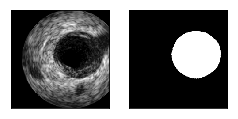

(5, 224, 224, 1) (5, 224, 224, 1)


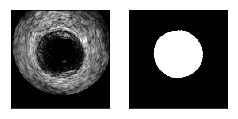

(5, 224, 224, 1) (5, 224, 224, 1)


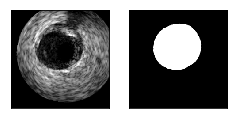

(5, 224, 224, 1) (5, 224, 224, 1)


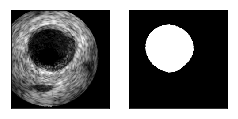

(2, 224, 224, 1) (2, 224, 224, 1)


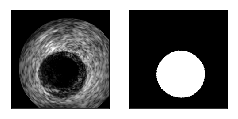

(5, 224, 224, 1) (5, 224, 224, 1)


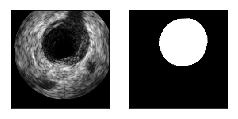

(5, 224, 224, 1) (5, 224, 224, 1)


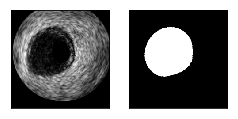

(5, 224, 224, 1) (5, 224, 224, 1)


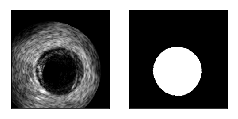

(5, 224, 224, 1) (5, 224, 224, 1)


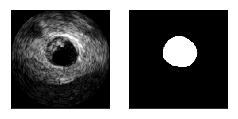

(2, 224, 224, 1) (2, 224, 224, 1)


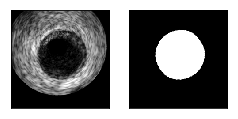

(5, 224, 224, 1) (5, 224, 224, 1)


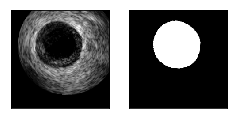

(5, 224, 224, 1) (5, 224, 224, 1)


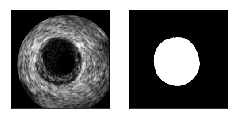

(5, 224, 224, 1) (5, 224, 224, 1)


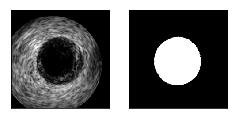

(5, 224, 224, 1) (5, 224, 224, 1)


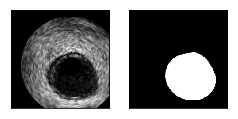

(2, 224, 224, 1) (2, 224, 224, 1)


KeyboardInterrupt: 

In [15]:
for x,y in zip(X_val2_flow, y_val_media_flow):
    # create a grid of 3x3 images
#     print(X_batch[i][:,:,0].shape)
    print(x.shape, y.shape)
#     for i in range(0, 9):
    plt.subplot(1,3,1)
    plt.imshow(x[0,:,:,0], cmap=plt.get_cmap('gray'))
    plt.xticks([])
    plt.yticks([])

    plt.subplot(1,3,2)
    plt.imshow(y[0,:,:,0], cmap=plt.get_cmap('gray'))
    plt.xticks([])
    plt.yticks([])
    # show the plot
    plt.show()
#     break



In [11]:
train_lumen_generator = zip(X_data_flow, y_train_lumen_flow)
val_lumen_generator = zip(X_val_flow, y_val_lumen_flow)

In [10]:
train_media_generator = zip(X_data2_flow, y_train_media_flow)
val_media_generator = zip(X_val2_flow, y_val_media_flow)

#### this completes the augmentation

## The Network Itself 

In [11]:
#Define Model
img_height = 224
img_width = 224
img_channels = 1
merge_axis = -1
inputs = Input((img_height, img_width, img_channels))

# Block 1
xC_1 = Conv2D(64, (5, 5), strides=(1, 1), padding='same', name='block1_conv1')(inputs)
xC_1 = PReLU(alpha_constraint=None)(xC_1)
xC_1 = Conv2D(64, (5, 5), strides=(1, 1), padding='same', name='block1_conv2')(xC_1)
xC_1 = PReLU(alpha_constraint=None)(xC_1)
xP_1 = MaxPooling2D((2,2), name='block1_pool')(xC_1)
# f1 = x

# Block 2
xC_2 = Conv2D(128, (5, 5), strides=(1, 1), padding='same', name='block2_conv1')(xP_1)
xC_2 = PReLU(alpha_constraint=None)(xC_2)
xC_2 = Conv2D(128, (5, 5), strides=(1, 1), padding='same', name='block2_conv2')(xC_2)
xC_2 = PReLU(alpha_constraint=None)(xC_2)
xP_2 = MaxPooling2D((2,2), name='block2_pool')(xC_2)
# f2 = x

# Block 3
xC_3 = Conv2D(256, (5, 5), strides=(1, 1), padding='same', name='block3_conv1')(xP_2)
xC_3 = PReLU(alpha_constraint=None)(xC_3)
xC_3 = Conv2D(256, (5, 5), strides=(1, 1), padding='same', name='block3_conv2')(xC_3)
xC_3 = PReLU(alpha_constraint=None)(xC_3)
xC_3 = Conv2D(256, (5, 5), strides=(1, 1), padding='same', name='block3_conv3')(xC_3)
xC_3 = PReLU(alpha_constraint=None)(xC_3)
xP_3 = MaxPooling2D((2,2), name='block3_pool')(xC_3)
# f3 = x

# Block 4
xC_4 = Conv2D(512, (5, 5), strides=(1, 1), padding='same', name='block4_conv1')(xP_3)
xC_4 = PReLU(alpha_constraint=None)(xC_4)
xC_4 = Conv2D(512, (5, 5), strides=(1, 1), padding='same', name='block4_conv2')(xC_4)
xC_4 = PReLU(alpha_constraint=None)(xC_4)
xC_4 = Conv2D(512, (5, 5), strides=(1, 1), padding='same', name='block4_conv3')(xC_4)
xC_4 = PReLU(alpha_constraint=None)(xC_4)
xP_4 = MaxPooling2D((2,2), name='block4_pool')(xC_4)
# f4 = x

# Block 5
xC_5 = Conv2D(512, (5, 5), strides=(1, 1), padding='same', name='block5_conv1')(xP_4)
xC_5 = PReLU(alpha_constraint=None)(xC_5)
xC_5 = Conv2D(512, (5, 5), strides=(1, 1), padding='same', name='block5_conv2')(xC_5)
xC_5 = PReLU(alpha_constraint=None)(xC_5)
xC_5 = Conv2D(512, (5, 5), strides=(1, 1), padding='same', name='block5_conv3')(xC_5)
xC_5 = PReLU(alpha_constraint=None)(xC_5)
xP_5 = MaxPooling2D((2,2), name='block5_pool')(xC_5)
# f5 = x

# x = Flatten(name='flatten')(x)
# x = Dense(4096, activation='relu', name='full_conn1')(x)
# x = Dense(4096, activation='relu', name='full_conn2')(x)
# x = Dense(1000, activation='softmax', name='predictions')(x)

# vgg_model = Model(inputs, x)
# vgg_model.load_weights(PATH)

skips = [xC_1, xC_2, xC_3, xC_4, xC_5]

for layer in skips:
    print(layer)

# Tip of 'U'
xC = Conv2D(512, (5, 5), strides=(1, 1), padding='same', name='tip')(xP_5)
xC = PReLU(alpha_constraint=None)(xC)
xC = BatchNormalization()(xC)
# f6 = o

oC_1 = UpSampling2D((2,2))(xC)
oC_1 = Conv2D(512, (5, 5), strides=(1, 1), padding='same', name='block6_conv1')(oC_1)
oC_1 = PReLU(alpha_constraint=None)(oC_1)
oC_1 = Conv2D(512, (5, 5), strides=(1, 1), padding='same', name='block6_conv2')(oC_1)
oC_1 = PReLU(alpha_constraint=None)(oC_1)
oConn1 = concatenate([oC_1, xC_5], axis=merge_axis)
oC_1 = Conv2D(512, (5, 5), strides=(1, 1), padding='same', name='block6_conv3')(oConn1)
oC_1 = PReLU(alpha_constraint=None)(oC_1)
oC_1 = BatchNormalization()(oC_1)

oC_2 = UpSampling2D((2,2))(oC_1)
oC_2 = Conv2D(512, (5, 5), strides=(1, 1), padding='same', name='block7_conv1')(oC_2)
oC_2 = PReLU(alpha_constraint=None)(oC_2)
oC_2 = Conv2D(512, (5, 5), strides=(1, 1), padding='same', name='block7_conv2')(oC_2)
oC_2 = PReLU(alpha_constraint=None)(oC_2)
oConn2 = concatenate([oC_2, xC_4], axis=merge_axis)
oC_2 = Conv2D(512, (5, 5), strides=(1, 1), padding='same', name='block7_conv3')(oConn2)
oC_2 = PReLU(alpha_constraint=None)(oC_2)
oC_2 = BatchNormalization()(oC_2)

oC_3 = UpSampling2D((2,2))(oC_2)
oC_3 = Conv2D(256, (5, 5), strides=(1, 1), padding='same', name='block8_conv1')(oC_3)
oC_3 = PReLU(alpha_constraint=None)(oC_3)
oC_3 = Conv2D(256, (5, 5), strides=(1, 1), padding='same', name='block8_conv2')(oC_3)
oC_3 = PReLU(alpha_constraint=None)(oC_3)
oConn3 = concatenate([oC_3, xC_3], axis=merge_axis)
oC_3 = Conv2D(256, (5, 5), strides=(1, 1), padding='same', name='block8_conv3')(oConn3)
oC_3 = PReLU(alpha_constraint=None)(oC_3)
oC_3 = BatchNormalization()(oC_3)

oC_4 = UpSampling2D((2,2))(oC_3)
oC_4 = Conv2D(128, (5, 5), strides=(1, 1), padding='same', name='block9_conv1')(oC_4)
oC_4 = PReLU(alpha_constraint=None)(oC_4)
oC_4 = Conv2D(128, (5, 5), strides=(1, 1), padding='same', name='block9_conv2')(oC_4)
oC_4 = PReLU(alpha_constraint=None)(oC_4)
oConn4 = concatenate([oC_4, xC_2], axis=merge_axis)
oC_4 = Conv2D(128, (5, 5), strides=(1, 1), padding='same', name='block9_conv3')(oConn4)
oC_4 = PReLU(alpha_constraint=None)(oC_4)
oC_4 = BatchNormalization()(oC_4)

oC_5 = UpSampling2D((2,2))(oC_4)
oC_5 = Conv2D(64, (5, 5), strides=(1, 1), padding='same', name='block10_conv1')(oC_5)
oC_5 = PReLU(alpha_constraint=None)(oC_5)
oC_5 = Conv2D(64, (5, 5), strides=(1, 1), padding='same', name='block10_conv2')(oC_5)
oC_5 = PReLU(alpha_constraint=None)(oC_5)
oConn5 = concatenate([oC_5, xC_1], axis=merge_axis)
oC_5 = Conv2D(64, (5, 5), strides=(1, 1), padding='same', name='block10_conv3')(oConn5)
oC_5 = PReLU(alpha_constraint=None)(oC_5)
oC_5 = BatchNormalization()(oC_5)

conv_layer11 = Conv2D(1, (5, 5), activation='sigmoid', padding='same')(oC_5)

final_output = conv_layer11

model = Model(inputs=[inputs], outputs=[final_output])

# adam = Adam(lr=0.01, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0)
sgd = SGD(lr=0.01, decay=1e-6, momentum=0.9, nesterov=True)

model.compile(optimizer=sgd, loss=diceCoefLoss, metrics=[diceCoef, 'acc'])

model.summary()

Tensor("p_re_lu_2/add:0", shape=(?, 224, 224, 64), dtype=float32)
Tensor("p_re_lu_4/add:0", shape=(?, 112, 112, 128), dtype=float32)
Tensor("p_re_lu_7/add:0", shape=(?, 56, 56, 256), dtype=float32)
Tensor("p_re_lu_10/add:0", shape=(?, 28, 28, 512), dtype=float32)
Tensor("p_re_lu_13/add:0", shape=(?, 14, 14, 512), dtype=float32)
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 224, 224, 1)  0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 224, 224, 64) 1664        input_1[0][0]                    
__________________________________________________________________________________________________
p_re_lu_1 (PReLU)               (None, 224, 224, 64) 3211264     block1_conv

In [1]:
# Checkpoint
model_checkpoint = ModelCheckpoint('unet-ivus-3-sgd-media.hdf5', verbose=1, save_best_only=True)

# TensorBoard visualization
tensor_board = TensorBoard(log_dir='./unet-logs-3-media', histogram_freq=0, batch_size=4, write_graph=True, write_grads=False,
                           write_images=True)

# Reduce learning rate if no improvment
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=20, verbose=0, 
                              mode='auto', cooldown=0,  min_lr=0)

model.fit_generator(train_media_generator,
                    steps_per_epoch=len(X_train_data2),
                    epochs=100,
                    validation_data=val_media_generator,
                    validation_steps=len(X_val_data2),
                    shuffle=True,
                    callbacks=[model_checkpoint, tensor_board, reduce_lr]
                    )

## Let's see how lumen looks after data augmentation (SGD Lumen 100 Epochs)

dict_keys(['loss', 'lr', 'val_diceCoef', 'diceCoef', 'val_acc', 'acc', 'val_loss'])


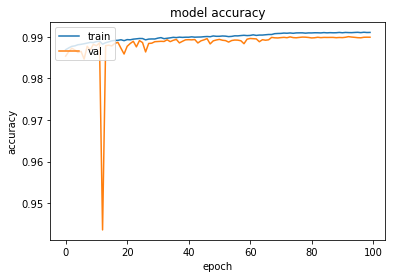

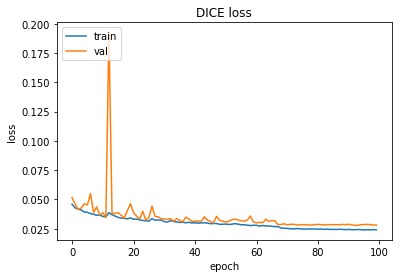

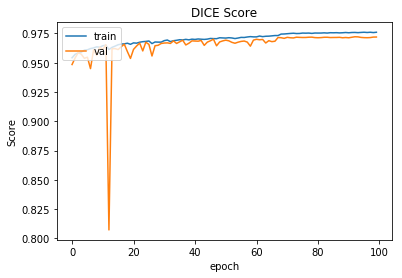

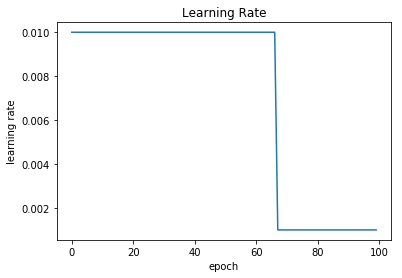

In [27]:
aug_unet_vgg = model.history

print(aug_unet_vgg.history.keys())
# print(aug_unet_vgg.history.keys)

plt.plot(aug_unet_vgg.history['acc'])
plt.plot(aug_unet_vgg.history['val_acc'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(aug_unet_vgg.history['loss'])
plt.plot(aug_unet_vgg.history['val_loss'])
plt.title('DICE loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

#summarize dice score
plt.plot(aug_unet_vgg.history['diceCoef'])
plt.plot(aug_unet_vgg.history['val_diceCoef'])
plt.title('DICE Score')
plt.ylabel('Score')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

# Summarize learning rate
plt.plot(aug_unet_vgg.history['lr'])
plt.title('Learning Rate')
plt.ylabel('learning rate')
plt.xlabel('epoch')
plt.show()

## Lets test the model SGD Lumen 100 Epochs

In [7]:
mymodel = load_model('lumen_models/unet-ivus-3-sgd-lumen.hdf5', custom_objects={'diceCoefLoss':diceCoefLoss, 'diceCoef':diceCoef})

test_path = "D:\Chirag B\ComputerVision\IVUSProject\IVUS_DATA\Test Set\Test Set\DCM"
all_test_files = os.listdir(test_path)
test_label = "D:\Chirag B\ComputerVision\IVUSProject\Computing Jacc\Computing Jacc"


all_test_files
len(all_test_files)
image_rows = 384
image_cols = 384

all_test_data = np.ndarray((len(all_test_files) ,image_rows, image_cols), dtype=np.uint8)

# all_test_data.shape

x = 0
for test_img in all_test_files:
    im = imread(os.path.join(test_path, test_img), as_grey=True)
    all_test_data[x] = np.array([im])
    x += 1

# Load all labels
all_test_lumen_labels = scipy.io.loadmat(os.path.join(test_label, 'lumen_labels_test.mat'))
all_test_media_labels = scipy.io.loadmat(os.path.join(test_label, 'media_labels_test.mat'))


all_test_lumen_labels = np.array(all_test_lumen_labels['lumen_labels_test'])
all_test_media_labels = np.array(all_test_media_labels['media_labels_test'])



# We have all test data    
all_test_data = all_test_data[..., np.newaxis]


# resize all test images and labels
all_test_data = resizeData(all_test_data)
all_test_lumen_labels = resizeData(all_test_lumen_labels)


all_test_data.shape


C:\Users\chira\Anaconda2\envs\tensorflow\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


(326, 224, 224, 1)
(326, 224, 224, 1)


(326, 224, 224, 1)

In [8]:
x = time.time()
unet_preds3 = mymodel.predict(all_test_data, batch_size=9, verbose=1)
x2 = time.time()
print("Time taken in seconds: {0}s ".format(x2-x))

326/326 [==============================] - 33s 100ms/step
Time taken in seconds: 32.703752517700195s 




0
The intersection area is 2141
The     union    area is 2378
Calculated Jaccard Measure is 0.900336417157275
DICE Coefficient :  0.9475547687541491


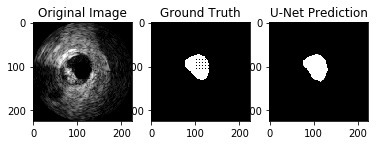





1
The intersection area is 2168
The     union    area is 2355
Calculated Jaccard Measure is 0.9205944798301486
DICE Coefficient :  0.9586557594516913


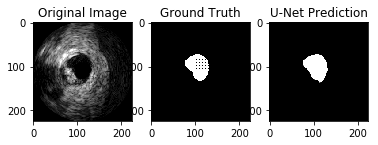





2
The intersection area is 1964
The     union    area is 2181
Calculated Jaccard Measure is 0.9005043558000917
DICE Coefficient :  0.9476477683956575


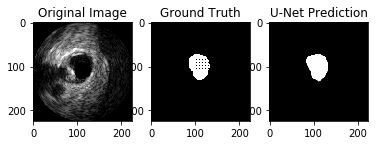





3
The intersection area is 1846
The     union    area is 2290
Calculated Jaccard Measure is 0.8061135371179039
DICE Coefficient :  0.8926499032882012


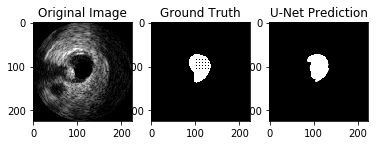





4
The intersection area is 1950
The     union    area is 2163
Calculated Jaccard Measure is 0.9015256588072122
DICE Coefficient :  0.9482129832239241


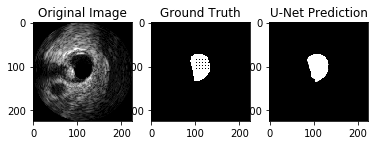





5
The intersection area is 1687
The     union    area is 2096
Calculated Jaccard Measure is 0.8048664122137404
DICE Coefficient :  0.8918847475548507


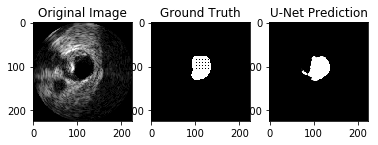





6
The intersection area is 1835
The     union    area is 2118
Calculated Jaccard Measure is 0.8663833805476865
DICE Coefficient :  0.928408803440425


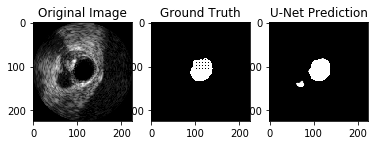





7
The intersection area is 1659
The     union    area is 2199
Calculated Jaccard Measure is 0.7544338335607094
DICE Coefficient :  0.8600311041990669


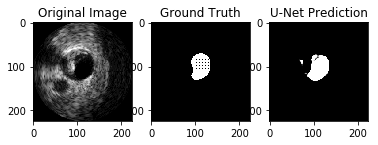





8
The intersection area is 1525
The     union    area is 2230
Calculated Jaccard Measure is 0.6838565022421524
DICE Coefficient :  0.8122503328894807


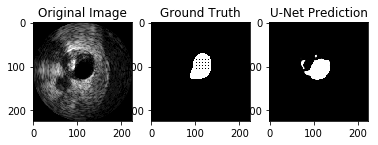





9
The intersection area is 1798
The     union    area is 2259
Calculated Jaccard Measure is 0.7959274015050908
DICE Coefficient :  0.8863692383534632


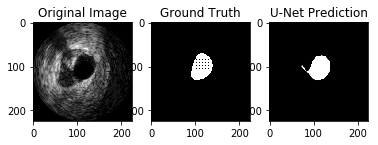





10
The intersection area is 1913
The     union    area is 2546
Calculated Jaccard Measure is 0.7513747054202671
DICE Coefficient :  0.858039919264409


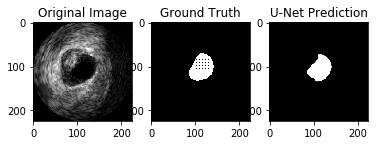





11
The intersection area is 2417
The     union    area is 2979
Calculated Jaccard Measure is 0.8113460892917086
DICE Coefficient :  0.8958487768717569


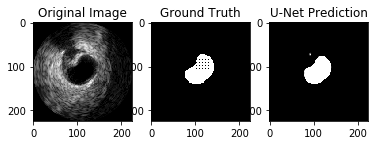





12
The intersection area is 2438
The     union    area is 2805
Calculated Jaccard Measure is 0.8691622103386809
DICE Coefficient :  0.9300019073049781


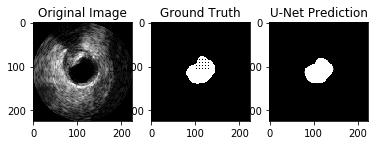





13
The intersection area is 2469
The     union    area is 2910
Calculated Jaccard Measure is 0.8484536082474227
DICE Coefficient :  0.9180145008365868


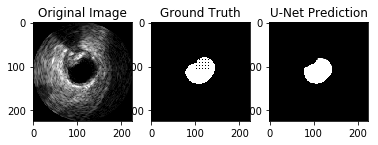





14
The intersection area is 2831
The     union    area is 3192
Calculated Jaccard Measure is 0.8869047619047619
DICE Coefficient :  0.9400630914826499


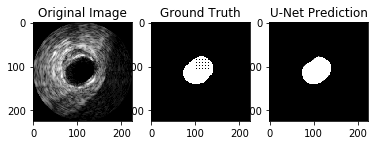





15
The intersection area is 2593
The     union    area is 3004
Calculated Jaccard Measure is 0.8631824234354194
DICE Coefficient :  0.9265678041808112


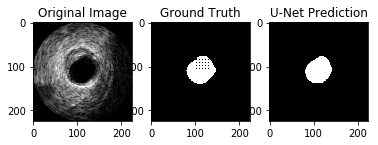





16
The intersection area is 2772
The     union    area is 3151
Calculated Jaccard Measure is 0.8797207235798159
DICE Coefficient :  0.936012156002026


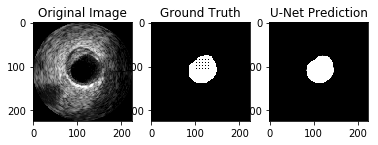





17
The intersection area is 2903
The     union    area is 3269
Calculated Jaccard Measure is 0.8880391557051086
DICE Coefficient :  0.940699935191186


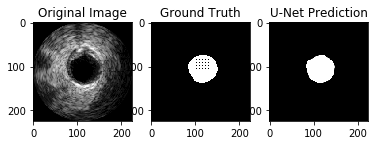





18
The intersection area is 3035
The     union    area is 3368
Calculated Jaccard Measure is 0.9011282660332541
DICE Coefficient :  0.9479931282211463


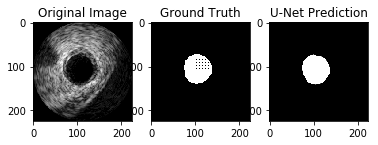





19
The intersection area is 2767
The     union    area is 3335
Calculated Jaccard Measure is 0.8296851574212893
DICE Coefficient :  0.906915765322845


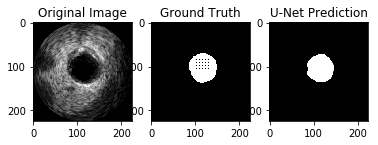





20
The intersection area is 2844
The     union    area is 3162
Calculated Jaccard Measure is 0.8994307400379506
DICE Coefficient :  0.9470529470529471


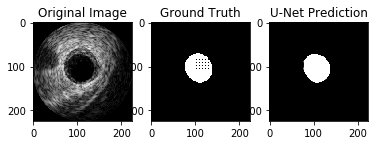





21
The intersection area is 2740
The     union    area is 3189
Calculated Jaccard Measure is 0.85920351207275
DICE Coefficient :  0.9242705346601451


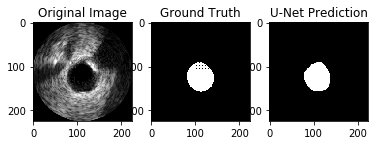





22
The intersection area is 2821
The     union    area is 3189
Calculated Jaccard Measure is 0.8846033239259956
DICE Coefficient :  0.9387687188019966


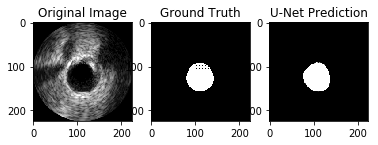





23
The intersection area is 2819
The     union    area is 3270
Calculated Jaccard Measure is 0.8620795107033639
DICE Coefficient :  0.9259320085399901


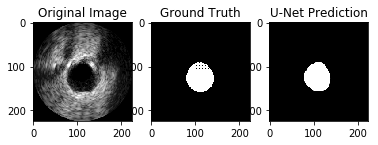





24
The intersection area is 2877
The     union    area is 3271
Calculated Jaccard Measure is 0.8795475389789056
DICE Coefficient :  0.9359141184124918


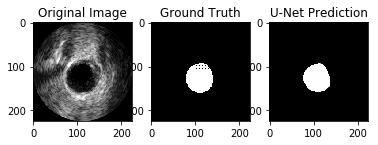





25
The intersection area is 2659
The     union    area is 3059
Calculated Jaccard Measure is 0.8692383131742399
DICE Coefficient :  0.9300454704442113


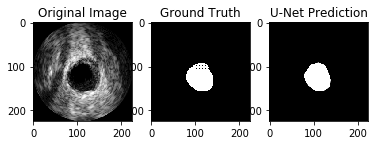





26
The intersection area is 2662
The     union    area is 3134
Calculated Jaccard Measure is 0.8493937460114869
DICE Coefficient :  0.9185645272601795


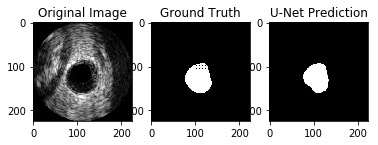





27
The intersection area is 2641
The     union    area is 3518
Calculated Jaccard Measure is 0.7507106310403638
DICE Coefficient :  0.8576067543432375


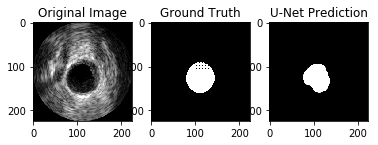





28
The intersection area is 3007
The     union    area is 3623
Calculated Jaccard Measure is 0.8299751587082528
DICE Coefficient :  0.9070889894419306


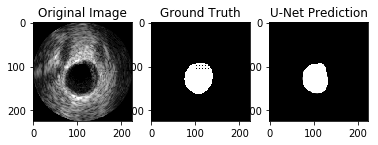





29
The intersection area is 2861
The     union    area is 3626
Calculated Jaccard Measure is 0.7890237175951461
DICE Coefficient :  0.8820718359796517


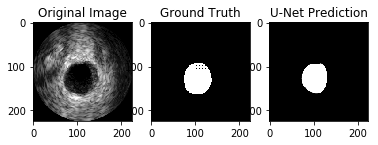





30
The intersection area is 3202
The     union    area is 3625
Calculated Jaccard Measure is 0.8833103448275862
DICE Coefficient :  0.938040134759045


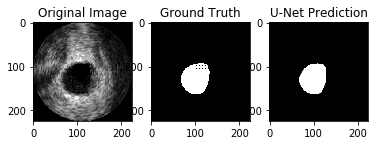





31
The intersection area is 3248
The     union    area is 3764
Calculated Jaccard Measure is 0.8629117959617428
DICE Coefficient :  0.9264118653736452


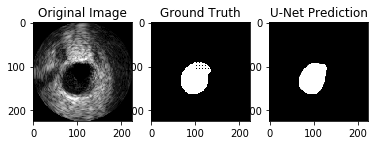





32
The intersection area is 3542
The     union    area is 4069
Calculated Jaccard Measure is 0.87048414843942
DICE Coefficient :  0.9307581132571279


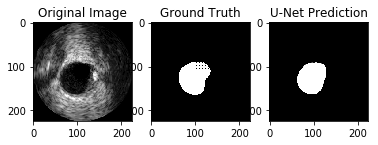





33
The intersection area is 3370
The     union    area is 3961
Calculated Jaccard Measure is 0.8507952537238072
DICE Coefficient :  0.9193834401855135


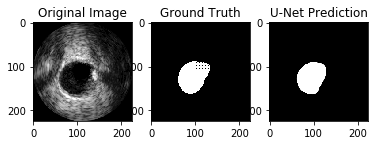





34
The intersection area is 3598
The     union    area is 4069
Calculated Jaccard Measure is 0.8842467436716638
DICE Coefficient :  0.9385678883526803


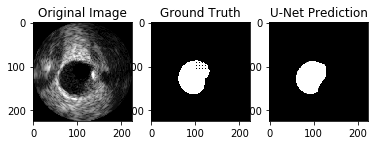





35
The intersection area is 3417
The     union    area is 4041
Calculated Jaccard Measure is 0.8455827765404603
DICE Coefficient :  0.916331456154465


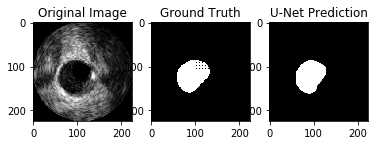





36
The intersection area is 3279
The     union    area is 4047
Calculated Jaccard Measure is 0.810229799851742
DICE Coefficient :  0.8951678951678952


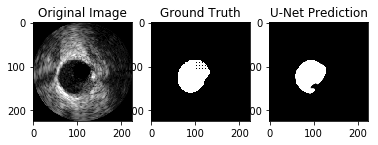





37
The intersection area is 2878
The     union    area is 3710
Calculated Jaccard Measure is 0.7757412398921832
DICE Coefficient :  0.8737097753491196


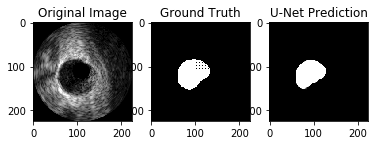





38
The intersection area is 3132
The     union    area is 4066
Calculated Jaccard Measure is 0.7702902115100836
DICE Coefficient :  0.8702417338149486


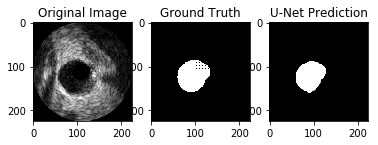





39
The intersection area is 2604
The     union    area is 3648
Calculated Jaccard Measure is 0.7138157894736842
DICE Coefficient :  0.8330134357005758


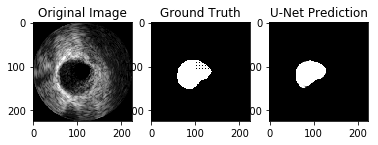





40
The intersection area is 2368
The     union    area is 3234
Calculated Jaccard Measure is 0.7322201607915894
DICE Coefficient :  0.8454123527311674


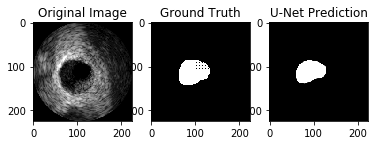





41
The intersection area is 2252
The     union    area is 2976
Calculated Jaccard Measure is 0.7567204301075269
DICE Coefficient :  0.8615149196633511


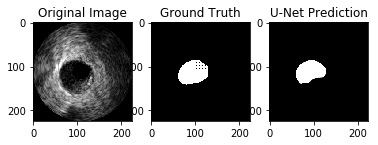





42
The intersection area is 2041
The     union    area is 2993
Calculated Jaccard Measure is 0.6819244904777815
DICE Coefficient :  0.810885975367501


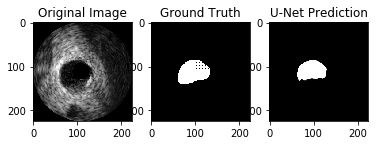





43
The intersection area is 2122
The     union    area is 2871
Calculated Jaccard Measure is 0.7391152908394287
DICE Coefficient :  0.8499899859803726


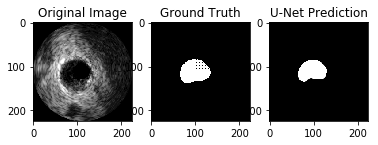





44
The intersection area is 2078
The     union    area is 2585
Calculated Jaccard Measure is 0.8038684719535784
DICE Coefficient :  0.8912717134891701


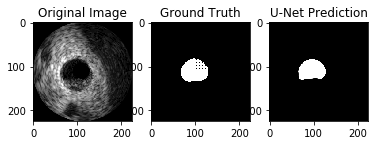





45
The intersection area is 2025
The     union    area is 2415
Calculated Jaccard Measure is 0.8385093167701864
DICE Coefficient :  0.9121621621621622


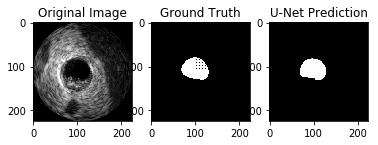





46
The intersection area is 2038
The     union    area is 2301
Calculated Jaccard Measure is 0.8857018687527162
DICE Coefficient :  0.939386955519705


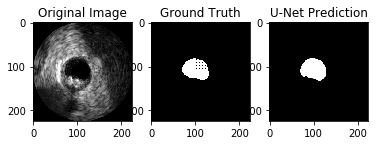





47
The intersection area is 2036
The     union    area is 2246
Calculated Jaccard Measure is 0.9065004452359751
DICE Coefficient :  0.950957496496964


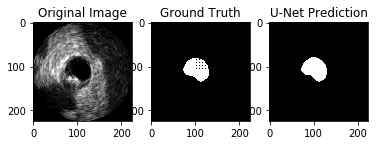





48
The intersection area is 1874
The     union    area is 2345
Calculated Jaccard Measure is 0.7991471215351812
DICE Coefficient :  0.8883621711305997


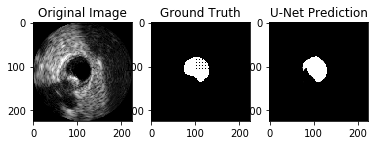





49
The intersection area is 1864
The     union    area is 2280
Calculated Jaccard Measure is 0.8175438596491228
DICE Coefficient :  0.8996138996138996


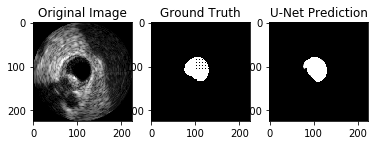





50
The intersection area is 1938
The     union    area is 2155
Calculated Jaccard Measure is 0.8993039443155453
DICE Coefficient :  0.9469826533105302


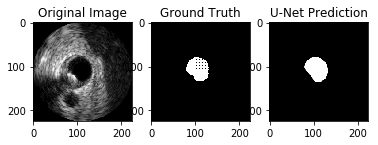





51
The intersection area is 1838
The     union    area is 2225
Calculated Jaccard Measure is 0.826067415730337
DICE Coefficient :  0.9047501845926655


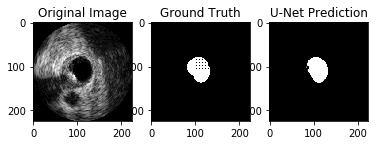





52
The intersection area is 1980
The     union    area is 2256
Calculated Jaccard Measure is 0.8776595744680851
DICE Coefficient :  0.9348441926345609


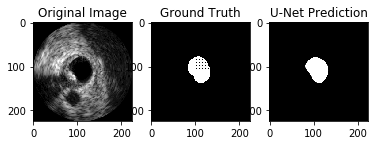





53
The intersection area is 1873
The     union    area is 2259
Calculated Jaccard Measure is 0.8291279327135901
DICE Coefficient :  0.9065827686350436


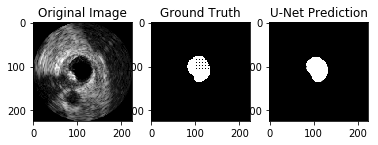





54
The intersection area is 1831
The     union    area is 2194
Calculated Jaccard Measure is 0.8345487693710119
DICE Coefficient :  0.9098136645962733


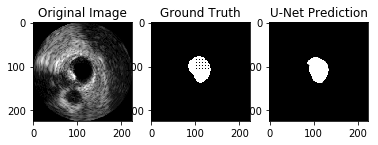





55
The intersection area is 1890
The     union    area is 2350
Calculated Jaccard Measure is 0.8042553191489362
DICE Coefficient :  0.8915094339622641


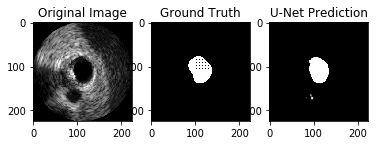





56
The intersection area is 1810
The     union    area is 2292
Calculated Jaccard Measure is 0.7897033158813264
DICE Coefficient :  0.8824963432471965


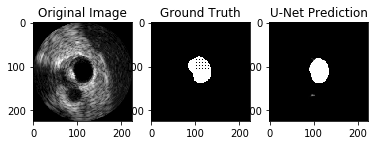





57
The intersection area is 1784
The     union    area is 2296
Calculated Jaccard Measure is 0.7770034843205574
DICE Coefficient :  0.8745098039215686


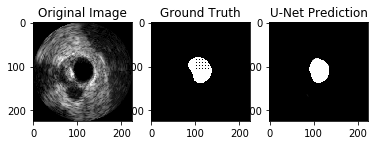





58
The intersection area is 1846
The     union    area is 2283
Calculated Jaccard Measure is 0.8085851949189663
DICE Coefficient :  0.8941632356502786


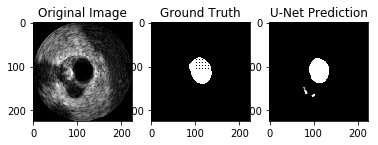





59
The intersection area is 1986
The     union    area is 2613
Calculated Jaccard Measure is 0.7600459242250287
DICE Coefficient :  0.8636660143509458


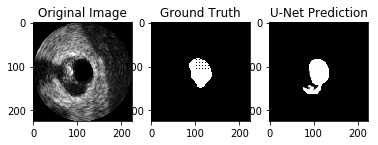





60
The intersection area is 1972
The     union    area is 2829
Calculated Jaccard Measure is 0.6970661010957936
DICE Coefficient :  0.8214955217662987


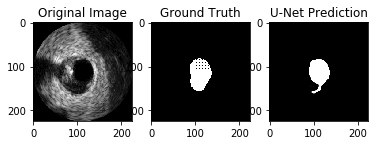





61
The intersection area is 2128
The     union    area is 2742
Calculated Jaccard Measure is 0.7760758570386579
DICE Coefficient :  0.8739219712525668


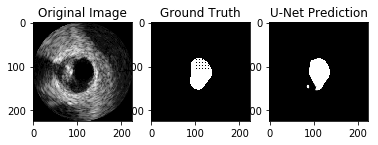





62
The intersection area is 1931
The     union    area is 2914
Calculated Jaccard Measure is 0.6626630061770762
DICE Coefficient :  0.7971104231166151


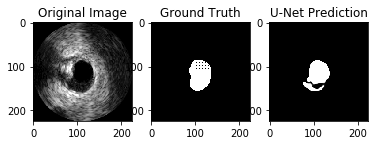





63
The intersection area is 2596
The     union    area is 2979
Calculated Jaccard Measure is 0.8714333669016449
DICE Coefficient :  0.9313004484304933


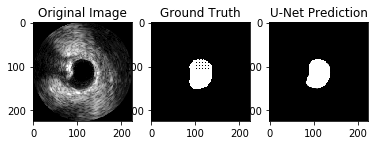





64
The intersection area is 2314
The     union    area is 3114
Calculated Jaccard Measure is 0.7430956968529223
DICE Coefficient :  0.8526160648489315


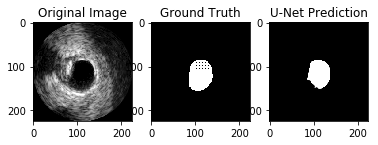





65
The intersection area is 2708
The     union    area is 3224
Calculated Jaccard Measure is 0.8399503722084367
DICE Coefficient :  0.9130141604855023


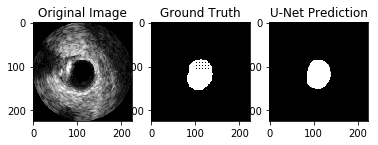





66
The intersection area is 2625
The     union    area is 3192
Calculated Jaccard Measure is 0.8223684210526315
DICE Coefficient :  0.9025270758122743


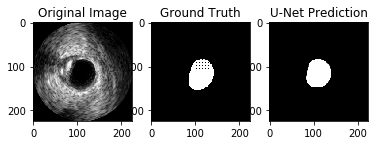





67
The intersection area is 2772
The     union    area is 3387
Calculated Jaccard Measure is 0.8184233835252436
DICE Coefficient :  0.9001461276181199


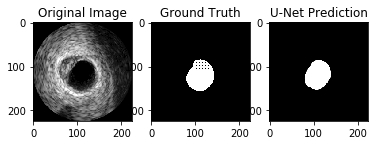





68
The intersection area is 2911
The     union    area is 3426
Calculated Jaccard Measure is 0.8496789258610624
DICE Coefficient :  0.9187312608489822


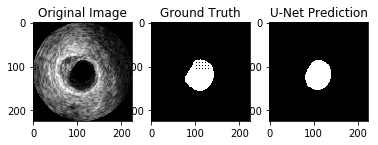





69
The intersection area is 2946
The     union    area is 3517
Calculated Jaccard Measure is 0.8376457207847597
DICE Coefficient :  0.9116509360977874


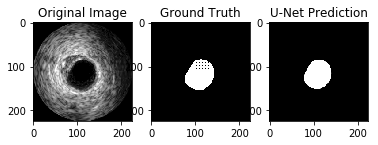





70
The intersection area is 2793
The     union    area is 3283
Calculated Jaccard Measure is 0.8507462686567164
DICE Coefficient :  0.9193548387096774


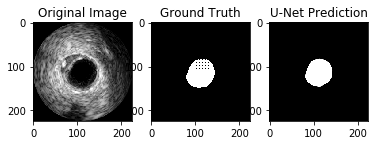





71
The intersection area is 4879
The     union    area is 5957
Calculated Jaccard Measure is 0.8190364277320799
DICE Coefficient :  0.900516795865633


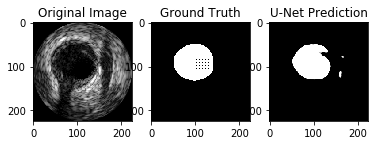





72
The intersection area is 5291
The     union    area is 5907
Calculated Jaccard Measure is 0.8957169459962756
DICE Coefficient :  0.9449901768172888


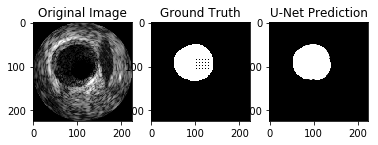





73
The intersection area is 5293
The     union    area is 5820
Calculated Jaccard Measure is 0.9094501718213058
DICE Coefficient :  0.952578061729506


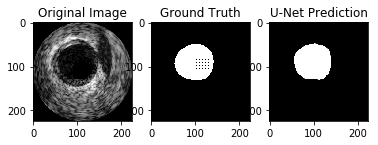





74
The intersection area is 5377
The     union    area is 5834
Calculated Jaccard Measure is 0.9216660953033939
DICE Coefficient :  0.9592364641869592


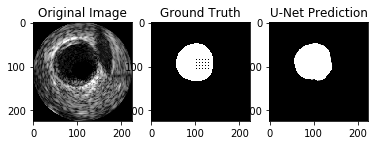





75
The intersection area is 5106
The     union    area is 5680
Calculated Jaccard Measure is 0.898943661971831
DICE Coefficient :  0.9467828666790283


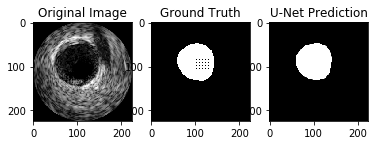





76
The intersection area is 4756
The     union    area is 5325
Calculated Jaccard Measure is 0.8931455399061032
DICE Coefficient :  0.943557186787025


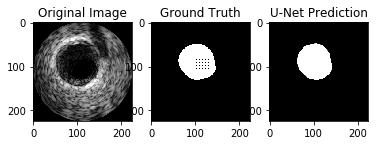





77
The intersection area is 4381
The     union    area is 5292
Calculated Jaccard Measure is 0.8278533635676493
DICE Coefficient :  0.9058203246149075


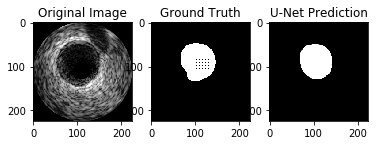





78
The intersection area is 4169
The     union    area is 5002
Calculated Jaccard Measure is 0.8334666133546581
DICE Coefficient :  0.909170210445971


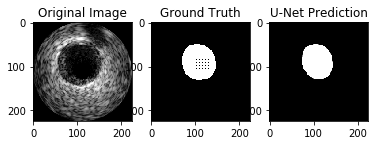





79
The intersection area is 4242
The     union    area is 5027
Calculated Jaccard Measure is 0.843843246469067
DICE Coefficient :  0.9153090948322364


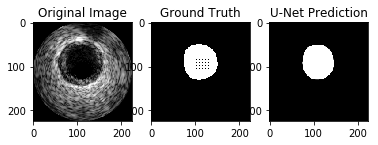





80
The intersection area is 4386
The     union    area is 4970
Calculated Jaccard Measure is 0.8824949698189135
DICE Coefficient :  0.9375801624625909


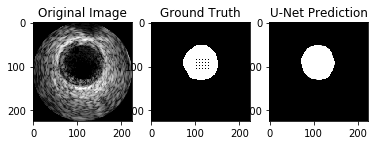





81
The intersection area is 4460
The     union    area is 5353
Calculated Jaccard Measure is 0.8331776573883803
DICE Coefficient :  0.9089982676041986


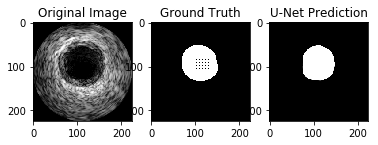





82
The intersection area is 4913
The     union    area is 5643
Calculated Jaccard Measure is 0.8706361864256601
DICE Coefficient :  0.9308450170519136


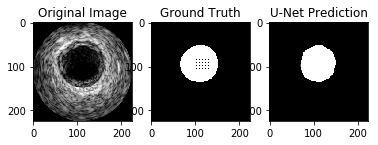





83
The intersection area is 5176
The     union    area is 5781
Calculated Jaccard Measure is 0.8953468258086836
DICE Coefficient :  0.944784156247148


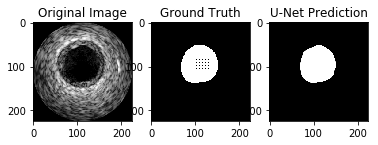





84
The intersection area is 5569
The     union    area is 6208
Calculated Jaccard Measure is 0.8970682989690721
DICE Coefficient :  0.9457416999235798


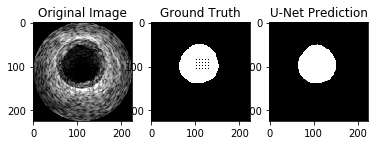





85
The intersection area is 5944
The     union    area is 6921
Calculated Jaccard Measure is 0.8588354284062997
DICE Coefficient :  0.9240575204041974


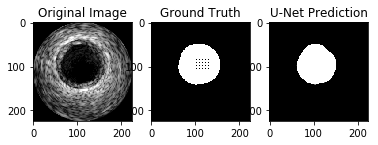





86
The intersection area is 5959
The     union    area is 6418
Calculated Jaccard Measure is 0.9284823932689311
DICE Coefficient :  0.9629150844307991


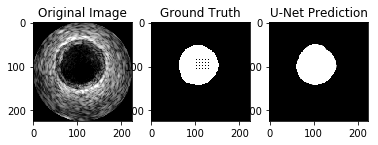





87
The intersection area is 5990
The     union    area is 6634
Calculated Jaccard Measure is 0.9029243292131444
DICE Coefficient :  0.9489860583016476


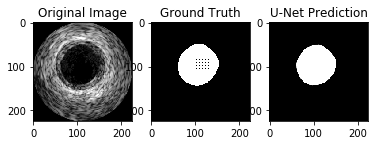





88
The intersection area is 6026
The     union    area is 6649
Calculated Jaccard Measure is 0.9063016995036848
DICE Coefficient :  0.9508481262327416


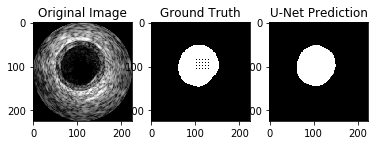





89
The intersection area is 5638
The     union    area is 6538
Calculated Jaccard Measure is 0.8623432242275926
DICE Coefficient :  0.926084099868594


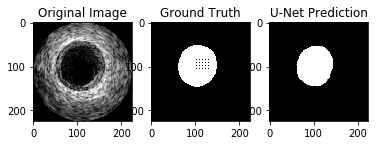





90
The intersection area is 5627
The     union    area is 6201
Calculated Jaccard Measure is 0.9074342847927753
DICE Coefficient :  0.9514710855596888


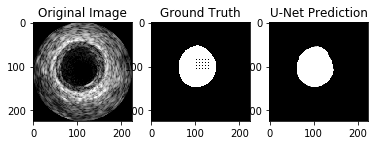





91
The intersection area is 5184
The     union    area is 5783
Calculated Jaccard Measure is 0.8964205429707764
DICE Coefficient :  0.945381599343485


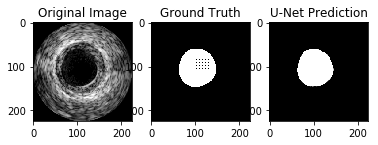





92
The intersection area is 5024
The     union    area is 5677
Calculated Jaccard Measure is 0.8849744583406729
DICE Coefficient :  0.9389776656387253


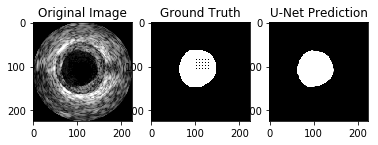





93
The intersection area is 4926
The     union    area is 5482
Calculated Jaccard Measure is 0.8985771616198468
DICE Coefficient :  0.9465795541890853


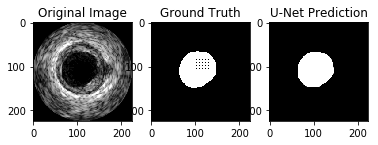





94
The intersection area is 4768
The     union    area is 5395
Calculated Jaccard Measure is 0.8837812789620019
DICE Coefficient :  0.9383056184197579


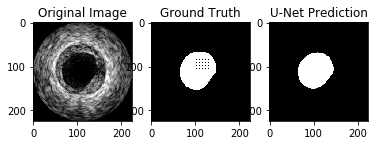





95
The intersection area is 4324
The     union    area is 5229
Calculated Jaccard Measure is 0.826926754637598
DICE Coefficient :  0.9052653616664922


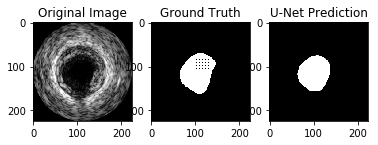





96
The intersection area is 4198
The     union    area is 4540
Calculated Jaccard Measure is 0.9246696035242291
DICE Coefficient :  0.9608606088349737


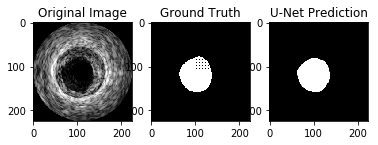





97
The intersection area is 4338
The     union    area is 5147
Calculated Jaccard Measure is 0.8428210608121236
DICE Coefficient :  0.9147074327886136


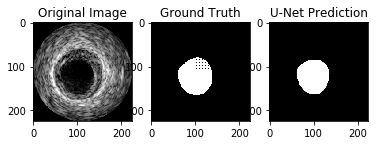





98
The intersection area is 4559
The     union    area is 5341
Calculated Jaccard Measure is 0.853585470885602
DICE Coefficient :  0.9210101010101011


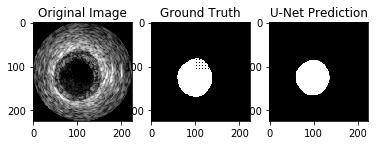





99
The intersection area is 4411
The     union    area is 5369
Calculated Jaccard Measure is 0.8215682622462284
DICE Coefficient :  0.9020449897750511


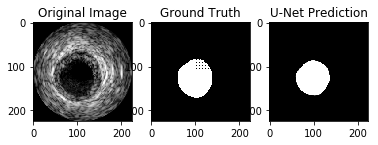





100
The intersection area is 4507
The     union    area is 5289
Calculated Jaccard Measure is 0.8521459633200983
DICE Coefficient :  0.9201714985708452


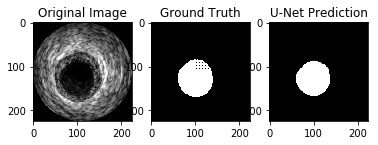





101
The intersection area is 4373
The     union    area is 5159
Calculated Jaccard Measure is 0.8476448924210118
DICE Coefficient :  0.9175409148132606


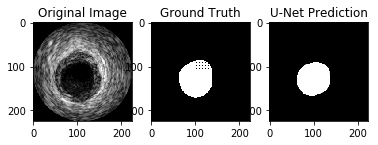





102
The intersection area is 4540
The     union    area is 5313
Calculated Jaccard Measure is 0.8545078110295502
DICE Coefficient :  0.9215467370344058


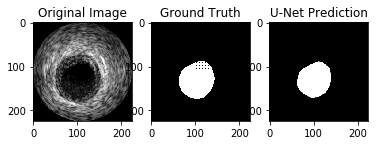





103
The intersection area is 4053
The     union    area is 5442
Calculated Jaccard Measure is 0.7447629547960308
DICE Coefficient :  0.8537124802527646


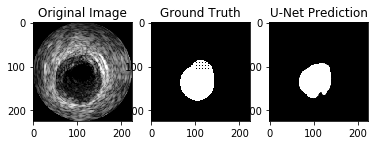





104
The intersection area is 4016
The     union    area is 4700
Calculated Jaccard Measure is 0.854468085106383
DICE Coefficient :  0.9215236346948141


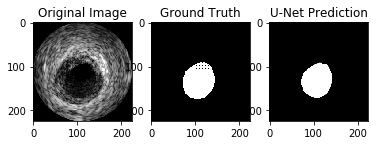





105
The intersection area is 3403
The     union    area is 4120
Calculated Jaccard Measure is 0.8259708737864078
DICE Coefficient :  0.9046922770171474


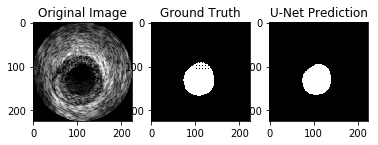





106
The intersection area is 3379
The     union    area is 3950
Calculated Jaccard Measure is 0.8554430379746836
DICE Coefficient :  0.9220903261017874


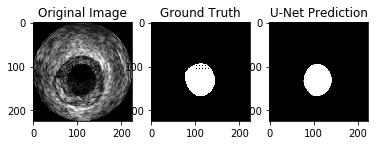





107
The intersection area is 3789
The     union    area is 4642
Calculated Jaccard Measure is 0.8162429987074536
DICE Coefficient :  0.8988257620685565


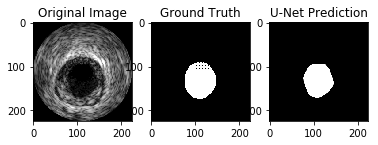





108
The intersection area is 4030
The     union    area is 4844
Calculated Jaccard Measure is 0.8319570602807597
DICE Coefficient :  0.908271354518819


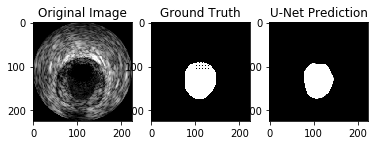





109
The intersection area is 4285
The     union    area is 5761
Calculated Jaccard Measure is 0.7437944801249783
DICE Coefficient :  0.8530758510850089


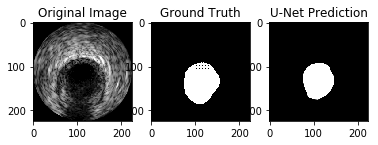





110
The intersection area is 5026
The     union    area is 7004
Calculated Jaccard Measure is 0.7175899486007995
DICE Coefficient :  0.8355777223607648


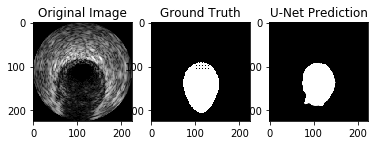





111
The intersection area is 5922
The     union    area is 7414
Calculated Jaccard Measure is 0.7987591043970866
DICE Coefficient :  0.888122375524895


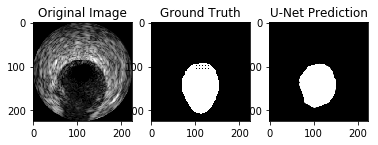





112
The intersection area is 6083
The     union    area is 7289
Calculated Jaccard Measure is 0.8345452051035808
DICE Coefficient :  0.9098115465151062


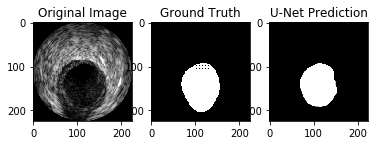





113
The intersection area is 5862
The     union    area is 6927
Calculated Jaccard Measure is 0.8462537895192724
DICE Coefficient :  0.9167253108139808


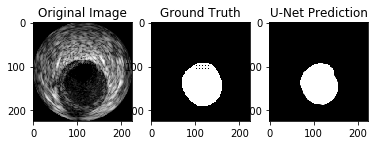





114
The intersection area is 5629
The     union    area is 7008
Calculated Jaccard Measure is 0.8032248858447488
DICE Coefficient :  0.8908759990504075


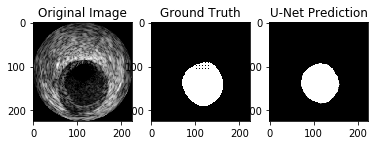





115
The intersection area is 5617
The     union    area is 7105
Calculated Jaccard Measure is 0.790570021111893
DICE Coefficient :  0.8830372582927213


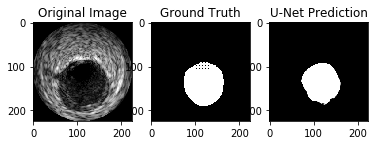





116
The intersection area is 5250
The     union    area is 6658
Calculated Jaccard Measure is 0.7885250826073896
DICE Coefficient :  0.8817601612361438


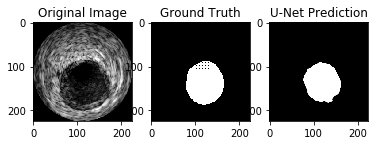





117
The intersection area is 4896
The     union    area is 6694
Calculated Jaccard Measure is 0.7314012548550941
DICE Coefficient :  0.8448662640207075


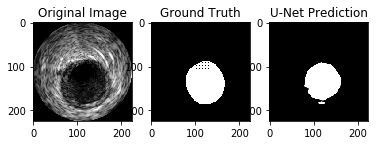





118
The intersection area is 5177
The     union    area is 6858
Calculated Jaccard Measure is 0.7548848060659085
DICE Coefficient :  0.8603240548400498


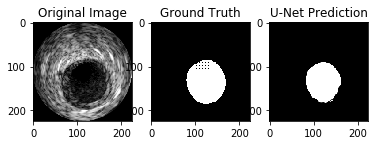





119
The intersection area is 5181
The     union    area is 6885
Calculated Jaccard Measure is 0.7525054466230937
DICE Coefficient :  0.8587767279960219


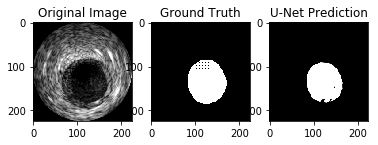





120
The intersection area is 4990
The     union    area is 6926
Calculated Jaccard Measure is 0.720473577822697
DICE Coefficient :  0.8375293722725747


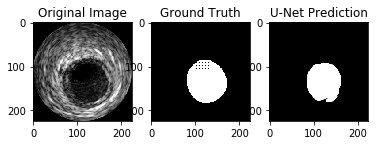





121
The intersection area is 3198
The     union    area is 3593
Calculated Jaccard Measure is 0.8900640133593097
DICE Coefficient :  0.9418347813282285


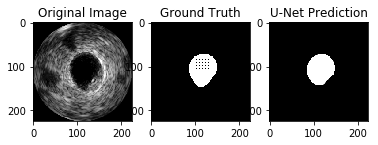





122
The intersection area is 2907
The     union    area is 3326
Calculated Jaccard Measure is 0.8740228502705953
DICE Coefficient :  0.9327771538584951


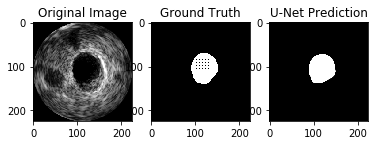





123
The intersection area is 2772
The     union    area is 3287
Calculated Jaccard Measure is 0.8433221782780651
DICE Coefficient :  0.9150024756560489


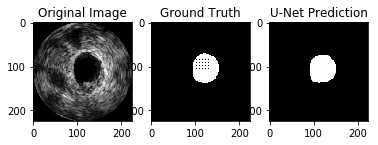





124
The intersection area is 2593
The     union    area is 3121
Calculated Jaccard Measure is 0.8308234540211471
DICE Coefficient :  0.9075953797689884


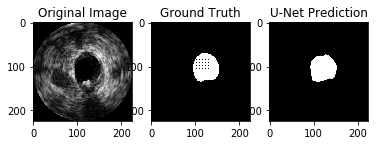





125
The intersection area is 2582
The     union    area is 3076
Calculated Jaccard Measure is 0.8394018205461639
DICE Coefficient :  0.912689996465182


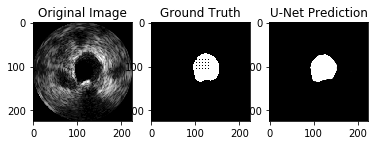





126
The intersection area is 2235
The     union    area is 2966
Calculated Jaccard Measure is 0.75354012137559
DICE Coefficient :  0.8594501057488945


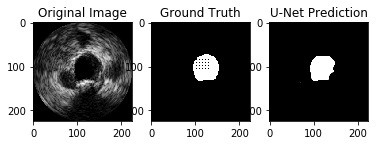





127
The intersection area is 2262
The     union    area is 3064
Calculated Jaccard Measure is 0.7382506527415144
DICE Coefficient :  0.8494179496808111


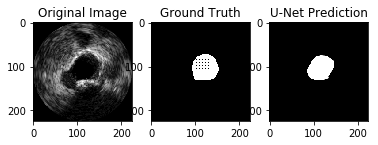





128
The intersection area is 2133
The     union    area is 2613
Calculated Jaccard Measure is 0.8163030998851895
DICE Coefficient :  0.8988621997471555


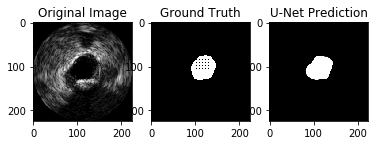





129
The intersection area is 1832
The     union    area is 2198
Calculated Jaccard Measure is 0.8334849863512284
DICE Coefficient :  0.9091811414392059


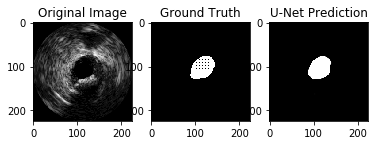





130
The intersection area is 1637
The     union    area is 1823
Calculated Jaccard Measure is 0.897970378496983
DICE Coefficient :  0.946242774566474


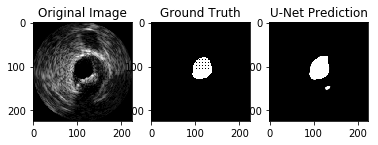





131
The intersection area is 1690
The     union    area is 1905
Calculated Jaccard Measure is 0.8871391076115486
DICE Coefficient :  0.9401947148817803


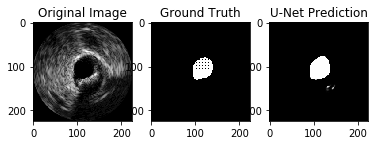





132
The intersection area is 1699
The     union    area is 1923
Calculated Jaccard Measure is 0.8835153406136246
DICE Coefficient :  0.9381557150745444


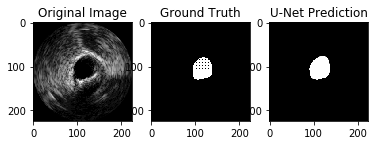





133
The intersection area is 1811
The     union    area is 2037
Calculated Jaccard Measure is 0.8890525282277859
DICE Coefficient :  0.9412681912681913


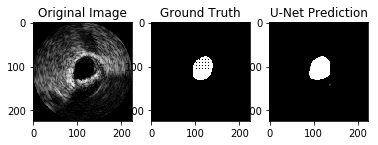





134
The intersection area is 1962
The     union    area is 2288
Calculated Jaccard Measure is 0.8575174825174825
DICE Coefficient :  0.9232941176470588


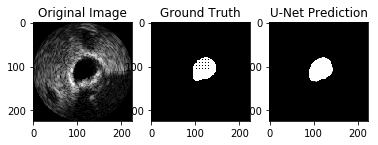





135
The intersection area is 2005
The     union    area is 2327
Calculated Jaccard Measure is 0.8616244091104426
DICE Coefficient :  0.9256694367497692


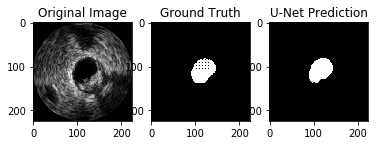





136
The intersection area is 1938
The     union    area is 2239
Calculated Jaccard Measure is 0.8655649843680214
DICE Coefficient :  0.9279387119942543


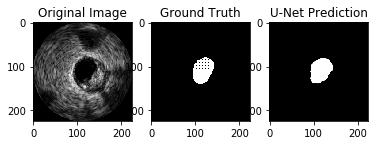





137
The intersection area is 1916
The     union    area is 2346
Calculated Jaccard Measure is 0.8167092924126172
DICE Coefficient :  0.8991083998122947


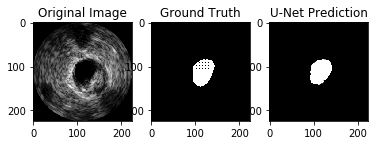





138
The intersection area is 2126
The     union    area is 2406
Calculated Jaccard Measure is 0.8836242726517041
DICE Coefficient :  0.9382171226831421


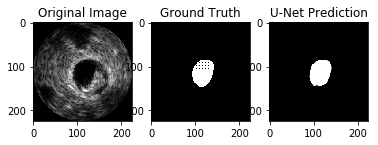





139
The intersection area is 2025
The     union    area is 2362
Calculated Jaccard Measure is 0.857324301439458
DICE Coefficient :  0.9231821290175518


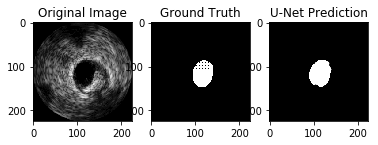





140
The intersection area is 2021
The     union    area is 2309
Calculated Jaccard Measure is 0.8752706799480294
DICE Coefficient :  0.9334872979214781


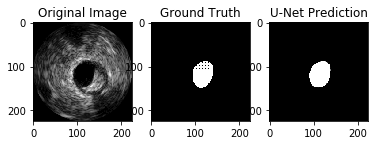





141
The intersection area is 1912
The     union    area is 2182
Calculated Jaccard Measure is 0.8762603116406966
DICE Coefficient :  0.9340498290180752


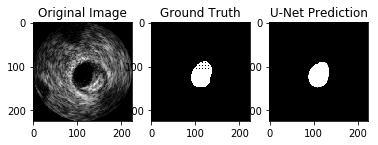





142
The intersection area is 1875
The     union    area is 2248
Calculated Jaccard Measure is 0.8340747330960854
DICE Coefficient :  0.9095318942517584


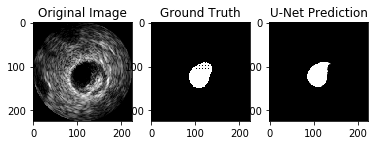





143
The intersection area is 1935
The     union    area is 2471
Calculated Jaccard Measure is 0.783083771752327
DICE Coefficient :  0.8783477076713573


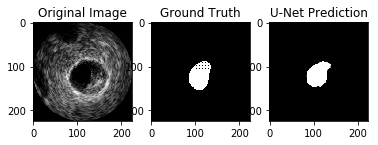





144
The intersection area is 1681
The     union    area is 2600
Calculated Jaccard Measure is 0.6465384615384615
DICE Coefficient :  0.7853305302499416


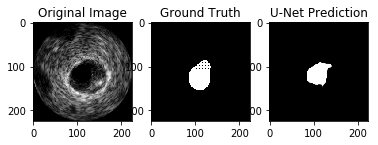





145
The intersection area is 2152
The     union    area is 2816
Calculated Jaccard Measure is 0.7642045454545454
DICE Coefficient :  0.8663446054750402


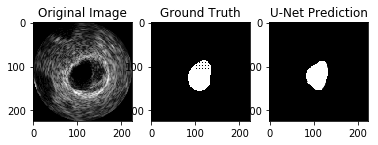





146
The intersection area is 2424
The     union    area is 2925
Calculated Jaccard Measure is 0.8287179487179487
DICE Coefficient :  0.9063376332024677


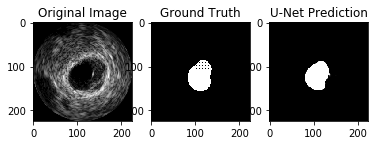





147
The intersection area is 2424
The     union    area is 2993
Calculated Jaccard Measure is 0.8098897427330438
DICE Coefficient :  0.894960310134761


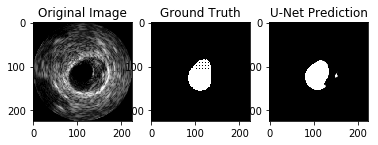





148
The intersection area is 2549
The     union    area is 2935
Calculated Jaccard Measure is 0.8684838160136287
DICE Coefficient :  0.9296134208606857


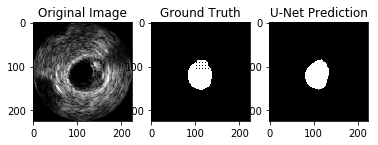





149
The intersection area is 2257
The     union    area is 2695
Calculated Jaccard Measure is 0.8374768089053803
DICE Coefficient :  0.9115508885298869


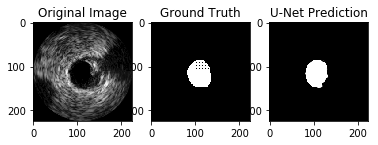





150
The intersection area is 2098
The     union    area is 2773
Calculated Jaccard Measure is 0.7565813198701767
DICE Coefficient :  0.861424758776432


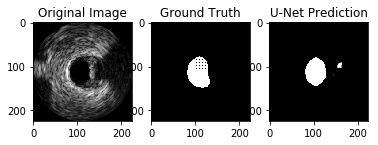





151
The intersection area is 1856
The     union    area is 2670
Calculated Jaccard Measure is 0.6951310861423221
DICE Coefficient :  0.8201502430402121


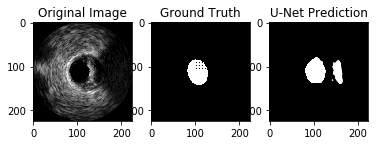





152
The intersection area is 1686
The     union    area is 2519
Calculated Jaccard Measure is 0.6693132195315601
DICE Coefficient :  0.8019024970273484


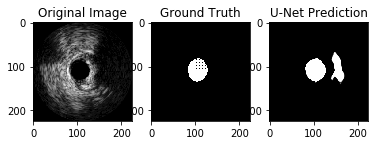





153
The intersection area is 1474
The     union    area is 2240
Calculated Jaccard Measure is 0.6580357142857143
DICE Coefficient :  0.7937533656435111


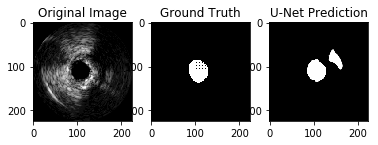





154
The intersection area is 1442
The     union    area is 1936
Calculated Jaccard Measure is 0.7448347107438017
DICE Coefficient :  0.8537596210775606


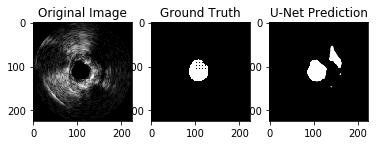





155
The intersection area is 1369
The     union    area is 2345
Calculated Jaccard Measure is 0.5837953091684435
DICE Coefficient :  0.7372105546580506


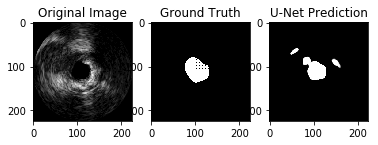





156
The intersection area is 2583
The     union    area is 3436
Calculated Jaccard Measure is 0.7517462165308498
DICE Coefficient :  0.8582821066622363


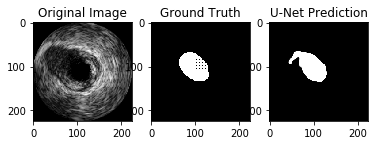





157
The intersection area is 3028
The     union    area is 3914
Calculated Jaccard Measure is 0.7736331119059785
DICE Coefficient :  0.8723710746182657


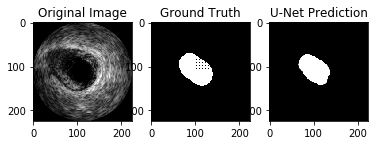





158
The intersection area is 3317
The     union    area is 4384
Calculated Jaccard Measure is 0.7566149635036497
DICE Coefficient :  0.8614465653811193


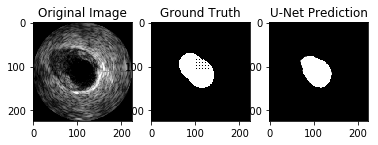





159
The intersection area is 3546
The     union    area is 4173
Calculated Jaccard Measure is 0.8497483824586628
DICE Coefficient :  0.9187718616401088


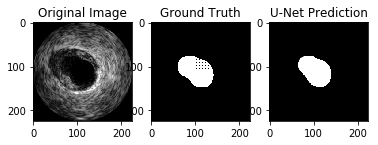





160
The intersection area is 3554
The     union    area is 4346
Calculated Jaccard Measure is 0.8177634606534745
DICE Coefficient :  0.899746835443038


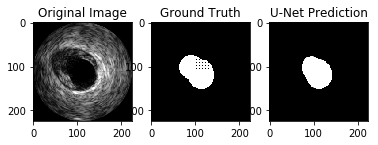





161
The intersection area is 3407
The     union    area is 4220
Calculated Jaccard Measure is 0.807345971563981
DICE Coefficient :  0.8934050085223548


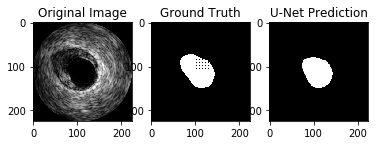





162
The intersection area is 3506
The     union    area is 3826
Calculated Jaccard Measure is 0.9163617354939885
DICE Coefficient :  0.9563557010365521


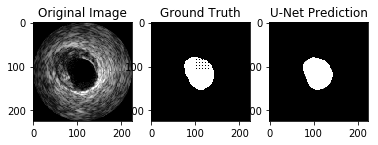





163
The intersection area is 3432
The     union    area is 3772
Calculated Jaccard Measure is 0.9098621420996819
DICE Coefficient :  0.9528039977790117


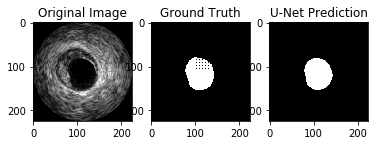





164
The intersection area is 3379
The     union    area is 3694
Calculated Jaccard Measure is 0.9147265836491608
DICE Coefficient :  0.9554644422451577


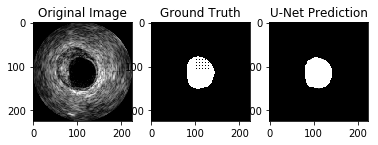





165
The intersection area is 3020
The     union    area is 3856
Calculated Jaccard Measure is 0.783195020746888
DICE Coefficient :  0.8784176847004073


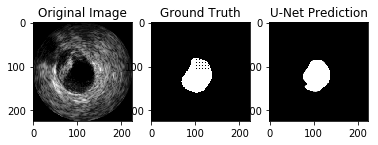





166
The intersection area is 2201
The     union    area is 3484
Calculated Jaccard Measure is 0.6317451205510907
DICE Coefficient :  0.7743183817062445


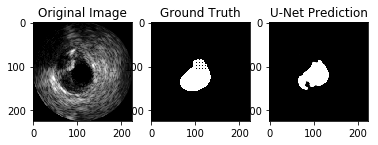





167
The intersection area is 2628
The     union    area is 4227
Calculated Jaccard Measure is 0.6217175301632364
DICE Coefficient :  0.7667396061269146


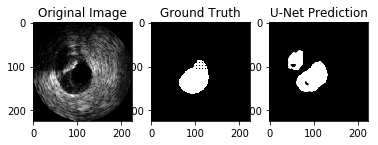





168
The intersection area is 2148
The     union    area is 3953
Calculated Jaccard Measure is 0.5433847710599544
DICE Coefficient :  0.7041468611702999


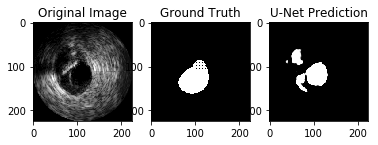





169
The intersection area is 2265
The     union    area is 3701
Calculated Jaccard Measure is 0.6119967576330722
DICE Coefficient :  0.7593027153871941


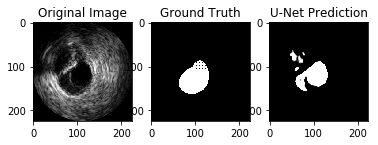





170
The intersection area is 2684
The     union    area is 3729
Calculated Jaccard Measure is 0.7197640117994101
DICE Coefficient :  0.8370497427101201


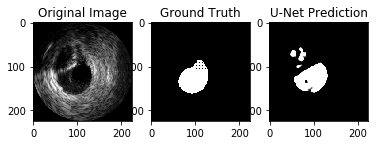





171
The intersection area is 2363
The     union    area is 2870
Calculated Jaccard Measure is 0.8233449477351916
DICE Coefficient :  0.9031148480794955


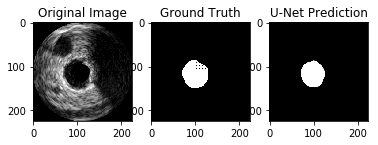





172
The intersection area is 2512
The     union    area is 2873
Calculated Jaccard Measure is 0.8743473720849286
DICE Coefficient :  0.9329619312906221


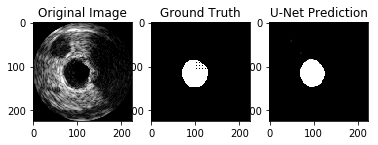





173
The intersection area is 2499
The     union    area is 2993
Calculated Jaccard Measure is 0.8349482124958236
DICE Coefficient :  0.9100509832483612


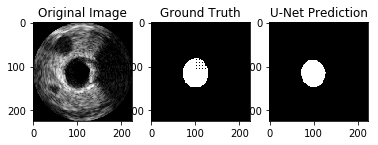





174
The intersection area is 2561
The     union    area is 3131
Calculated Jaccard Measure is 0.8179495368891728
DICE Coefficient :  0.8998594518622628


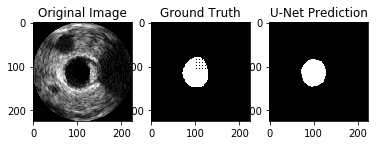





175
The intersection area is 2852
The     union    area is 3309
Calculated Jaccard Measure is 0.8618918102145663
DICE Coefficient :  0.925823729913975


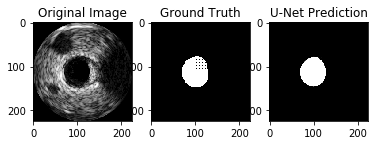





176
The intersection area is 2839
The     union    area is 3457
Calculated Jaccard Measure is 0.821232282325716
DICE Coefficient :  0.9018424396442185


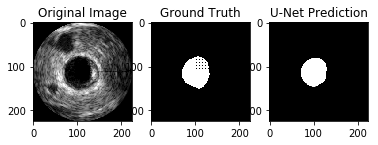





177
The intersection area is 3087
The     union    area is 3698
Calculated Jaccard Measure is 0.8347755543537047
DICE Coefficient :  0.9099484156226971


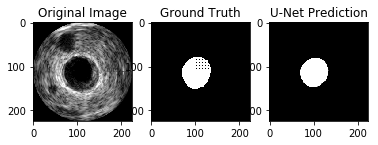





178
The intersection area is 2995
The     union    area is 4130
Calculated Jaccard Measure is 0.725181598062954
DICE Coefficient :  0.840701754385965


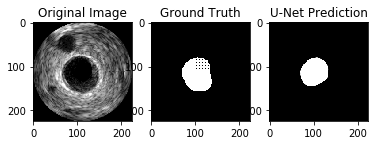





179
The intersection area is 3555
The     union    area is 4261
Calculated Jaccard Measure is 0.8343111945552687
DICE Coefficient :  0.9096724667349028


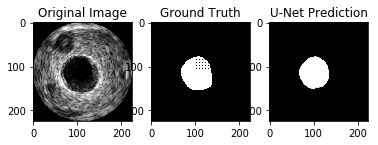





180
The intersection area is 2993
The     union    area is 4320
Calculated Jaccard Measure is 0.6928240740740741
DICE Coefficient :  0.8185423218925202


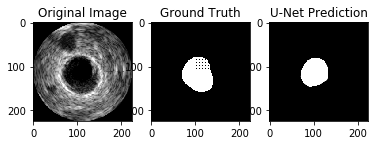





181
The intersection area is 3318
The     union    area is 4231
Calculated Jaccard Measure is 0.7842117702670763
DICE Coefficient :  0.8790568287190357


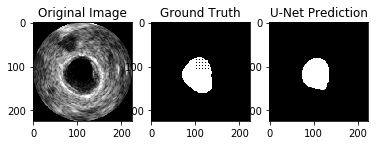





182
The intersection area is 3477
The     union    area is 4121
Calculated Jaccard Measure is 0.8437272506673138
DICE Coefficient :  0.9152408528560148


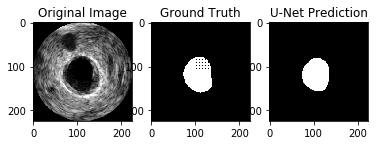





183
The intersection area is 3295
The     union    area is 4112
Calculated Jaccard Measure is 0.8013132295719845
DICE Coefficient :  0.8896989334413393


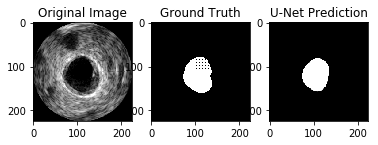





184
The intersection area is 2895
The     union    area is 4089
Calculated Jaccard Measure is 0.7079970652971387
DICE Coefficient :  0.8290378006872853


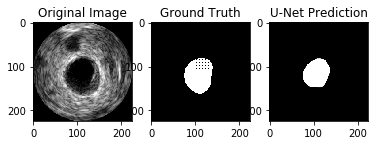





185
The intersection area is 3084
The     union    area is 3929
Calculated Jaccard Measure is 0.7849325528124205
DICE Coefficient :  0.8795094823898474


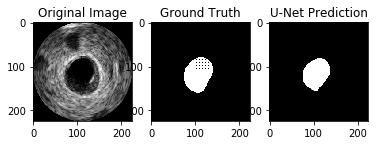





186
The intersection area is 2850
The     union    area is 3821
Calculated Jaccard Measure is 0.7458780423972782
DICE Coefficient :  0.8544446110028482


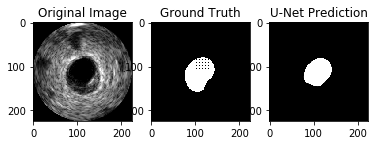





187
The intersection area is 2588
The     union    area is 3512
Calculated Jaccard Measure is 0.7369020501138952
DICE Coefficient :  0.8485245901639344


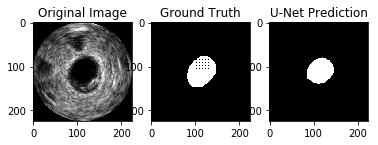





188
The intersection area is 2648
The     union    area is 3305
Calculated Jaccard Measure is 0.8012102874432677
DICE Coefficient :  0.8896354779102973


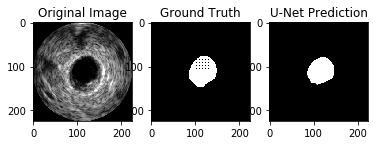





189
The intersection area is 2868
The     union    area is 3499
Calculated Jaccard Measure is 0.8196627607887969
DICE Coefficient :  0.900895241086854


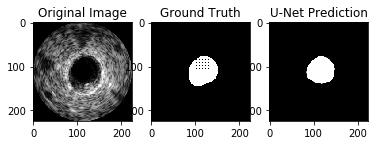





190
The intersection area is 2568
The     union    area is 3341
Calculated Jaccard Measure is 0.7686321460640527
DICE Coefficient :  0.869182602809274


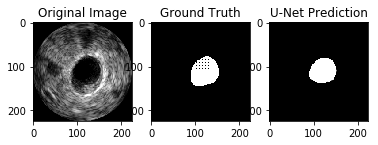





191
The intersection area is 2662
The     union    area is 3191
Calculated Jaccard Measure is 0.8342212472579129
DICE Coefficient :  0.9096189988040321


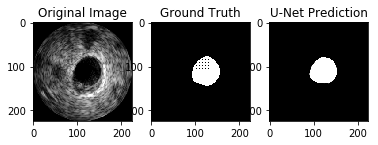





192
The intersection area is 2372
The     union    area is 3200
Calculated Jaccard Measure is 0.74125
DICE Coefficient :  0.8513998564249821


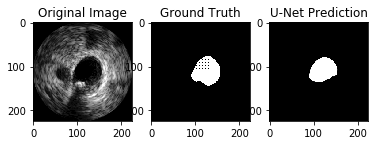





193
The intersection area is 2027
The     union    area is 3045
Calculated Jaccard Measure is 0.6656814449917898
DICE Coefficient :  0.7992902208201893


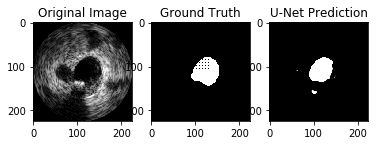





194
The intersection area is 2196
The     union    area is 3522
Calculated Jaccard Measure is 0.6235093696763203
DICE Coefficient :  0.7681007345225603


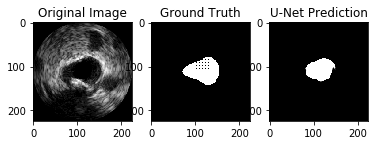





195
The intersection area is 2147
The     union    area is 3016
Calculated Jaccard Measure is 0.7118700265251989
DICE Coefficient :  0.831687003680031


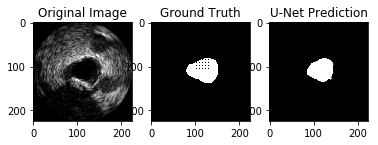





196
The intersection area is 1625
The     union    area is 2401
Calculated Jaccard Measure is 0.6768013327780091
DICE Coefficient :  0.8072528564331843


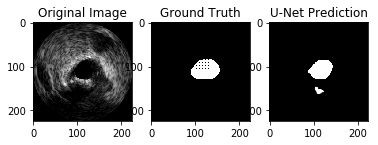





197
The intersection area is 1633
The     union    area is 2262
Calculated Jaccard Measure is 0.7219274977895668
DICE Coefficient :  0.8385109114249037


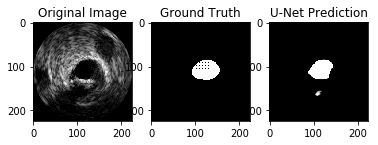





198
The intersection area is 1782
The     union    area is 2280
Calculated Jaccard Measure is 0.781578947368421
DICE Coefficient :  0.8774002954209749


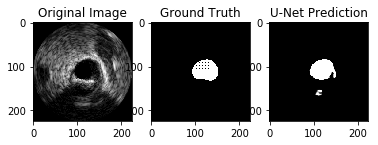





199
The intersection area is 1855
The     union    area is 2283
Calculated Jaccard Measure is 0.8125273762593079
DICE Coefficient :  0.8965683905268246


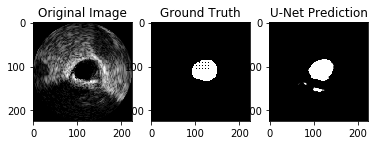





200
The intersection area is 2035
The     union    area is 2347
Calculated Jaccard Measure is 0.8670643374520665
DICE Coefficient :  0.9287996348699225


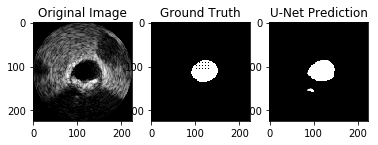





201
The intersection area is 2123
The     union    area is 2354
Calculated Jaccard Measure is 0.9018691588785047
DICE Coefficient :  0.9484029484029484


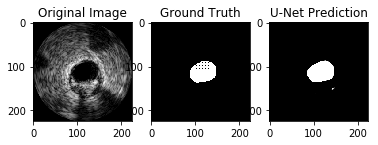





202
The intersection area is 2129
The     union    area is 2300
Calculated Jaccard Measure is 0.9256521739130434
DICE Coefficient :  0.9613908331451795


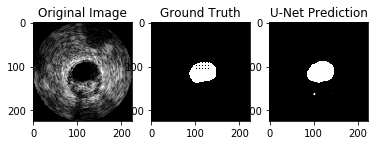





203
The intersection area is 1988
The     union    area is 2256
Calculated Jaccard Measure is 0.8812056737588653
DICE Coefficient :  0.9368520263901979


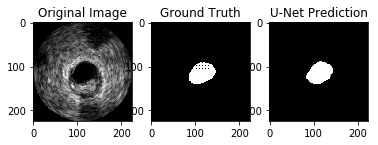





204
The intersection area is 2021
The     union    area is 2355
Calculated Jaccard Measure is 0.8581740976645436
DICE Coefficient :  0.9236745886654479


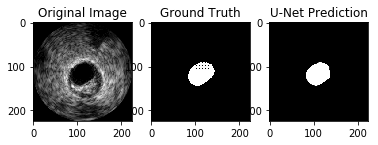





205
The intersection area is 2020
The     union    area is 2258
Calculated Jaccard Measure is 0.8945969884853853
DICE Coefficient :  0.9443665264142123


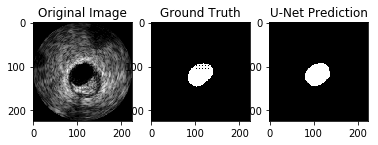





206
The intersection area is 1937
The     union    area is 2188
Calculated Jaccard Measure is 0.8852833638025595
DICE Coefficient :  0.9391515151515152


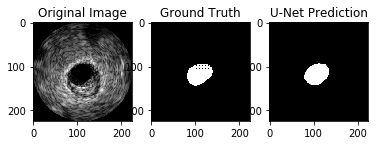





207
The intersection area is 2007
The     union    area is 2218
Calculated Jaccard Measure is 0.9048692515779982
DICE Coefficient :  0.9500591715976331


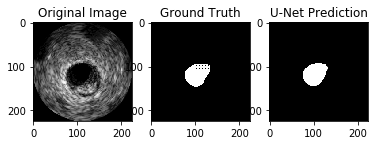





208
The intersection area is 2087
The     union    area is 2374
Calculated Jaccard Measure is 0.8791069924178602
DICE Coefficient :  0.9356646491817978


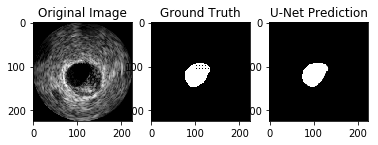





209
The intersection area is 2146
The     union    area is 2377
Calculated Jaccard Measure is 0.9028186790071518
DICE Coefficient :  0.9489277028520893


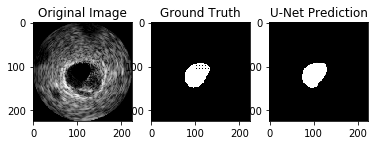





210
The intersection area is 2285
The     union    area is 2645
Calculated Jaccard Measure is 0.8638941398865785
DICE Coefficient :  0.9269776876267748


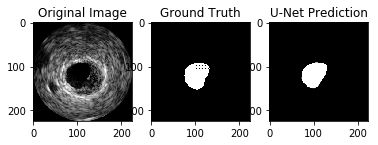





211
The intersection area is 2276
The     union    area is 2693
Calculated Jaccard Measure is 0.8451541032305978
DICE Coefficient :  0.9160796941034414


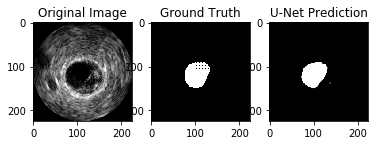





212
The intersection area is 2309
The     union    area is 2672
Calculated Jaccard Measure is 0.8641467065868264
DICE Coefficient :  0.927123067657097


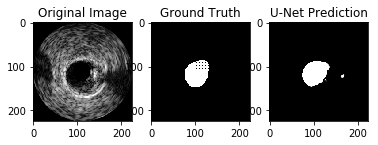





213
The intersection area is 2163
The     union    area is 2431
Calculated Jaccard Measure is 0.8897573015220074
DICE Coefficient :  0.9416630387461907


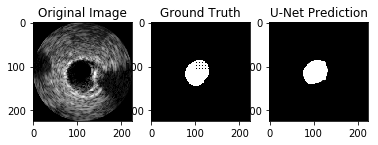





214
The intersection area is 2059
The     union    area is 2410
Calculated Jaccard Measure is 0.854356846473029
DICE Coefficient :  0.9214589393600358


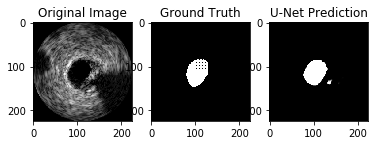





215
The intersection area is 1868
The     union    area is 2415
Calculated Jaccard Measure is 0.7734989648033126
DICE Coefficient :  0.87228578099463


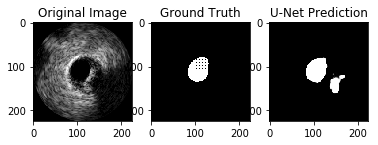





216
The intersection area is 1821
The     union    area is 1998
Calculated Jaccard Measure is 0.9114114114114115
DICE Coefficient :  0.9536527886881383


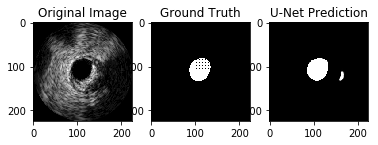





217
The intersection area is 1644
The     union    area is 1851
Calculated Jaccard Measure is 0.8881685575364667
DICE Coefficient :  0.9407725321888412


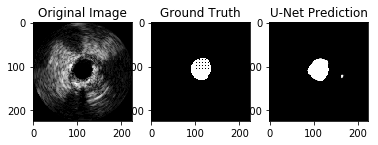





218
The intersection area is 1475
The     union    area is 1966
Calculated Jaccard Measure is 0.7502543234994914
DICE Coefficient :  0.8573089218250508


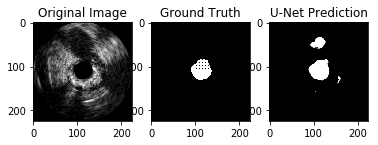





219
The intersection area is 2237
The     union    area is 2859
Calculated Jaccard Measure is 0.7824414130814971
DICE Coefficient :  0.8779434850863422


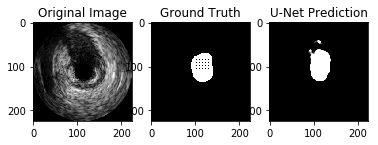





220
The intersection area is 2369
The     union    area is 4496
Calculated Jaccard Measure is 0.5269128113879004
DICE Coefficient :  0.6901675163874726


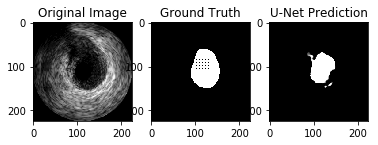





221
The intersection area is 6048
The     union    area is 9416
Calculated Jaccard Measure is 0.6423109600679694
DICE Coefficient :  0.7822038282462493


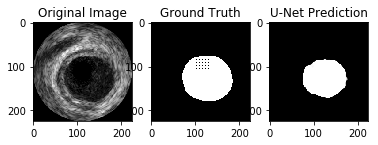





222
The intersection area is 5062
The     union    area is 9709
Calculated Jaccard Measure is 0.5213719229580801
DICE Coefficient :  0.685397061810304


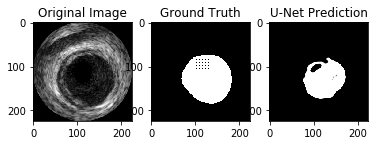





223
The intersection area is 4720
The     union    area is 10476
Calculated Jaccard Measure is 0.4505536464299351
DICE Coefficient :  0.6212161095025006


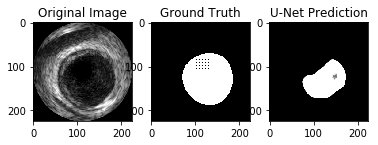





224
The intersection area is 5096
The     union    area is 10007
Calculated Jaccard Measure is 0.5092435295293295
DICE Coefficient :  0.6748328146725816


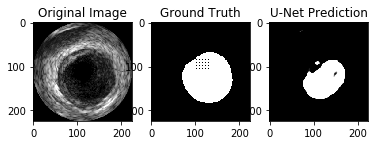





225
The intersection area is 5442
The     union    area is 9936
Calculated Jaccard Measure is 0.5477053140096618
DICE Coefficient :  0.7077643386656263


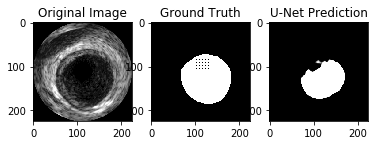





226
The intersection area is 6463
The     union    area is 10003
Calculated Jaccard Measure is 0.6461061681495551
DICE Coefficient :  0.7850115389287016


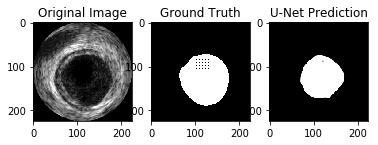





227
The intersection area is 6355
The     union    area is 10414
Calculated Jaccard Measure is 0.610236220472441
DICE Coefficient :  0.7579462102689487


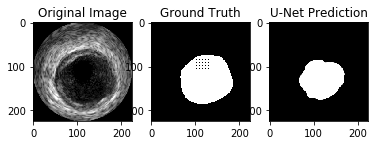





228
The intersection area is 5655
The     union    area is 9222
Calculated Jaccard Measure is 0.6132075471698113
DICE Coefficient :  0.7602339181286549


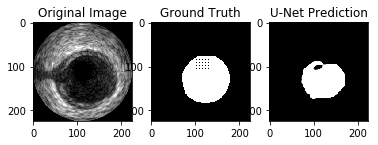





229
The intersection area is 5492
The     union    area is 7384
Calculated Jaccard Measure is 0.7437703141928494
DICE Coefficient :  0.8530599565082324


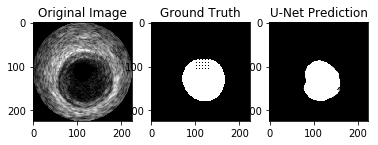





230
The intersection area is 5627
The     union    area is 6946
Calculated Jaccard Measure is 0.8101065361359056
DICE Coefficient :  0.8950926588721865


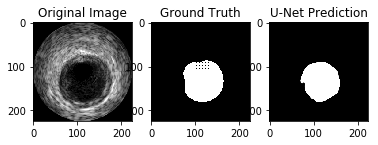





231
The intersection area is 4820
The     union    area is 6802
Calculated Jaccard Measure is 0.7086151132019994
DICE Coefficient :  0.829461366374118


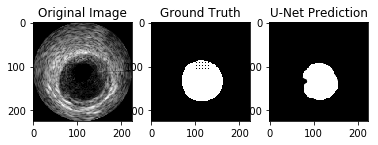





232
The intersection area is 5205
The     union    area is 6575
Calculated Jaccard Measure is 0.7916349809885932
DICE Coefficient :  0.8837011884550084


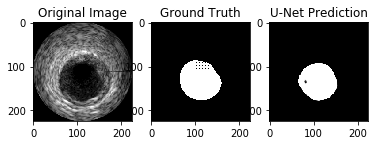





233
The intersection area is 5038
The     union    area is 6713
Calculated Jaccard Measure is 0.7504841352599434
DICE Coefficient :  0.8574589396647094


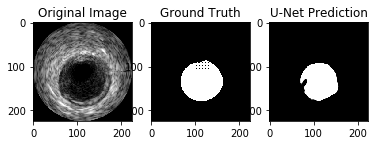





234
The intersection area is 5099
The     union    area is 6575
Calculated Jaccard Measure is 0.7755133079847909
DICE Coefficient :  0.873565187596368


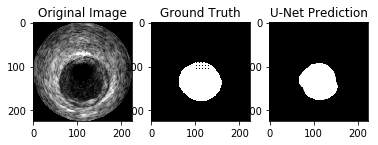





235
The intersection area is 4568
The     union    area is 5784
Calculated Jaccard Measure is 0.7897648686030428
DICE Coefficient :  0.8825347758887172


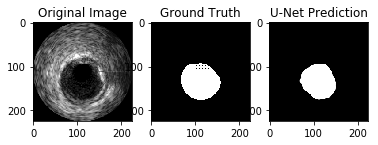





236
The intersection area is 4221
The     union    area is 4735
Calculated Jaccard Measure is 0.8914466737064414
DICE Coefficient :  0.9426083072800358


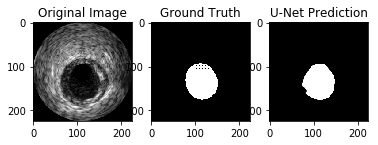





237
The intersection area is 3895
The     union    area is 4578
Calculated Jaccard Measure is 0.8508082131935343
DICE Coefficient :  0.9193910067272513


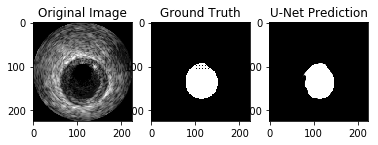





238
The intersection area is 3236
The     union    area is 3891
Calculated Jaccard Measure is 0.831662811616551
DICE Coefficient :  0.9080959730601936


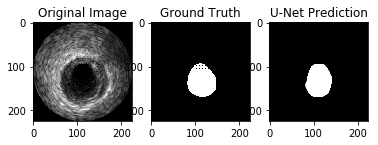





239
The intersection area is 3494
The     union    area is 3962
Calculated Jaccard Measure is 0.8818778394750126
DICE Coefficient :  0.9372317596566524


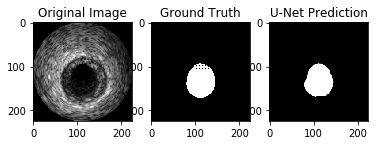





240
The intersection area is 3506
The     union    area is 4090
Calculated Jaccard Measure is 0.8572127139364303
DICE Coefficient :  0.923117430226435


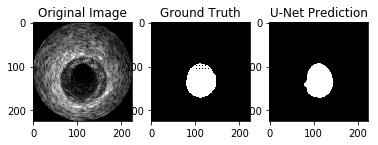





241
The intersection area is 3050
The     union    area is 3785
Calculated Jaccard Measure is 0.8058124174372523
DICE Coefficient :  0.8924652523774689


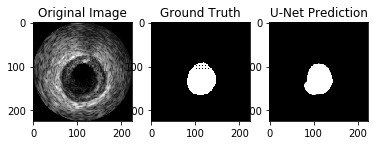





242
The intersection area is 3269
The     union    area is 3882
Calculated Jaccard Measure is 0.842091705306543
DICE Coefficient :  0.9142777233953293


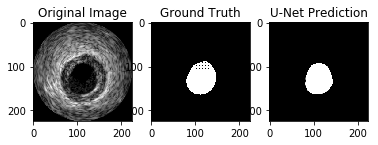





243
The intersection area is 2178
The     union    area is 3628
Calculated Jaccard Measure is 0.6003307607497244
DICE Coefficient :  0.7502583534274888


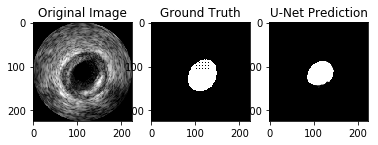





244
The intersection area is 3919
The     union    area is 4531
Calculated Jaccard Measure is 0.864930478922975
DICE Coefficient :  0.9275739644970414


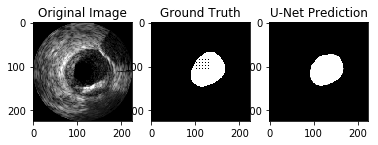





245
The intersection area is 3690
The     union    area is 4613
Calculated Jaccard Measure is 0.7999132885324084
DICE Coefficient :  0.8888353607129953


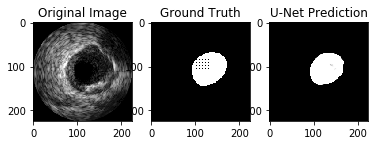





246
The intersection area is 6334
The     union    area is 7637
Calculated Jaccard Measure is 0.8293832656802409
DICE Coefficient :  0.9067353804308925


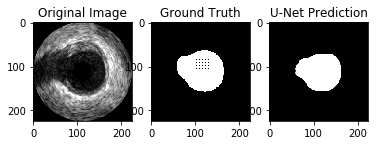





247
The intersection area is 6556
The     union    area is 7868
Calculated Jaccard Measure is 0.833248601931876
DICE Coefficient :  0.9090404880754298


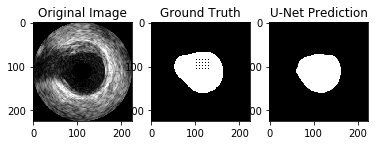





248
The intersection area is 6290
The     union    area is 7629
Calculated Jaccard Measure is 0.8244855157949927
DICE Coefficient :  0.9038005603850852


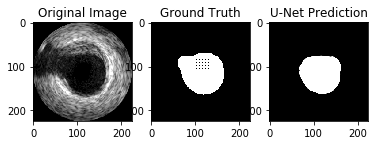





249
The intersection area is 6123
The     union    area is 7727
Calculated Jaccard Measure is 0.7924162029248091
DICE Coefficient :  0.884187725631769


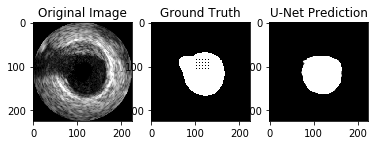





250
The intersection area is 5844
The     union    area is 7106
Calculated Jaccard Measure is 0.8224036025893611
DICE Coefficient :  0.9025482625482626


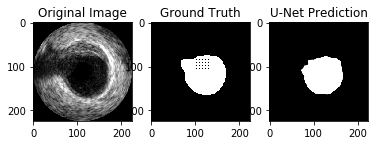





251
The intersection area is 5622
The     union    area is 7042
Calculated Jaccard Measure is 0.7983527406986651
DICE Coefficient :  0.8878711307643714


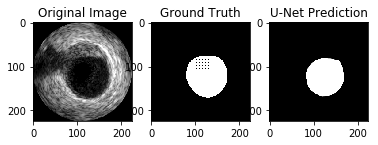





252
The intersection area is 5547
The     union    area is 6361
Calculated Jaccard Measure is 0.8720326992611225
DICE Coefficient :  0.9316425932146456


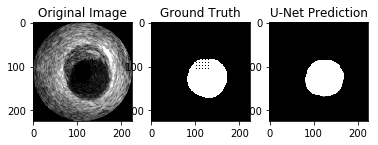





253
The intersection area is 4753
The     union    area is 6326
Calculated Jaccard Measure is 0.751343661081252
DICE Coefficient :  0.8580196768661431


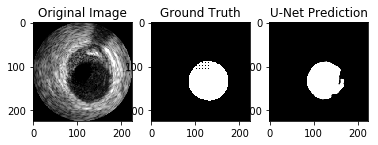





254
The intersection area is 4975
The     union    area is 6512
Calculated Jaccard Measure is 0.7639742014742015
DICE Coefficient :  0.8661965700356925


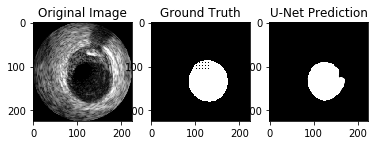





255
The intersection area is 4728
The     union    area is 6566
Calculated Jaccard Measure is 0.7200731038684131
DICE Coefficient :  0.837258721445015


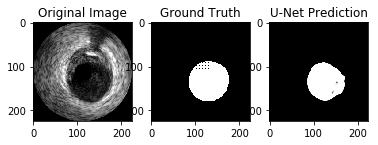





256
The intersection area is 5391
The     union    area is 6441
Calculated Jaccard Measure is 0.8369818351187703
DICE Coefficient :  0.9112576064908722


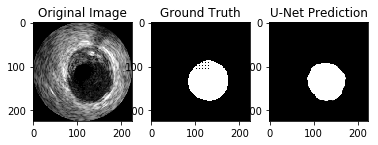





257
The intersection area is 5077
The     union    area is 6574
Calculated Jaccard Measure is 0.7722847581381199
DICE Coefficient :  0.8715131748347781


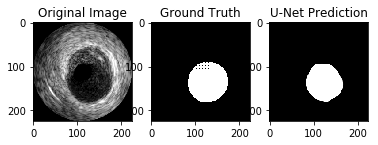





258
The intersection area is 5482
The     union    area is 6517
Calculated Jaccard Measure is 0.8411845941384073
DICE Coefficient :  0.9137428119009917


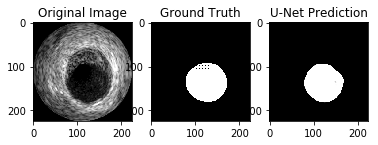





259
The intersection area is 5670
The     union    area is 6355
Calculated Jaccard Measure is 0.8922108575924469
DICE Coefficient :  0.9430353430353431


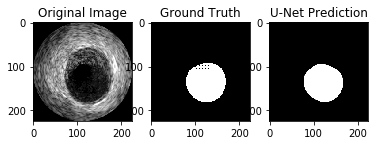





260
The intersection area is 5550
The     union    area is 6778
Calculated Jaccard Measure is 0.8188256122750074
DICE Coefficient :  0.9003893575600259


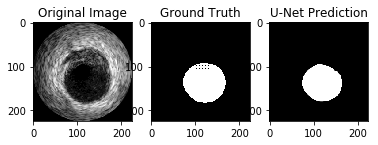





261
The intersection area is 4914
The     union    area is 6649
Calculated Jaccard Measure is 0.7390585050383516
DICE Coefficient :  0.8499524344893193


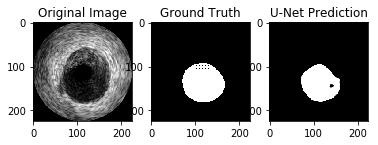





262
The intersection area is 5271
The     union    area is 6145
Calculated Jaccard Measure is 0.8577705451586656
DICE Coefficient :  0.9234407848633497


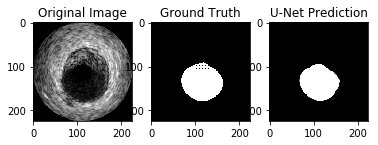





263
The intersection area is 5572
The     union    area is 6397
Calculated Jaccard Measure is 0.8710332968579021
DICE Coefficient :  0.9310719358342384


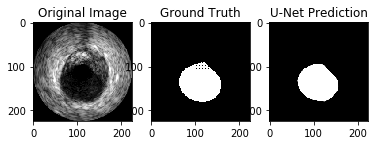





264
The intersection area is 5473
The     union    area is 6124
Calculated Jaccard Measure is 0.8936969301110386
DICE Coefficient :  0.9438647926187808


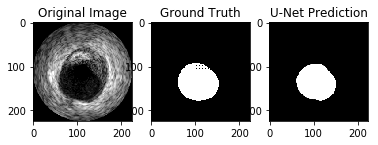





265
The intersection area is 5500
The     union    area is 5976
Calculated Jaccard Measure is 0.9203480589022758
DICE Coefficient :  0.9585221331474382


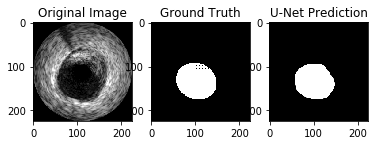





266
The intersection area is 5496
The     union    area is 5955
Calculated Jaccard Measure is 0.9229219143576827
DICE Coefficient :  0.9599161645271156


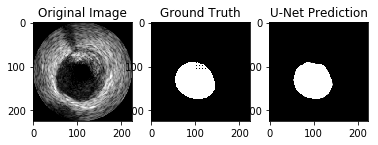





267
The intersection area is 5530
The     union    area is 6153
Calculated Jaccard Measure is 0.8987485779294653
DICE Coefficient :  0.9466746554823248


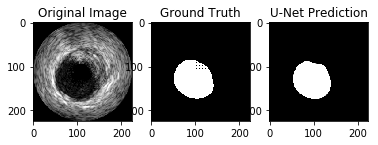





268
The intersection area is 5461
The     union    area is 6053
Calculated Jaccard Measure is 0.9021972575582355
DICE Coefficient :  0.9485843321174222


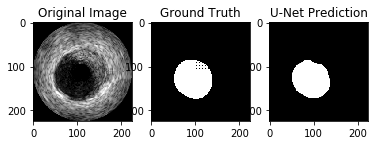





269
The intersection area is 5354
The     union    area is 6111
Calculated Jaccard Measure is 0.8761250204549174
DICE Coefficient :  0.933972961186219


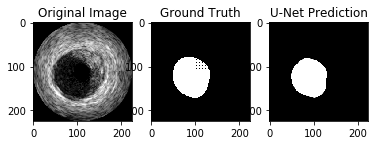





270
The intersection area is 5154
The     union    area is 5980
Calculated Jaccard Measure is 0.8618729096989967
DICE Coefficient :  0.9258128255793067


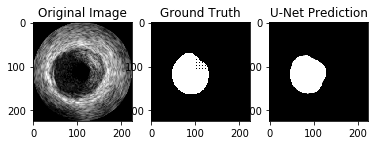





271
The intersection area is 5081
The     union    area is 5523
Calculated Jaccard Measure is 0.91997103023719
DICE Coefficient :  0.9583176159939646


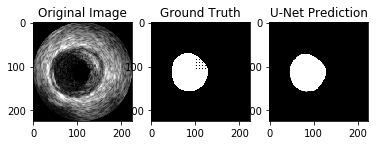





272
The intersection area is 5523
The     union    area is 6089
Calculated Jaccard Measure is 0.9070454918705863
DICE Coefficient :  0.9512573200137788


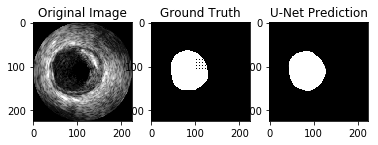





273
The intersection area is 5472
The     union    area is 6365
Calculated Jaccard Measure is 0.8597014925373134
DICE Coefficient :  0.9245585874799358


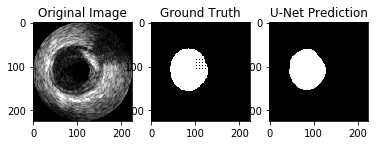





274
The intersection area is 5864
The     union    area is 7102
Calculated Jaccard Measure is 0.825682906223599
DICE Coefficient :  0.9045195125713404


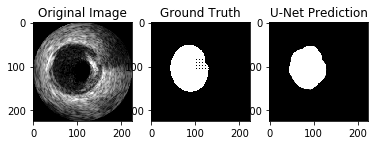





275
The intersection area is 5439
The     union    area is 7264
Calculated Jaccard Measure is 0.7487610132158591
DICE Coefficient :  0.8563331496496891


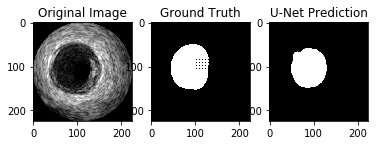





276
The intersection area is 5680
The     union    area is 7291
Calculated Jaccard Measure is 0.7790426553284872
DICE Coefficient :  0.8757998612288952


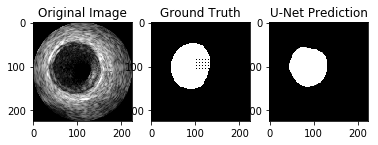





277
The intersection area is 5704
The     union    area is 7512
Calculated Jaccard Measure is 0.759318423855165
DICE Coefficient :  0.8631961259079903


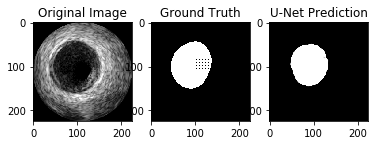





278
The intersection area is 5095
The     union    area is 7427
Calculated Jaccard Measure is 0.6860105022216239
DICE Coefficient :  0.8137677687270404


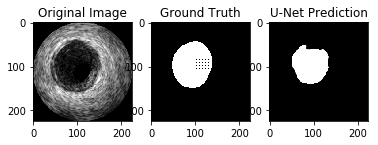





279
The intersection area is 5292
The     union    area is 7395
Calculated Jaccard Measure is 0.7156186612576065
DICE Coefficient :  0.8342397729959802


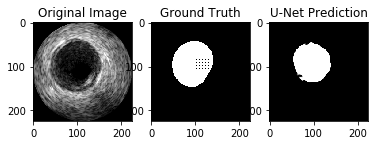





280
The intersection area is 5012
The     union    area is 6873
Calculated Jaccard Measure is 0.7292303215480868
DICE Coefficient :  0.8434160706773244


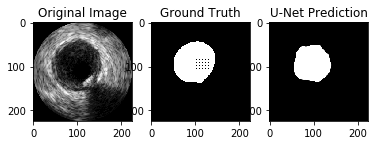





281
The intersection area is 4769
The     union    area is 6675
Calculated Jaccard Measure is 0.7144569288389513
DICE Coefficient :  0.8334498427123384


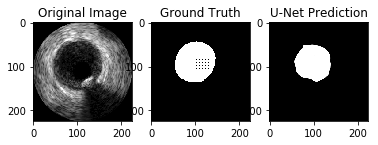





282
The intersection area is 4792
The     union    area is 6462
Calculated Jaccard Measure is 0.7415660786134324
DICE Coefficient :  0.8516083170428292


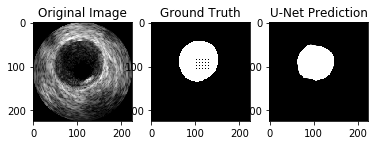





283
The intersection area is 4684
The     union    area is 5962
Calculated Jaccard Measure is 0.7856424018785643
DICE Coefficient :  0.8799549126432463


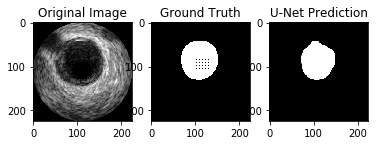





284
The intersection area is 4299
The     union    area is 6109
Calculated Jaccard Measure is 0.7037158291045997
DICE Coefficient :  0.8260953112990008


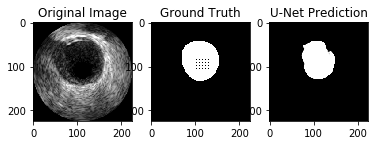





285
The intersection area is 4925
The     union    area is 6554
Calculated Jaccard Measure is 0.7514494964906927
DICE Coefficient :  0.8580886836832476


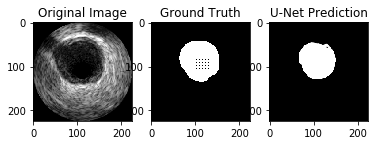





286
The intersection area is 3277
The     union    area is 6355
Calculated Jaccard Measure is 0.5156569630212431
DICE Coefficient :  0.6804401993355482


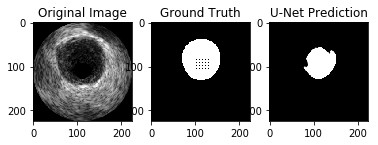





287
The intersection area is 3553
The     union    area is 6334
Calculated Jaccard Measure is 0.5609409535838333
DICE Coefficient :  0.7187215535551734


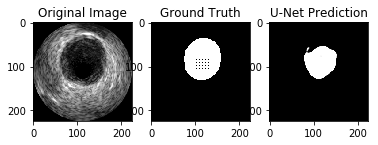





288
The intersection area is 4416
The     union    area is 6282
Calculated Jaccard Measure is 0.7029608404966571
DICE Coefficient :  0.8255748738081884


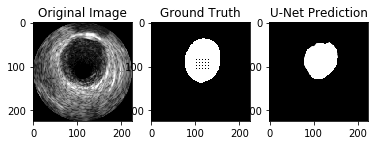





289
The intersection area is 4055
The     union    area is 6113
Calculated Jaccard Measure is 0.6633404220513659
DICE Coefficient :  0.7976003147128246


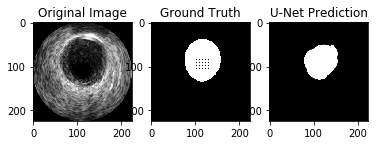





290
The intersection area is 4271
The     union    area is 5952
Calculated Jaccard Measure is 0.7175739247311828
DICE Coefficient :  0.8355668590433336


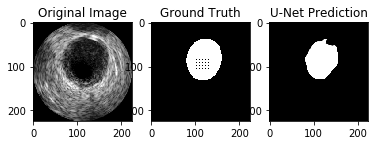





291
The intersection area is 4430
The     union    area is 6366
Calculated Jaccard Measure is 0.6958843857995601
DICE Coefficient :  0.8206743238236384


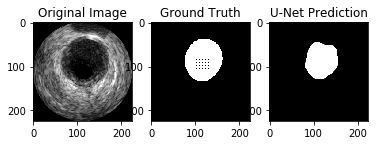





292
The intersection area is 3032
The     union    area is 6289
Calculated Jaccard Measure is 0.48211162346955
DICE Coefficient :  0.650573972749705


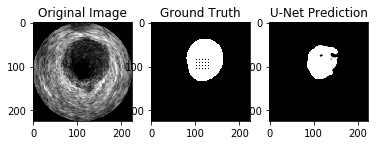





293
The intersection area is 3795
The     union    area is 5707
Calculated Jaccard Measure is 0.6649728403714736
DICE Coefficient :  0.7987792043780256


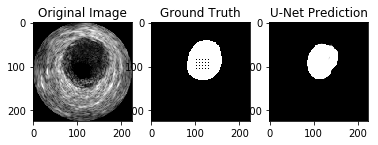





294
The intersection area is 2943
The     union    area is 5943
Calculated Jaccard Measure is 0.49520444220090865
DICE Coefficient :  0.662390276839973


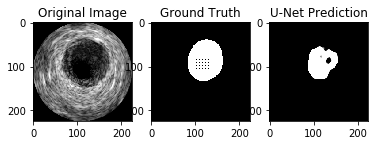





295
The intersection area is 3629
The     union    area is 5731
Calculated Jaccard Measure is 0.6332228232420171
DICE Coefficient :  0.7754273504273504


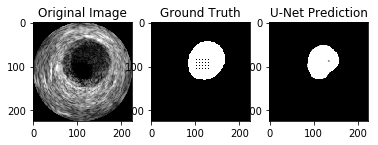





296
The intersection area is 3771
The     union    area is 4267
Calculated Jaccard Measure is 0.8837590813217717
DICE Coefficient :  0.9382931077382434


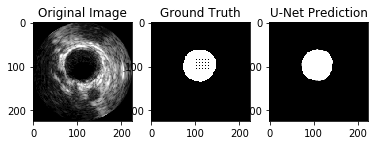





297
The intersection area is 3487
The     union    area is 3894
Calculated Jaccard Measure is 0.8954802259887006
DICE Coefficient :  0.9448584202682563


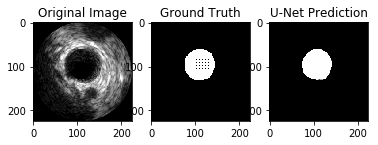





298
The intersection area is 3411
The     union    area is 4014
Calculated Jaccard Measure is 0.8497757847533632
DICE Coefficient :  0.9187878787878788


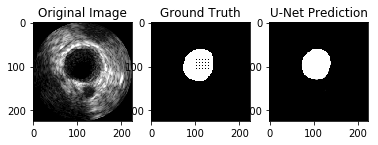





299
The intersection area is 3343
The     union    area is 3963
Calculated Jaccard Measure is 0.8435528639919253
DICE Coefficient :  0.9151382425403778


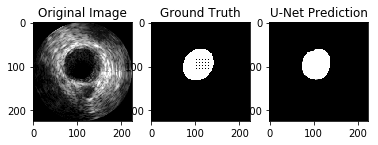





300
The intersection area is 3389
The     union    area is 4091
Calculated Jaccard Measure is 0.8284038132485945
DICE Coefficient :  0.9061497326203208


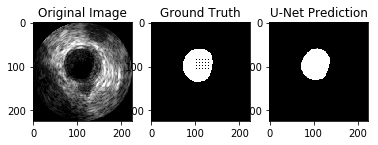





301
The intersection area is 3325
The     union    area is 4086
Calculated Jaccard Measure is 0.8137542829172785
DICE Coefficient :  0.8973148023208743


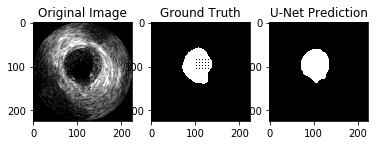





302
The intersection area is 3296
The     union    area is 4163
Calculated Jaccard Measure is 0.7917367283209225
DICE Coefficient :  0.883764579702373


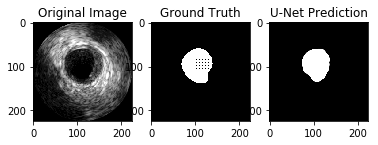





303
The intersection area is 2482
The     union    area is 3796
Calculated Jaccard Measure is 0.6538461538461539
DICE Coefficient :  0.7906976744186046


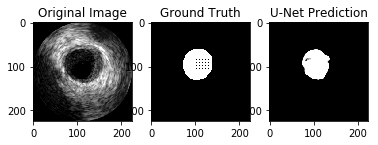





304
The intersection area is 2635
The     union    area is 3654
Calculated Jaccard Measure is 0.7211275314723591
DICE Coefficient :  0.8379710605819685


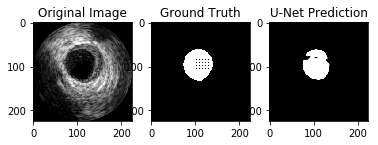





305
The intersection area is 3165
The     union    area is 3772
Calculated Jaccard Measure is 0.8390774125132555
DICE Coefficient :  0.9124981980683292


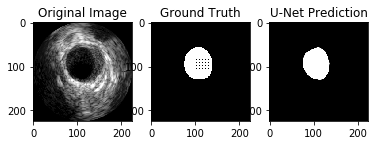





306
The intersection area is 3087
The     union    area is 3879
Calculated Jaccard Measure is 0.7958236658932715
DICE Coefficient :  0.8863049095607235


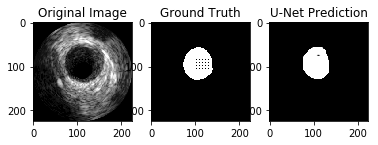





307
The intersection area is 3119
The     union    area is 3886
Calculated Jaccard Measure is 0.8026248069994854
DICE Coefficient :  0.8905067808708066


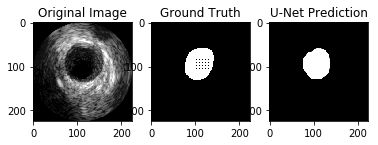





308
The intersection area is 3398
The     union    area is 4287
Calculated Jaccard Measure is 0.7926288780032656
DICE Coefficient :  0.8843201040988939


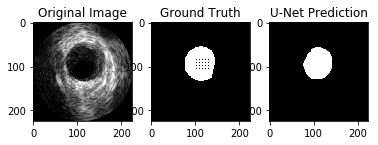





309
The intersection area is 3557
The     union    area is 4244
Calculated Jaccard Measure is 0.838124410933082
DICE Coefficient :  0.9119343673887963


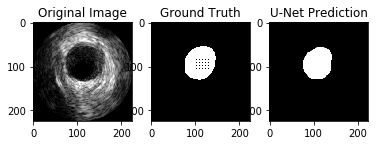





310
The intersection area is 3158
The     union    area is 4221
Calculated Jaccard Measure is 0.7481639421937929
DICE Coefficient :  0.8559425396395175


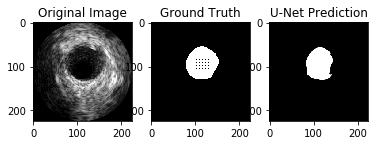





311
The intersection area is 3267
The     union    area is 4224
Calculated Jaccard Measure is 0.7734375
DICE Coefficient :  0.8722466960352423


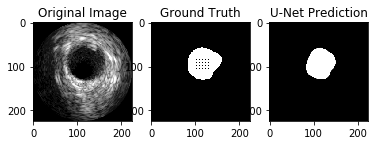





312
The intersection area is 2868
The     union    area is 4596
Calculated Jaccard Measure is 0.6240208877284595
DICE Coefficient :  0.7684887459807074


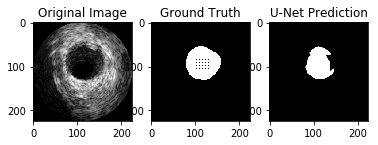





313
The intersection area is 3671
The     union    area is 5071
Calculated Jaccard Measure is 0.7239203312956024
DICE Coefficient :  0.8398535804163807


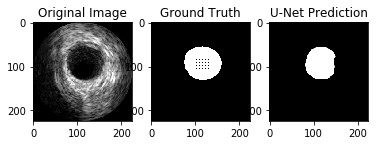





314
The intersection area is 3233
The     union    area is 4831
Calculated Jaccard Measure is 0.6692196232664045
DICE Coefficient :  0.8018353174603174


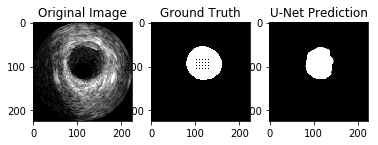





315
The intersection area is 3947
The     union    area is 4940
Calculated Jaccard Measure is 0.7989878542510122
DICE Coefficient :  0.8882637560481602


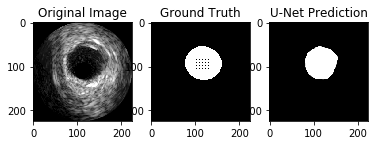





316
The intersection area is 3485
The     union    area is 4703
Calculated Jaccard Measure is 0.7410163725281735
DICE Coefficient :  0.8512457254518808


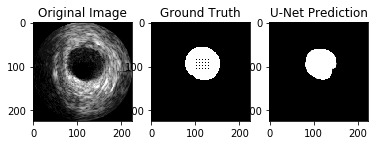





317
The intersection area is 2818
The     union    area is 4382
Calculated Jaccard Measure is 0.6430853491556366
DICE Coefficient :  0.7827777777777778


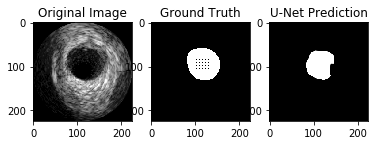





318
The intersection area is 2532
The     union    area is 4167
Calculated Jaccard Measure is 0.6076313894888409
DICE Coefficient :  0.7559337214509628


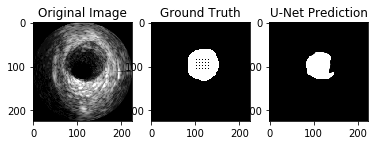





319
The intersection area is 2305
The     union    area is 3799
Calculated Jaccard Measure is 0.6067386154251119
DICE Coefficient :  0.7552424639580603


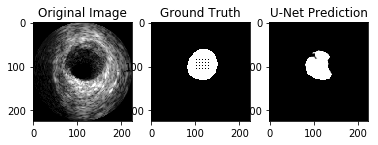





320
The intersection area is 2389
The     union    area is 3796
Calculated Jaccard Measure is 0.6293466807165438
DICE Coefficient :  0.7725141471301536


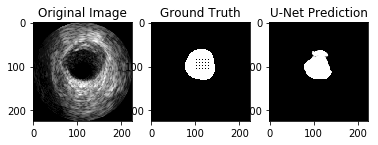





321
The intersection area is 2911
The     union    area is 4041
Calculated Jaccard Measure is 0.7203662459787181
DICE Coefficient :  0.8374568469505178


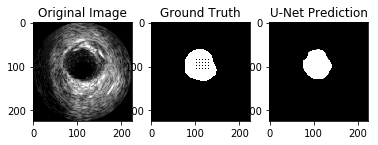





322
The intersection area is 2890
The     union    area is 3904
Calculated Jaccard Measure is 0.7402663934426229
DICE Coefficient :  0.8507506623491315


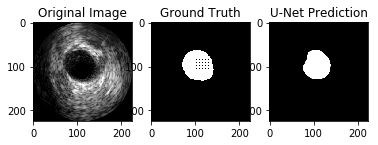





323
The intersection area is 2722
The     union    area is 3585
Calculated Jaccard Measure is 0.7592747559274756
DICE Coefficient :  0.8631679086729032


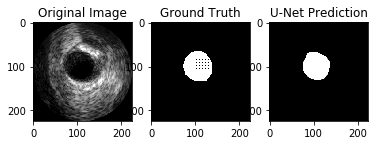





324
The intersection area is 2376
The     union    area is 3586
Calculated Jaccard Measure is 0.6625766871165644
DICE Coefficient :  0.7970479704797048


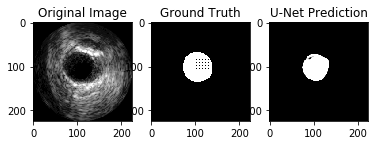





325
The intersection area is 2552
The     union    area is 3198
Calculated Jaccard Measure is 0.7979987492182614
DICE Coefficient :  0.8876521739130435


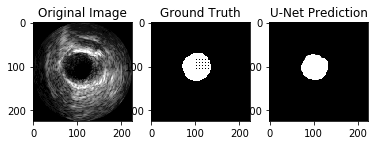



Average Jaccard : 0.7982465729551212


In [10]:
count = 0
avgJacc = 0

for pred,gt,test_img in zip(unet_preds3, all_test_lumen_labels, all_test_data):
    pred = pred[:,:,0]
    test_img = test_img[:,:,0]
    gt = gt[:,:,0]
    print("\n======================================================================\n")
    print(count)
    count += 1
    plt.subplot(1,3,1)
    plt.imshow(test_img, cmap='gray')
    plt.title("Original Image")
    
    plt.subplot(1,3,2)
    plt.imshow(gt, cmap='gray')
    plt.title("Ground Truth")
    
    plt.subplot(1,3,3)
    plt.imshow(pred, cmap='gray')
    plt.title("U-Net Prediction")
    avgJacc += Jaccard(pred.astype(np.uint8), gt.astype(np.uint8))
    g = gt.astype(np.uint8)
    p = pred.astype(np.uint8)
    print("DICE Coefficient : ", (2*np.sum(g * p)/(np.sum(p)+np.sum(g))))    
            
    plt.show()
    print("\n======================================================================\n")
    
print("Average Jaccard : {0}".format(avgJacc/326))

## Let's see how media looks after data augmentation (SGD Media 100 Epochs)

In [14]:
med_aug_hist = model.history

dict_keys(['val_diceCoef', 'loss', 'val_loss', 'diceCoef', 'lr', 'acc', 'val_acc'])


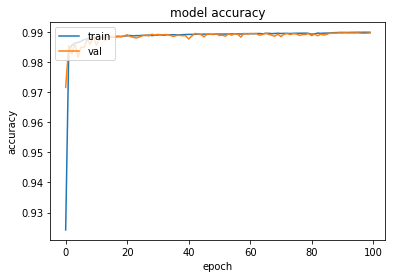

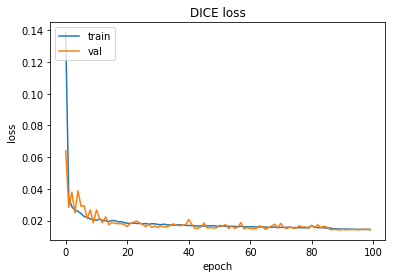

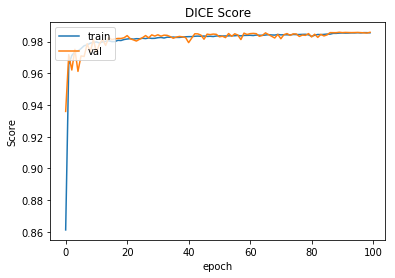

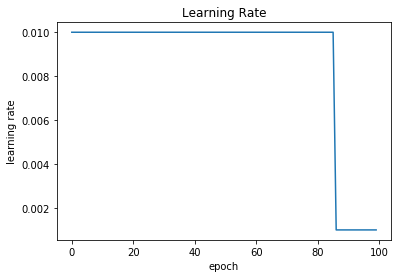

In [15]:
print(med_aug_hist.history.keys())
# print(aug_unet_vgg.history.keys)

plt.plot(med_aug_hist.history['acc'])
plt.plot(med_aug_hist.history['val_acc'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(med_aug_hist.history['loss'])
plt.plot(med_aug_hist.history['val_loss'])
plt.title('DICE loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

#summarize dice score
plt.plot(med_aug_hist.history['diceCoef'])
plt.plot(med_aug_hist.history['val_diceCoef'])
plt.title('DICE Score')
plt.ylabel('Score')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

# Summarize learning rate
plt.plot(med_aug_hist.history['lr'])
plt.title('Learning Rate')
plt.ylabel('learning rate')
plt.xlabel('epoch')
plt.show()

## Lets test the model SGD Media 100 Epochs

In [6]:
init_op = tf.initialize_all_variables()

sess = tf.Session()
sess.run(init_op)

In [17]:
mymodel2 = load_model('media_models/unet-ivus-3-sgd-media.hdf5', custom_objects={'diceCoefLoss':diceCoefLoss, 'diceCoef':diceCoef})

test_path = "D:\Chirag B\ComputerVision\IVUSProject\IVUS_DATA\Test Set\Test Set\DCM"
all_test_files = os.listdir(test_path)
test_label = "D:\Chirag B\ComputerVision\IVUSProject\Computing Jacc\Computing Jacc"


all_test_files
len(all_test_files)
image_rows = 384
image_cols = 384

all_test_data = np.ndarray((len(all_test_files) ,image_rows, image_cols), dtype=np.uint8)

# all_test_data.shape

x = 0
for test_img in all_test_files:
    im = imread(os.path.join(test_path, test_img), as_grey=True)
    all_test_data[x] = np.array([im])
    x += 1

# Load all labels
all_test_lumen_labels = scipy.io.loadmat(os.path.join(test_label, 'lumen_labels_test.mat'))
all_test_media_labels = scipy.io.loadmat(os.path.join(test_label, 'media_labels_test.mat'))


all_test_lumen_labels = np.array(all_test_lumen_labels['lumen_labels_test'])
all_test_media_labels = np.array(all_test_media_labels['media_labels_test'])



# We have all test data    
all_test_data = all_test_data[..., np.newaxis]


# resize all test images and labels
all_test_data = resizeData(all_test_data)
all_test_media_labels = resizeData(all_test_media_labels)


all_test_data.shape

C:\Users\chira\Anaconda2\envs\tensorflow\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


(326, 224, 224, 1)
(326, 224, 224, 1)


(326, 224, 224, 1)

In [18]:
x = time.time()
unet_preds4 = mymodel2.predict(all_test_data, batch_size=9, verbose=1)
x2 = time.time()
print("Time taken in seconds: {0}s ".format(x2-x))

326/326 [==============================] - 30s 93ms/step
Time taken in seconds: 30.351303100585938s 




0
The intersection area is 3639
The     union    area is 4284
Calculated Jaccard Measure is 0.8494397759103641
DICE Coefficient :  0.9185914426353654


C:\Users\chira\Anaconda2\envs\tensorflow\lib\site-packages\matplotlib\cbook\deprecation.py:106: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


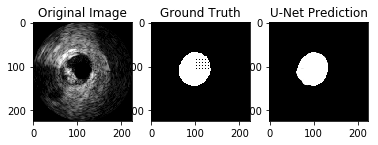





1
The intersection area is 3534
The     union    area is 4299
Calculated Jaccard Measure is 0.8220516399162596
DICE Coefficient :  0.9023362696284948


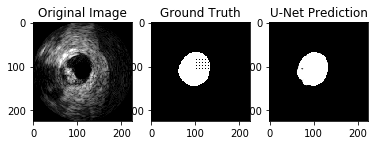





2
The intersection area is 3615
The     union    area is 4340
Calculated Jaccard Measure is 0.8329493087557603
DICE Coefficient :  0.9088623507228158


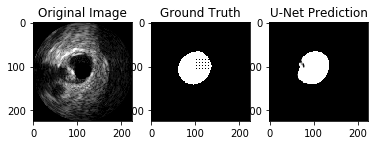





3
The intersection area is 3655
The     union    area is 4292
Calculated Jaccard Measure is 0.8515843429636533
DICE Coefficient :  0.9198439662765824


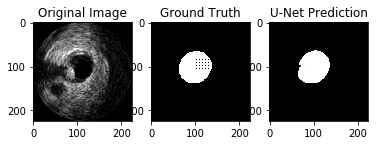





4
The intersection area is 3668
The     union    area is 4127
Calculated Jaccard Measure is 0.8887811969953961
DICE Coefficient :  0.9411161000641437


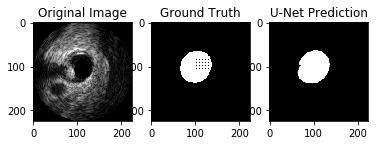





5
The intersection area is 2625
The     union    area is 4166
Calculated Jaccard Measure is 0.6301008161305809
DICE Coefficient :  0.7730820203210131


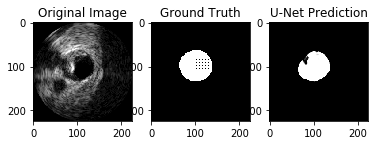





6
The intersection area is 3558
The     union    area is 5397
Calculated Jaccard Measure is 0.6592551417454141
DICE Coefficient :  0.7946398659966499


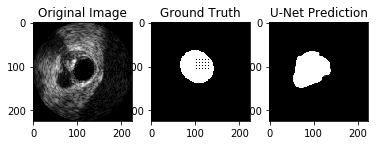





7
The intersection area is 3800
The     union    area is 4310
Calculated Jaccard Measure is 0.8816705336426914
DICE Coefficient :  0.93711467324291


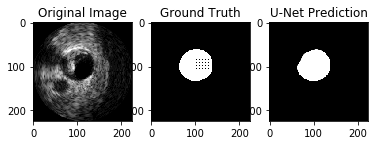





8
The intersection area is 3723
The     union    area is 4242
Calculated Jaccard Measure is 0.8776520509193777
DICE Coefficient :  0.9348399246704332


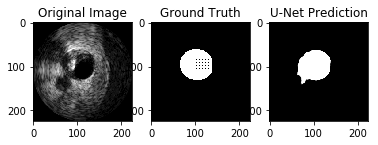





9
The intersection area is 4111
The     union    area is 5528
Calculated Jaccard Measure is 0.7436685962373372
DICE Coefficient :  0.8529930490714804


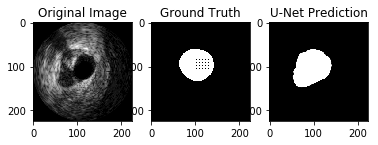





10
The intersection area is 4463
The     union    area is 5599
Calculated Jaccard Measure is 0.797106626183247
DICE Coefficient :  0.887099980123236


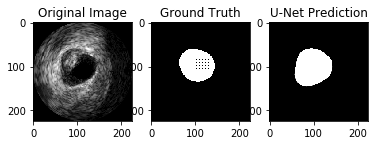





11
The intersection area is 4779
The     union    area is 5332
Calculated Jaccard Measure is 0.8962865716429107
DICE Coefficient :  0.9453070912867174


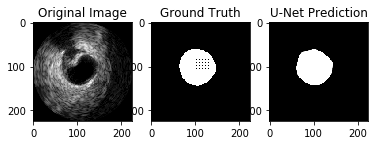





12
The intersection area is 4564
The     union    area is 5399
Calculated Jaccard Measure is 0.8453417299499908
DICE Coefficient :  0.9161899026397672


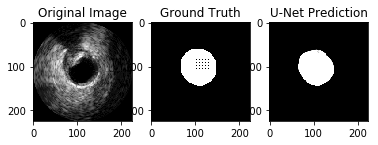





13
The intersection area is 4647
The     union    area is 5329
Calculated Jaccard Measure is 0.8720210170763746
DICE Coefficient :  0.931635926222935


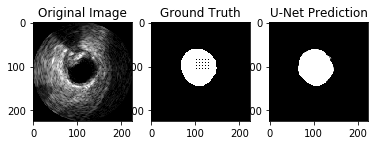





14
The intersection area is 4787
The     union    area is 5255
Calculated Jaccard Measure is 0.9109419600380589
DICE Coefficient :  0.9533957379008166


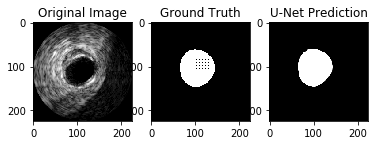





15
The intersection area is 4637
The     union    area is 5407
Calculated Jaccard Measure is 0.8575920103569447
DICE Coefficient :  0.9233373158104341


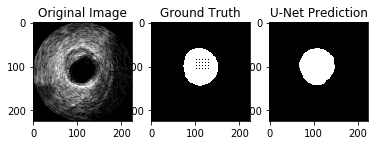





16
The intersection area is 5008
The     union    area is 5490
Calculated Jaccard Measure is 0.9122040072859745
DICE Coefficient :  0.9540864926652696


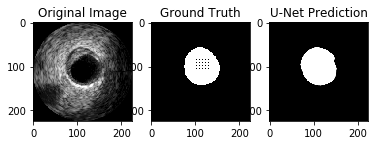





17
The intersection area is 4893
The     union    area is 5489
Calculated Jaccard Measure is 0.8914192020404446
DICE Coefficient :  0.9425929493353882


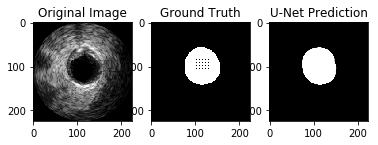





18
The intersection area is 4851
The     union    area is 5160
Calculated Jaccard Measure is 0.9401162790697675
DICE Coefficient :  0.9691339526520827


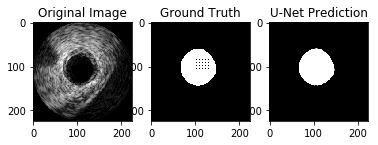





19
The intersection area is 4792
The     union    area is 5375
Calculated Jaccard Measure is 0.8915348837209303
DICE Coefficient :  0.9426576177830235


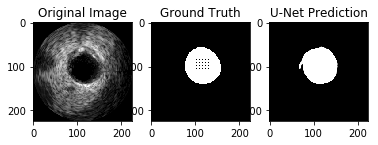





20
The intersection area is 4853
The     union    area is 5207
Calculated Jaccard Measure is 0.9320145957365086
DICE Coefficient :  0.9648111332007953


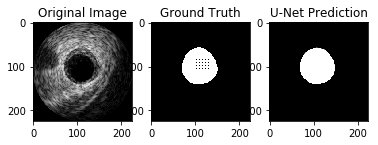





21
The intersection area is 4125
The     union    area is 4884
Calculated Jaccard Measure is 0.8445945945945946
DICE Coefficient :  0.9157509157509157


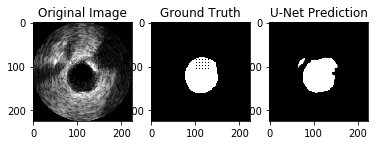





22
The intersection area is 4389
The     union    area is 4946
Calculated Jaccard Measure is 0.8873837444399515
DICE Coefficient :  0.9403320835565078


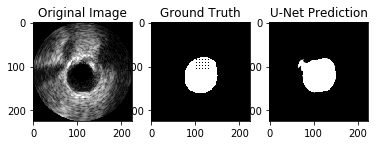





23
The intersection area is 4518
The     union    area is 5335
Calculated Jaccard Measure is 0.8468603561387067
DICE Coefficient :  0.9170810920531818


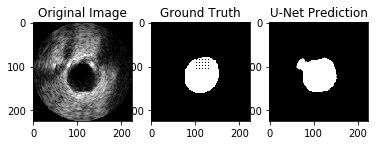





24
The intersection area is 4527
The     union    area is 5256
Calculated Jaccard Measure is 0.8613013698630136
DICE Coefficient :  0.9254829806807727


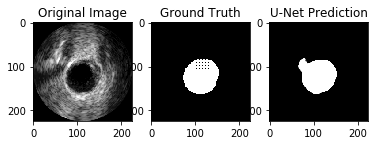





25
The intersection area is 4487
The     union    area is 5051
Calculated Jaccard Measure is 0.8883389427836073
DICE Coefficient :  0.9408681065212833


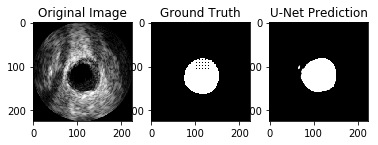





26
The intersection area is 4428
The     union    area is 5263
Calculated Jaccard Measure is 0.8413452403572107
DICE Coefficient :  0.9138375812609638


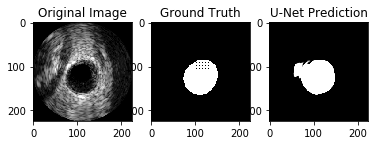





27
The intersection area is 4479
The     union    area is 4932
Calculated Jaccard Measure is 0.9081508515815085
DICE Coefficient :  0.9518648390181702


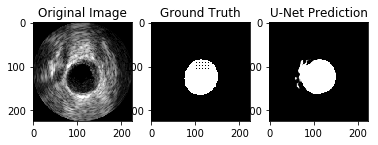





28
The intersection area is 4534
The     union    area is 5073
Calculated Jaccard Measure is 0.8937512320126159
DICE Coefficient :  0.9438950765067139


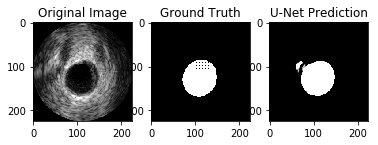





29
The intersection area is 4494
The     union    area is 5269
Calculated Jaccard Measure is 0.8529132662744354
DICE Coefficient :  0.9206186622964253


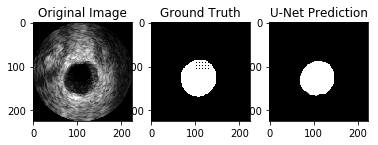





30
The intersection area is 4810
The     union    area is 5727
Calculated Jaccard Measure is 0.8398812641871836
DICE Coefficient :  0.9129733320679511


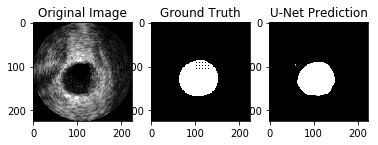





31
The intersection area is 4715
The     union    area is 6019
Calculated Jaccard Measure is 0.7833527163980728
DICE Coefficient :  0.878516862306689


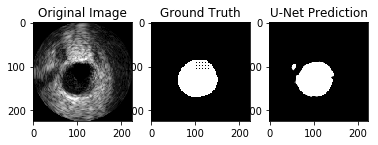





32
The intersection area is 4810
The     union    area is 6403
Calculated Jaccard Measure is 0.7512103701389974
DICE Coefficient :  0.8579327566217783


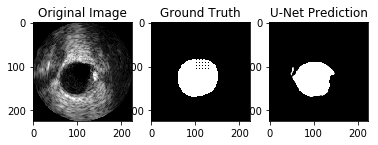





33
The intersection area is 5027
The     union    area is 6623
Calculated Jaccard Measure is 0.7590215914238261
DICE Coefficient :  0.8630042918454935


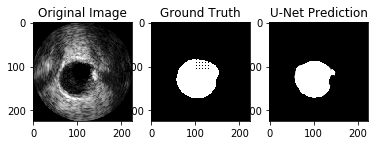





34
The intersection area is 4930
The     union    area is 6096
Calculated Jaccard Measure is 0.8087270341207349
DICE Coefficient :  0.8942499546526392


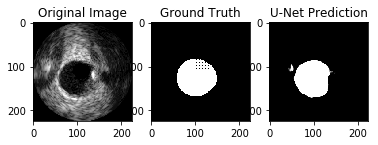





35
The intersection area is 5139
The     union    area is 6385
Calculated Jaccard Measure is 0.8048551292090838
DICE Coefficient :  0.891877820201319


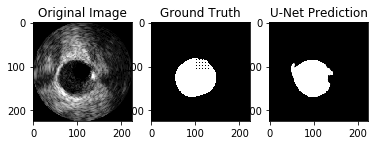





36
The intersection area is 5068
The     union    area is 6116
Calculated Jaccard Measure is 0.828646173969915
DICE Coefficient :  0.9062947067238912


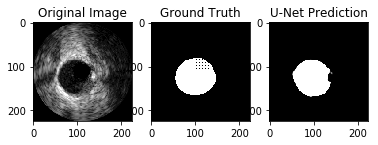





37
The intersection area is 5379
The     union    area is 6228
Calculated Jaccard Measure is 0.8636801541425819
DICE Coefficient :  0.9268544843628844


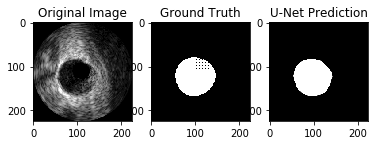





38
The intersection area is 4979
The     union    area is 6012
Calculated Jaccard Measure is 0.8281769793745841
DICE Coefficient :  0.906014011463925


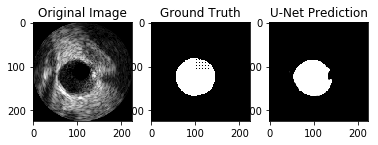





39
The intersection area is 5163
The     union    area is 5849
Calculated Jaccard Measure is 0.8827149940160711
DICE Coefficient :  0.9377043225572104


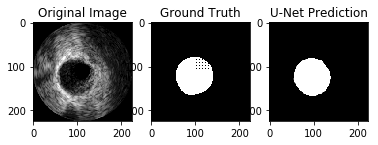





40
The intersection area is 4879
The     union    area is 5632
Calculated Jaccard Measure is 0.8662997159090909
DICE Coefficient :  0.9283607649129484


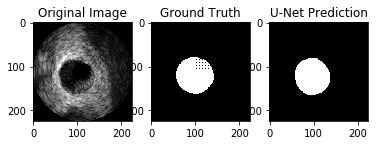





41
The intersection area is 4747
The     union    area is 5330
Calculated Jaccard Measure is 0.8906191369606004
DICE Coefficient :  0.9421454798054977


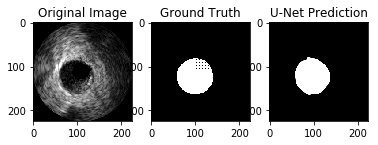





42
The intersection area is 4447
The     union    area is 5246
Calculated Jaccard Measure is 0.8476934807472359
DICE Coefficient :  0.9175693799649232


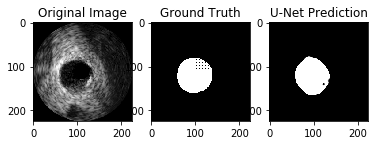





43
The intersection area is 4366
The     union    area is 5047
Calculated Jaccard Measure is 0.8650683574400634
DICE Coefficient :  0.9276532455115266


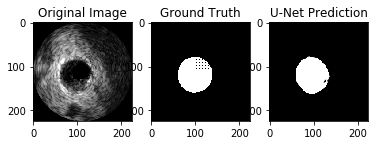





44
The intersection area is 4184
The     union    area is 4656
Calculated Jaccard Measure is 0.8986254295532646
DICE Coefficient :  0.9466063348416289


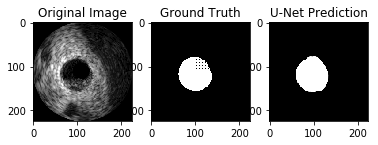





45
The intersection area is 4240
The     union    area is 4846
Calculated Jaccard Measure is 0.8749484110606686
DICE Coefficient :  0.9333039841514418


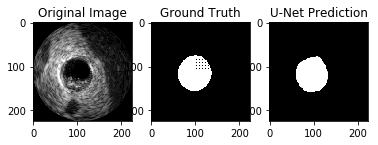





46
The intersection area is 4048
The     union    area is 4455
Calculated Jaccard Measure is 0.908641975308642
DICE Coefficient :  0.9521345407503234


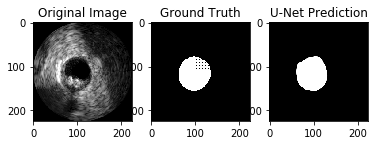





47
The intersection area is 3775
The     union    area is 4429
Calculated Jaccard Measure is 0.8523368706254233
DICE Coefficient :  0.9202827888834715


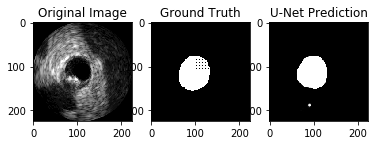





48
The intersection area is 3960
The     union    area is 4688
Calculated Jaccard Measure is 0.8447098976109215
DICE Coefficient :  0.9158186864014801


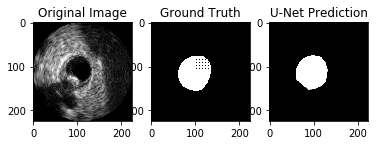





49
The intersection area is 3873
The     union    area is 4594
Calculated Jaccard Measure is 0.8430561602089682
DICE Coefficient :  0.9148458722097556


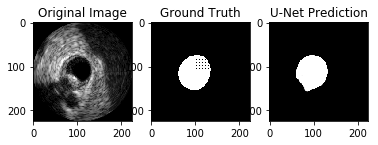





50
The intersection area is 3930
The     union    area is 4565
Calculated Jaccard Measure is 0.8608981380065718
DICE Coefficient :  0.9252501471453797


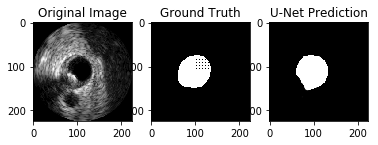





51
The intersection area is 3933
The     union    area is 4788
Calculated Jaccard Measure is 0.8214285714285714
DICE Coefficient :  0.9019607843137255


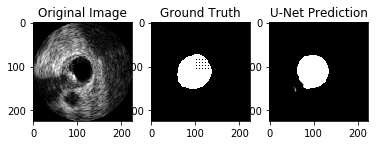





52
The intersection area is 4033
The     union    area is 4804
Calculated Jaccard Measure is 0.8395087427144047
DICE Coefficient :  0.9127531967862397


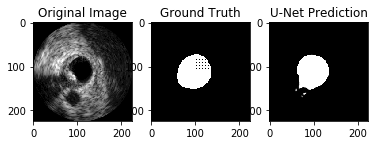





53
The intersection area is 4058
The     union    area is 4776
Calculated Jaccard Measure is 0.8496649916247906
DICE Coefficient :  0.9187231152365859


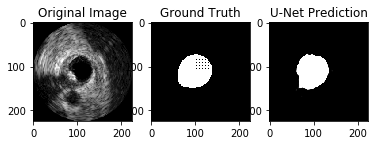





54
The intersection area is 3513
The     union    area is 4769
Calculated Jaccard Measure is 0.7366324176976305
DICE Coefficient :  0.8483458101907752


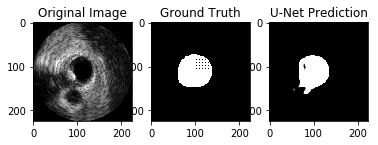





55
The intersection area is 3704
The     union    area is 5016
Calculated Jaccard Measure is 0.7384370015948963
DICE Coefficient :  0.8495412844036697


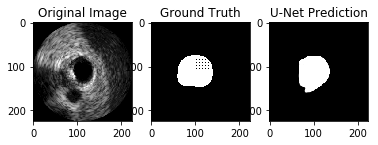





56
The intersection area is 3888
The     union    area is 5066
Calculated Jaccard Measure is 0.7674694038689301
DICE Coefficient :  0.8684386866205048


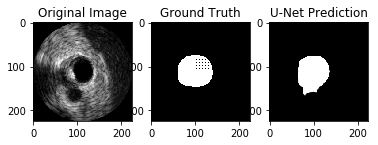





57
The intersection area is 4166
The     union    area is 5568
Calculated Jaccard Measure is 0.7482040229885057
DICE Coefficient :  0.8559687692623793


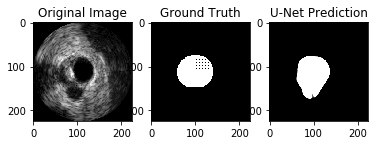





58
The intersection area is 4492
The     union    area is 5660
Calculated Jaccard Measure is 0.7936395759717314
DICE Coefficient :  0.8849487785657998


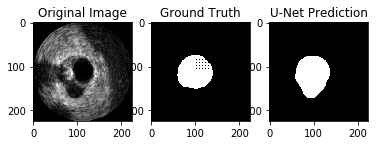





59
The intersection area is 4794
The     union    area is 5768
Calculated Jaccard Measure is 0.8311373092926491
DICE Coefficient :  0.907782616928612


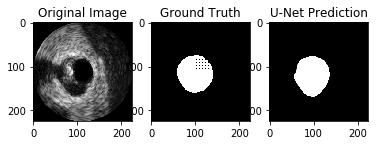





60
The intersection area is 5143
The     union    area is 5863
Calculated Jaccard Measure is 0.8771959747569503
DICE Coefficient :  0.9345811375613302


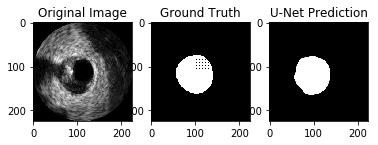





61
The intersection area is 5264
The     union    area is 5646
Calculated Jaccard Measure is 0.9323414806942969
DICE Coefficient :  0.9649862511457379


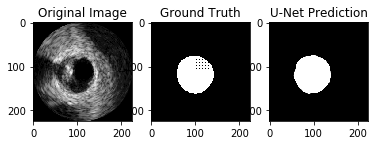





62
The intersection area is 4514
The     union    area is 5659
Calculated Jaccard Measure is 0.7976674324085528
DICE Coefficient :  0.8874471640617321


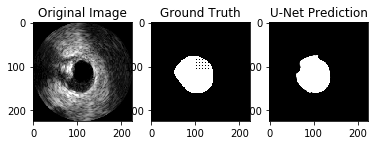





63
The intersection area is 4222
The     union    area is 5748
Calculated Jaccard Measure is 0.7345163535142658
DICE Coefficient :  0.8469408224674022


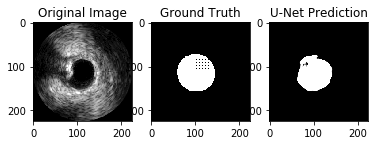





64
The intersection area is 4375
The     union    area is 5665
Calculated Jaccard Measure is 0.7722859664607238
DICE Coefficient :  0.8715139442231076


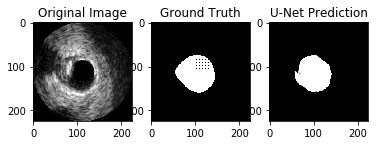





65
The intersection area is 4692
The     union    area is 5902
Calculated Jaccard Measure is 0.7949847509318875
DICE Coefficient :  0.8857844062676987


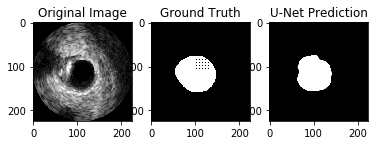





66
The intersection area is 4676
The     union    area is 6005
Calculated Jaccard Measure is 0.778684429641965
DICE Coefficient :  0.8755734481790095


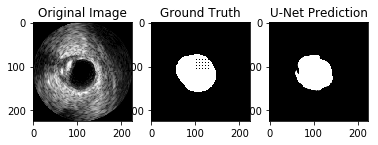





67
The intersection area is 4623
The     union    area is 6109
Calculated Jaccard Measure is 0.7567523326239973
DICE Coefficient :  0.8615355944837868


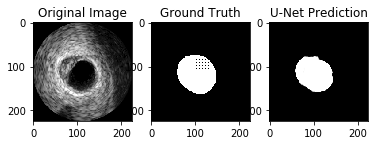





68
The intersection area is 4585
The     union    area is 5884
Calculated Jaccard Measure is 0.7792318150917743
DICE Coefficient :  0.8759193810297068


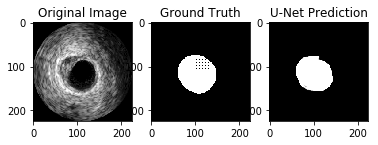





69
The intersection area is 4478
The     union    area is 5682
Calculated Jaccard Measure is 0.7881027807110172
DICE Coefficient :  0.881496062992126


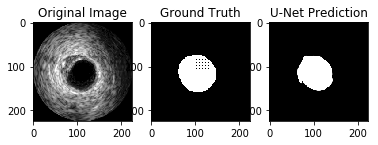





70
The intersection area is 4307
The     union    area is 5736
Calculated Jaccard Measure is 0.7508716875871687
DICE Coefficient :  0.8577118390919048


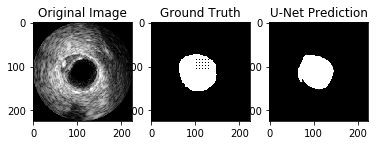





71
The intersection area is 8655
The     union    area is 9618
Calculated Jaccard Measure is 0.8998752339363693
DICE Coefficient :  0.9472992940403875


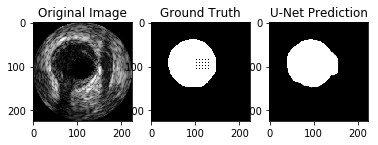





72
The intersection area is 8559
The     union    area is 9642
Calculated Jaccard Measure is 0.887678904791537
DICE Coefficient :  0.9404977748475358


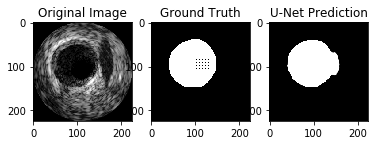





73
The intersection area is 8331
The     union    area is 9519
Calculated Jaccard Measure is 0.8751969744721084
DICE Coefficient :  0.9334453781512605


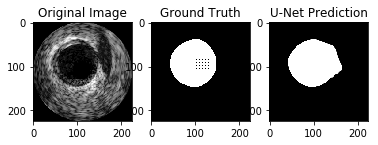





74
The intersection area is 8226
The     union    area is 9059
Calculated Jaccard Measure is 0.9080472458328734
DICE Coefficient :  0.9518079259473532


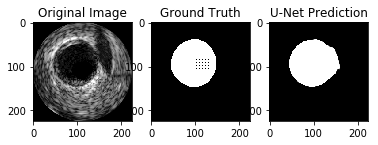





75
The intersection area is 8116
The     union    area is 8790
Calculated Jaccard Measure is 0.9233219567690557
DICE Coefficient :  0.9601324973382231


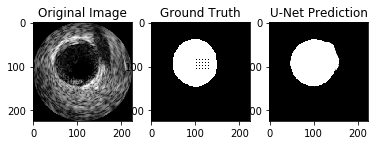





76
The intersection area is 7895
The     union    area is 8504
Calculated Jaccard Measure is 0.9283866415804327
DICE Coefficient :  0.9628635892432466


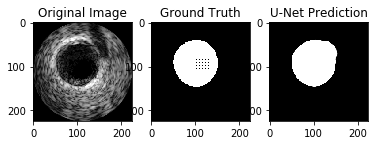





77
The intersection area is 7815
The     union    area is 8287
Calculated Jaccard Measure is 0.9430433208640039
DICE Coefficient :  0.9706868711961247


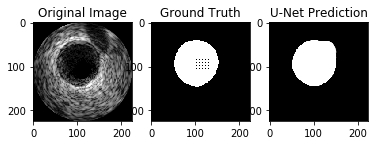





78
The intersection area is 7755
The     union    area is 8254
Calculated Jaccard Measure is 0.9395444632905258
DICE Coefficient :  0.9688300331063776


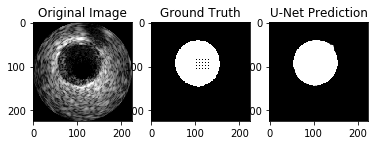





79
The intersection area is 7994
The     union    area is 8472
Calculated Jaccard Measure is 0.9435788479697829
DICE Coefficient :  0.9709704846350055


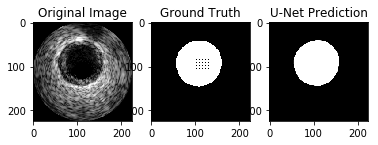





80
The intersection area is 8164
The     union    area is 8691
Calculated Jaccard Measure is 0.9393625589690484
DICE Coefficient :  0.968733313556808


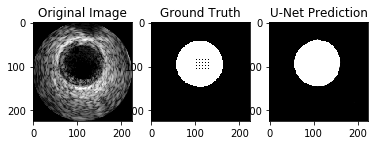





81
The intersection area is 8378
The     union    area is 8737
Calculated Jaccard Measure is 0.9589103811376903
DICE Coefficient :  0.9790242477359041


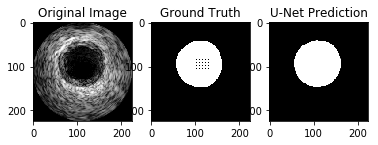





82
The intersection area is 8609
The     union    area is 8940
Calculated Jaccard Measure is 0.9629753914988815
DICE Coefficient :  0.9811385264117614


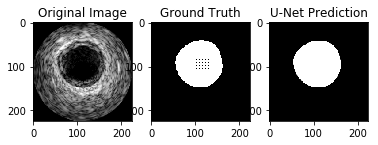





83
The intersection area is 8949
The     union    area is 9402
Calculated Jaccard Measure is 0.9518187619655393
DICE Coefficient :  0.9753146967467713


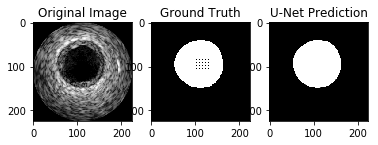





84
The intersection area is 9462
The     union    area is 10008
Calculated Jaccard Measure is 0.9454436450839329
DICE Coefficient :  0.9719568567026194


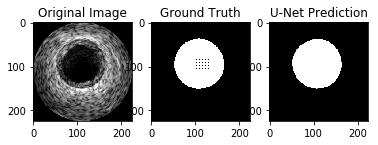





85
The intersection area is 9602
The     union    area is 10191
Calculated Jaccard Measure is 0.9422039054067314
DICE Coefficient :  0.9702420047491538


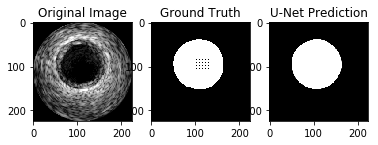





86
The intersection area is 9799
The     union    area is 10258
Calculated Jaccard Measure is 0.9552544355624878
DICE Coefficient :  0.9771152216183876


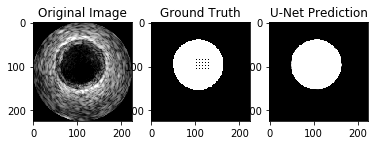





87
The intersection area is 9720
The     union    area is 10157
Calculated Jaccard Measure is 0.9569754848872699
DICE Coefficient :  0.9780147909644312


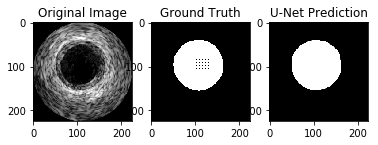





88
The intersection area is 9636
The     union    area is 10075
Calculated Jaccard Measure is 0.9564267990074442
DICE Coefficient :  0.9777281720866521


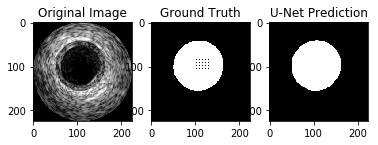





89
The intersection area is 9647
The     union    area is 10196
Calculated Jaccard Measure is 0.9461553550411926
DICE Coefficient :  0.9723328125787432


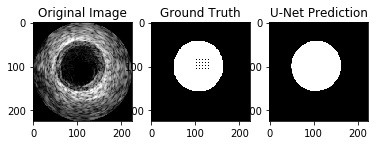





90
The intersection area is 9654
The     union    area is 10246
Calculated Jaccard Measure is 0.9422213546749951
DICE Coefficient :  0.9702512562814071


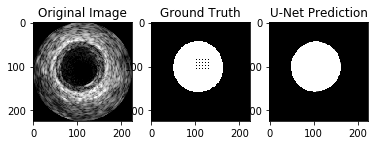





91
The intersection area is 9419
The     union    area is 10452
Calculated Jaccard Measure is 0.9011672407194795
DICE Coefficient :  0.9480146947813396


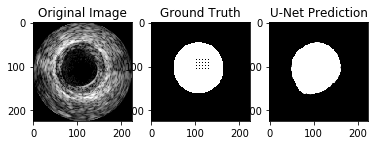





92
The intersection area is 9839
The     union    area is 10533
Calculated Jaccard Measure is 0.9341118389822463
DICE Coefficient :  0.9659336344001571


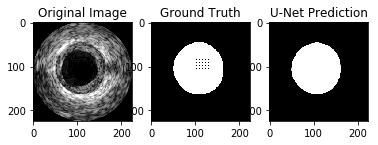





93
The intersection area is 9908
The     union    area is 10654
Calculated Jaccard Measure is 0.9299793504786934
DICE Coefficient :  0.9637194825406089


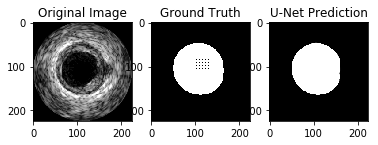





94
The intersection area is 9973
The     union    area is 10638
Calculated Jaccard Measure is 0.9374882496709908
DICE Coefficient :  0.9677356751249333


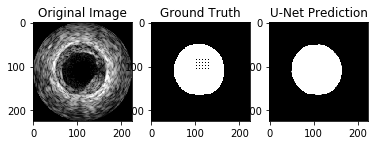





95
The intersection area is 9708
The     union    area is 10834
Calculated Jaccard Measure is 0.8960679342809673
DICE Coefficient :  0.9451854736637134


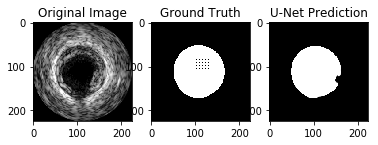





96
The intersection area is 9316
The     union    area is 10372
Calculated Jaccard Measure is 0.8981874276899344
DICE Coefficient :  0.9463632669646486


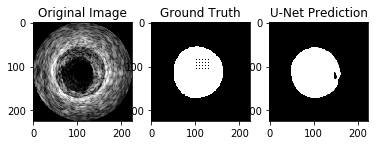





97
The intersection area is 9433
The     union    area is 10111
Calculated Jaccard Measure is 0.9329443180694293
DICE Coefficient :  0.965309046254605


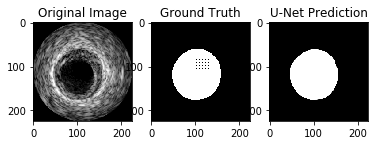





98
The intersection area is 9221
The     union    area is 9725
Calculated Jaccard Measure is 0.9481748071979434
DICE Coefficient :  0.973398078750132


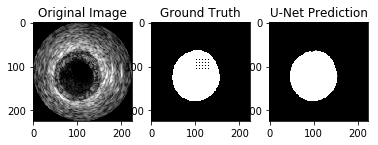





99
The intersection area is 9196
The     union    area is 9857
Calculated Jaccard Measure is 0.9329410571167698
DICE Coefficient :  0.9653073006875558


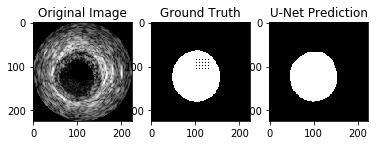





100
The intersection area is 9136
The     union    area is 9752
Calculated Jaccard Measure is 0.9368334700574241
DICE Coefficient :  0.9673867005506142


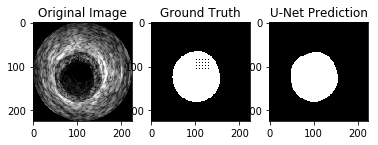





101
The intersection area is 8873
The     union    area is 9479
Calculated Jaccard Measure is 0.9360692056124064
DICE Coefficient :  0.9669790758500436


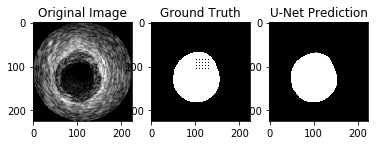





102
The intersection area is 8749
The     union    area is 9327
Calculated Jaccard Measure is 0.9380293770773025
DICE Coefficient :  0.9680238990927196


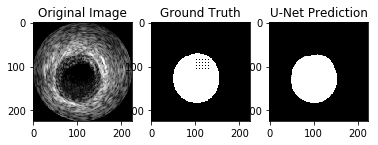





103
The intersection area is 8912
The     union    area is 9514
Calculated Jaccard Measure is 0.9367248265713685
DICE Coefficient :  0.9673287745576902


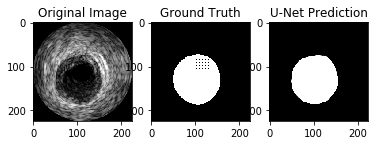





104
The intersection area is 9093
The     union    area is 9846
Calculated Jaccard Measure is 0.9235222425350396
DICE Coefficient :  0.9602407730080785


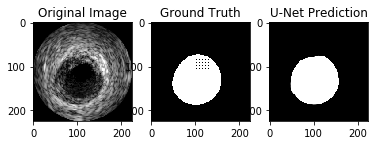





105
The intersection area is 9330
The     union    area is 10404
Calculated Jaccard Measure is 0.8967704728950404
DICE Coefficient :  0.9455761629674673


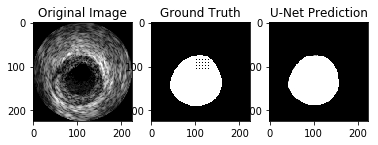





106
The intersection area is 9159
The     union    area is 10967
Calculated Jaccard Measure is 0.8351417890033738
DICE Coefficient :  0.9101659544867335


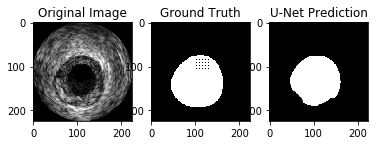





107
The intersection area is 9510
The     union    area is 10429
Calculated Jaccard Measure is 0.911880333684917
DICE Coefficient :  0.9539094237424144


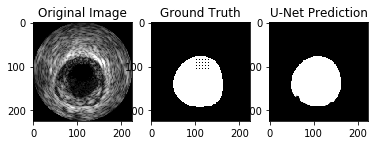





108
The intersection area is 9259
The     union    area is 10442
Calculated Jaccard Measure is 0.8867075272936219
DICE Coefficient :  0.939952286685955


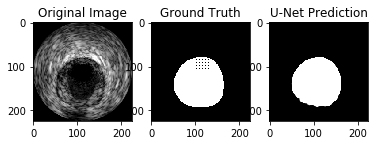





109
The intersection area is 9018
The     union    area is 12122
Calculated Jaccard Measure is 0.7439366441181323
DICE Coefficient :  0.8531693472090823


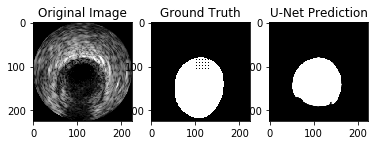





110
The intersection area is 9110
The     union    area is 11802
Calculated Jaccard Measure is 0.7719030672767327
DICE Coefficient :  0.8712700841622035


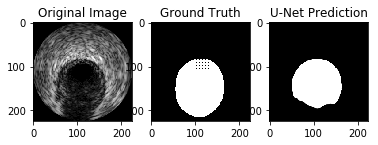





111
The intersection area is 8923
The     union    area is 11782
Calculated Jaccard Measure is 0.7573417076896961
DICE Coefficient :  0.8619174112533204


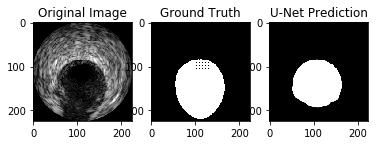





112
The intersection area is 8983
The     union    area is 11772
Calculated Jaccard Measure is 0.7630818892286783
DICE Coefficient :  0.8656227415080704


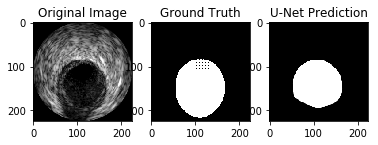





113
The intersection area is 8863
The     union    area is 11357
Calculated Jaccard Measure is 0.7803997534560183
DICE Coefficient :  0.8766567754698319


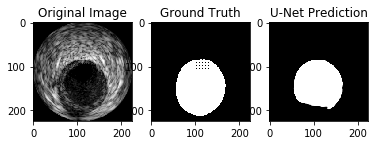





114
The intersection area is 9210
The     union    area is 11282
Calculated Jaccard Measure is 0.8163446197482715
DICE Coefficient :  0.8988873706812415


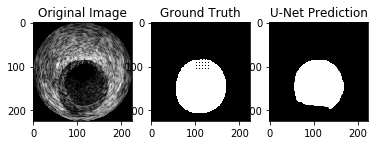





115
The intersection area is 9023
The     union    area is 10850
Calculated Jaccard Measure is 0.8316129032258065
DICE Coefficient :  0.9080662205001762


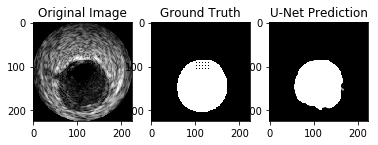





116
The intersection area is 9408
The     union    area is 10852
Calculated Jaccard Measure is 0.8669369701437523
DICE Coefficient :  0.9287265547877591


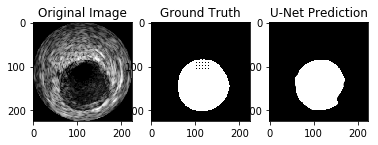





117
The intersection area is 9551
The     union    area is 10449
Calculated Jaccard Measure is 0.9140587616039813
DICE Coefficient :  0.9551


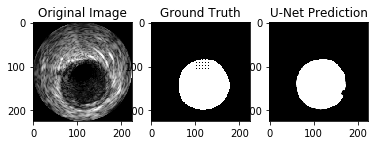





118
The intersection area is 9342
The     union    area is 10578
Calculated Jaccard Measure is 0.8831537152580828
DICE Coefficient :  0.9379518072289157


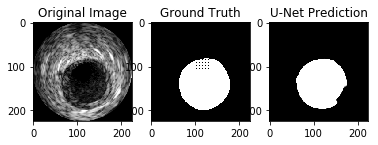





119
The intersection area is 9028
The     union    area is 10477
Calculated Jaccard Measure is 0.8616970506824473
DICE Coefficient :  0.9257113560625481


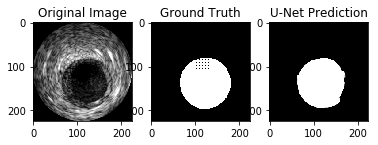





120
The intersection area is 9158
The     union    area is 10637
Calculated Jaccard Measure is 0.8609570367584846
DICE Coefficient :  0.9252841626673403


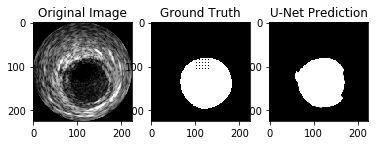





121
The intersection area is 4814
The     union    area is 5149
Calculated Jaccard Measure is 0.9349388230724412
DICE Coefficient :  0.9663755896818227


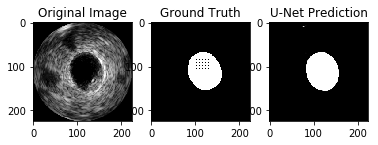





122
The intersection area is 4822
The     union    area is 5161
Calculated Jaccard Measure is 0.9343150552218562
DICE Coefficient :  0.9660422718621657


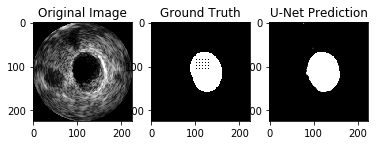





123
The intersection area is 4663
The     union    area is 5170
Calculated Jaccard Measure is 0.9019342359767891
DICE Coefficient :  0.9484389301332249


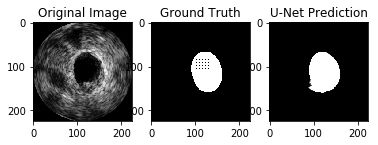





124
The intersection area is 4370
The     union    area is 5145
Calculated Jaccard Measure is 0.8493683187560739
DICE Coefficient :  0.9185496584340515


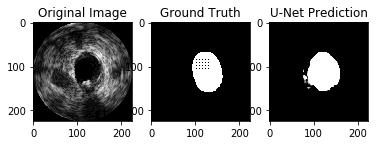





125
The intersection area is 4037
The     union    area is 5771
Calculated Jaccard Measure is 0.6995321434760007
DICE Coefficient :  0.8232055464926591


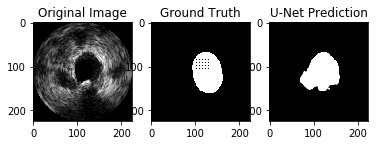





126
The intersection area is 4105
The     union    area is 5852
Calculated Jaccard Measure is 0.7014695830485305
DICE Coefficient :  0.8245455458471427


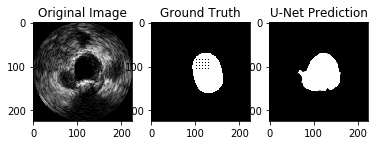





127
The intersection area is 2657
The     union    area is 5546
Calculated Jaccard Measure is 0.47908402452217813
DICE Coefficient :  0.6478117761794465


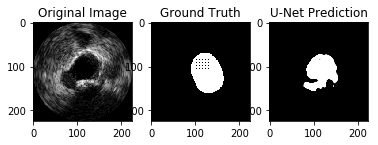





128
The intersection area is 749
The     union    area is 4862
Calculated Jaccard Measure is 0.15405183052241875
DICE Coefficient :  0.26697558367492424


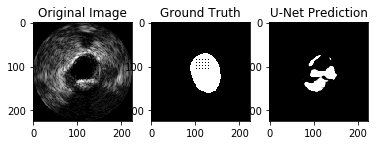





129
The intersection area is 545
The     union    area is 5197
Calculated Jaccard Measure is 0.10486819318837791
DICE Coefficient :  0.18982932776036224


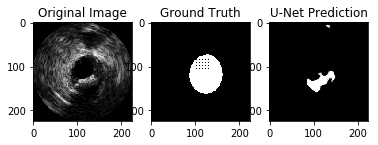





130
The intersection area is 2205
The     union    area is 5189
Calculated Jaccard Measure is 0.4249373675081904
DICE Coefficient :  0.5964295374628077


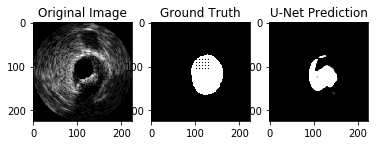





131
The intersection area is 3796
The     union    area is 5055
Calculated Jaccard Measure is 0.7509396636993076
DICE Coefficient :  0.8577561857417241


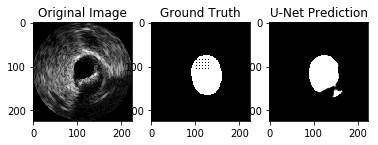





132
The intersection area is 2121
The     union    area is 5501
Calculated Jaccard Measure is 0.38556626067987637
DICE Coefficient :  0.5565468381002362


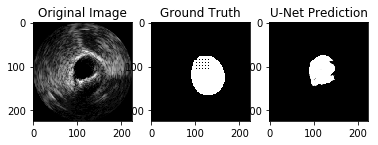





133
The intersection area is 1963
The     union    area is 5267
Calculated Jaccard Measure is 0.3726979305107272
DICE Coefficient :  0.543015214384509


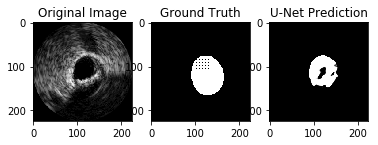





134
The intersection area is 2629
The     union    area is 5342
Calculated Jaccard Measure is 0.49213777611381504
DICE Coefficient :  0.6596411993476352


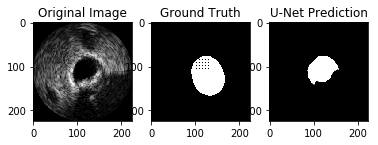





135
The intersection area is 3636
The     union    area is 5366
Calculated Jaccard Measure is 0.6775997018263138
DICE Coefficient :  0.8078204843368141


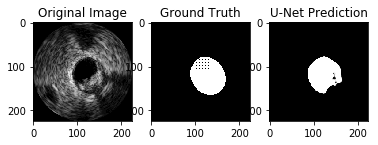





136
The intersection area is 4361
The     union    area is 5258
Calculated Jaccard Measure is 0.8294028147584633
DICE Coefficient :  0.9067470631042728


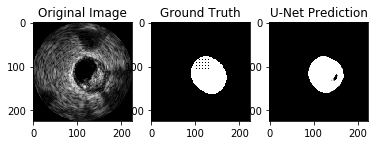





137
The intersection area is 4178
The     union    area is 5356
Calculated Jaccard Measure is 0.7800597460791635
DICE Coefficient :  0.8764422068386826


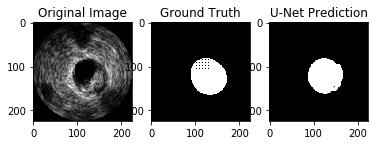





138
The intersection area is 3748
The     union    area is 5352
Calculated Jaccard Measure is 0.7002989536621823
DICE Coefficient :  0.8237362637362637


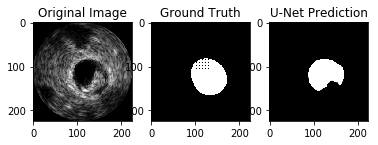





139
The intersection area is 3746
The     union    area is 5359
Calculated Jaccard Measure is 0.6990110095167009
DICE Coefficient :  0.8228445908841296


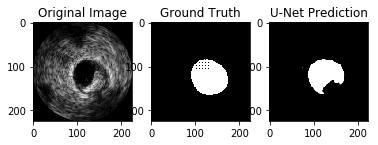





140
The intersection area is 4265
The     union    area is 5168
Calculated Jaccard Measure is 0.8252708978328174
DICE Coefficient :  0.9042722357680484


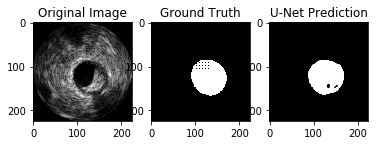





141
The intersection area is 3994
The     union    area is 5151
Calculated Jaccard Measure is 0.7753834206950107
DICE Coefficient :  0.8734827774740295


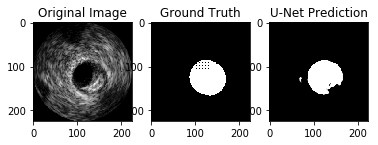





142
The intersection area is 4378
The     union    area is 5330
Calculated Jaccard Measure is 0.8213883677298311
DICE Coefficient :  0.9019365471775855


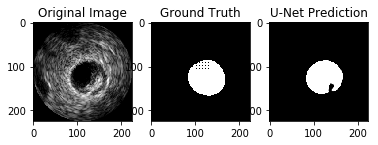





143
The intersection area is 4977
The     union    area is 5370
Calculated Jaccard Measure is 0.9268156424581006
DICE Coefficient :  0.9620179762249927


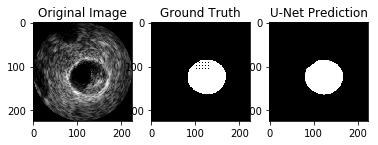





144
The intersection area is 5079
The     union    area is 5352
Calculated Jaccard Measure is 0.9489910313901345
DICE Coefficient :  0.9738280126545873


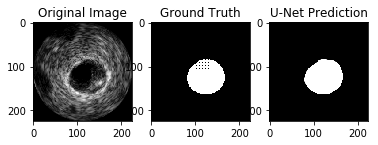





145
The intersection area is 5129
The     union    area is 5892
Calculated Jaccard Measure is 0.8705023761031908
DICE Coefficient :  0.9307685328010162


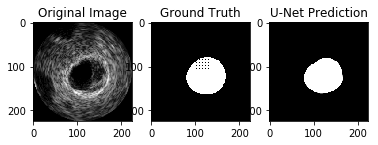





146
The intersection area is 5241
The     union    area is 5668
Calculated Jaccard Measure is 0.9246647847565279
DICE Coefficient :  0.9608580071500595


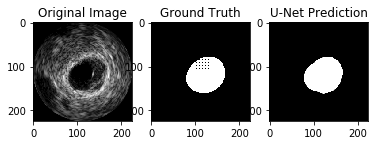





147
The intersection area is 5343
The     union    area is 5709
Calculated Jaccard Measure is 0.9358906988964792
DICE Coefficient :  0.9668838219326819


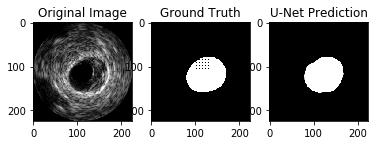





148
The intersection area is 5188
The     union    area is 5699
Calculated Jaccard Measure is 0.9103351465169328
DICE Coefficient :  0.9530632864884725


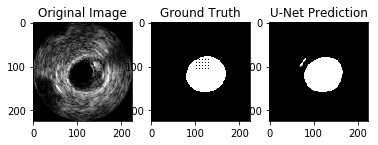





149
The intersection area is 4942
The     union    area is 5596
Calculated Jaccard Measure is 0.8831308077197999
DICE Coefficient :  0.9379388878345037


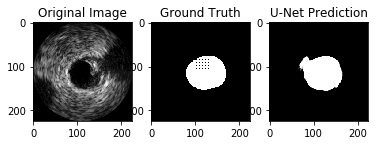





150
The intersection area is 4977
The     union    area is 5717
Calculated Jaccard Measure is 0.8705614832954347
DICE Coefficient :  0.9308023190574154


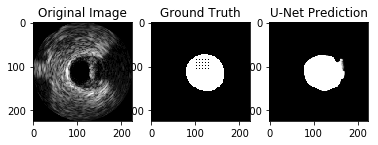





151
The intersection area is 4541
The     union    area is 5446
Calculated Jaccard Measure is 0.8338229893499817
DICE Coefficient :  0.9093821968559127


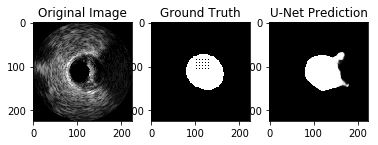





152
The intersection area is 3389
The     union    area is 5596
Calculated Jaccard Measure is 0.6056111508220158
DICE Coefficient :  0.7543683917640512


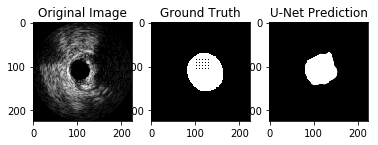





153
The intersection area is 1268
The     union    area is 5812
Calculated Jaccard Measure is 0.21816930488644184
DICE Coefficient :  0.3581920903954802


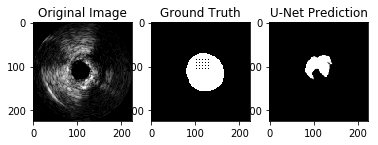





154
The intersection area is 1178
The     union    area is 6150
Calculated Jaccard Measure is 0.19154471544715448
DICE Coefficient :  0.3215065502183406


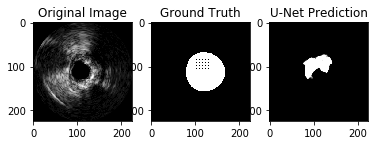





155
The intersection area is 106
The     union    area is 6615
Calculated Jaccard Measure is 0.01602418745275888
DICE Coefficient :  0.03154292515994644


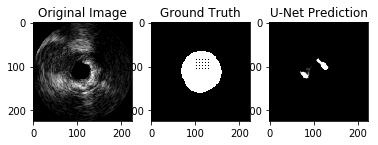





156
The intersection area is 7118
The     union    area is 8069
Calculated Jaccard Measure is 0.8821415293097038
DICE Coefficient :  0.9373806545071443


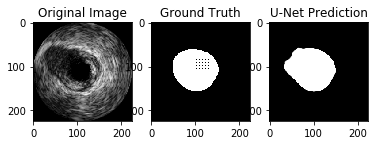





157
The intersection area is 6859
The     union    area is 7968
Calculated Jaccard Measure is 0.8608182730923695
DICE Coefficient :  0.9252040196938018


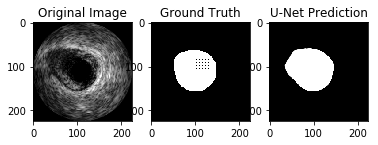





158
The intersection area is 7187
The     union    area is 8130
Calculated Jaccard Measure is 0.884009840098401
DICE Coefficient :  0.9384344192727035


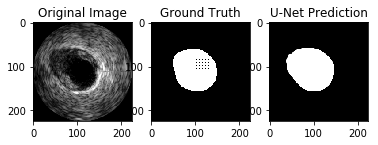





159
The intersection area is 7259
The     union    area is 8166
Calculated Jaccard Measure is 0.8889297085476365
DICE Coefficient :  0.9411993517017828


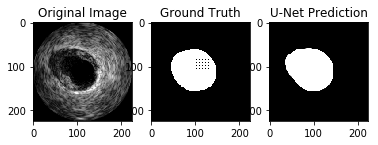





160
The intersection area is 7546
The     union    area is 8147
Calculated Jaccard Measure is 0.9262305142997422
DICE Coefficient :  0.961702669980246


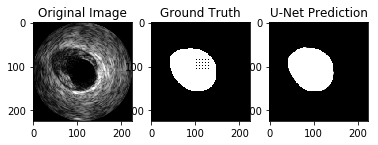





161
The intersection area is 7586
The     union    area is 8103
Calculated Jaccard Measure is 0.9361964704430458
DICE Coefficient :  0.9670469755879916


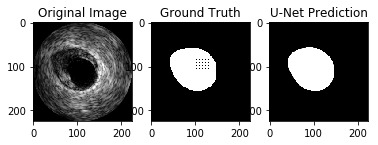





162
The intersection area is 7450
The     union    area is 7992
Calculated Jaccard Measure is 0.9321821821821822
DICE Coefficient :  0.9649009195700039


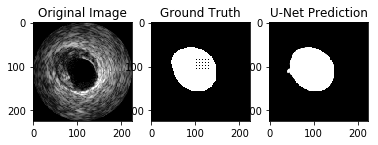





163
The intersection area is 6888
The     union    area is 7360
Calculated Jaccard Measure is 0.9358695652173913
DICE Coefficient :  0.9668725435148793


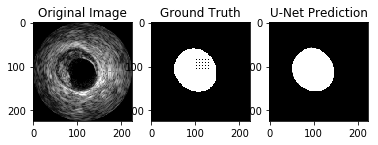





164
The intersection area is 6614
The     union    area is 7248
Calculated Jaccard Measure is 0.9125275938189845
DICE Coefficient :  0.954263454047035


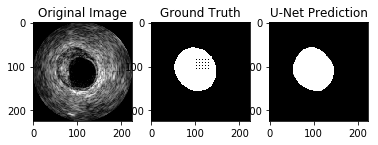





165
The intersection area is 6203
The     union    area is 7090
Calculated Jaccard Measure is 0.8748942172073343
DICE Coefficient :  0.93327315128263


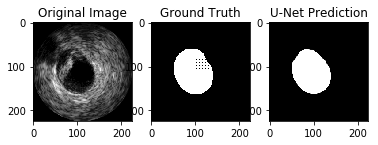





166
The intersection area is 5710
The     union    area is 7373
Calculated Jaccard Measure is 0.7744473077444731
DICE Coefficient :  0.8728884812351907


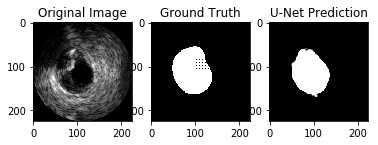





167
The intersection area is 5872
The     union    area is 7005
Calculated Jaccard Measure is 0.8382583868665239
DICE Coefficient :  0.9120136677797623


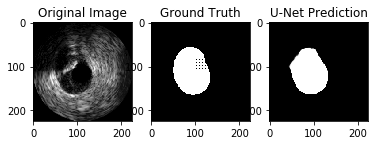





168
The intersection area is 5883
The     union    area is 7192
Calculated Jaccard Measure is 0.817992213570634
DICE Coefficient :  0.8998852772466539


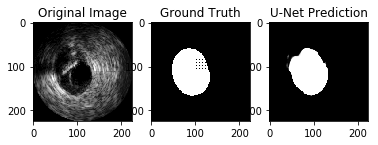





169
The intersection area is 6217
The     union    area is 7430
Calculated Jaccard Measure is 0.836742934051144
DICE Coefficient :  0.9111159961896388


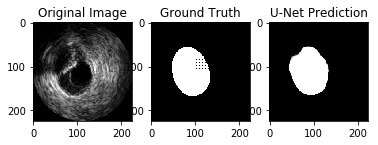





170
The intersection area is 5991
The     union    area is 7111
Calculated Jaccard Measure is 0.8424975390240472
DICE Coefficient :  0.9145168676537934


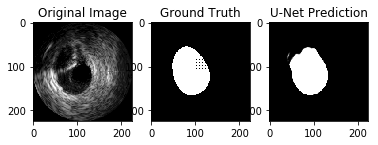





171
The intersection area is 3462
The     union    area is 4713
Calculated Jaccard Measure is 0.7345639719923616
DICE Coefficient :  0.8469724770642202


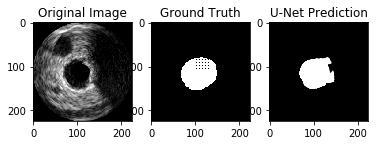





172
The intersection area is 3869
The     union    area is 5043
Calculated Jaccard Measure is 0.767202062264525
DICE Coefficient :  0.8682675044883303


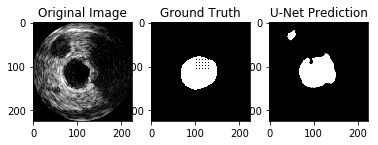





173
The intersection area is 4363
The     union    area is 4877
Calculated Jaccard Measure is 0.8946073405782243
DICE Coefficient :  0.9443722943722944


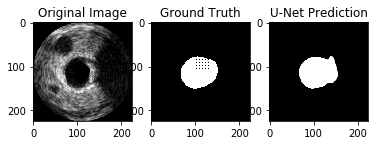





174
The intersection area is 3916
The     union    area is 4937
Calculated Jaccard Measure is 0.7931942475187361
DICE Coefficient :  0.884671862645431


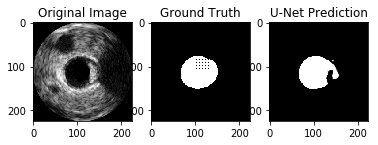





175
The intersection area is 4241
The     union    area is 5150
Calculated Jaccard Measure is 0.823495145631068
DICE Coefficient :  0.9032051964647002


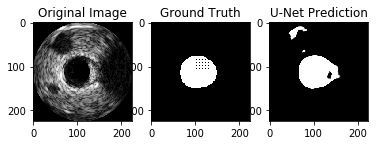





176
The intersection area is 4860
The     union    area is 5155
Calculated Jaccard Measure is 0.9427740058195926
DICE Coefficient :  0.9705441837244134


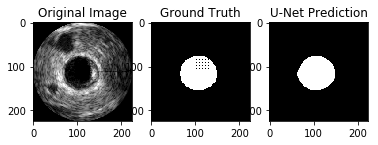





177
The intersection area is 5006
The     union    area is 5389
Calculated Jaccard Measure is 0.9289293004267953
DICE Coefficient :  0.9631553631553632


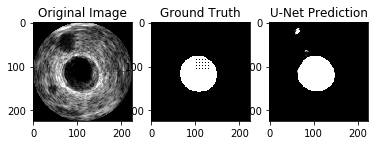





178
The intersection area is 5149
The     union    area is 5665
Calculated Jaccard Measure is 0.9089143865842895
DICE Coefficient :  0.9522840761975218


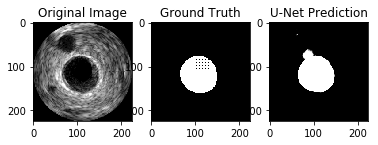





179
The intersection area is 5397
The     union    area is 5754
Calculated Jaccard Measure is 0.9379562043795621
DICE Coefficient :  0.967984934086629


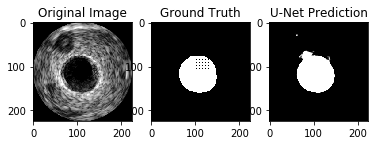





180
The intersection area is 5316
The     union    area is 5940
Calculated Jaccard Measure is 0.8949494949494949
DICE Coefficient :  0.9445628997867804


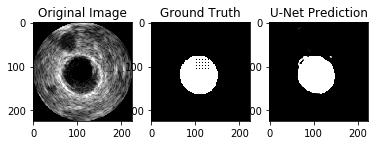





181
The intersection area is 5342
The     union    area is 5922
Calculated Jaccard Measure is 0.9020601148260723
DICE Coefficient :  0.9485085227272727


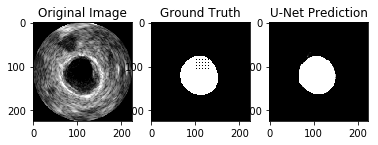





182
The intersection area is 5420
The     union    area is 5884
Calculated Jaccard Measure is 0.9211420802175391
DICE Coefficient :  0.9589525831564049


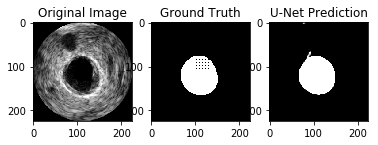





183
The intersection area is 5315
The     union    area is 5837
Calculated Jaccard Measure is 0.9105704985437725
DICE Coefficient :  0.9531922525107605


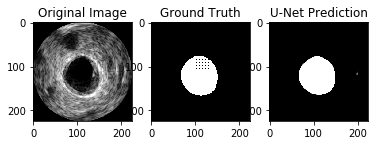





184
The intersection area is 5219
The     union    area is 5723
Calculated Jaccard Measure is 0.9119343001922069
DICE Coefficient :  0.9539389508316578


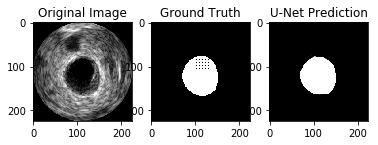





185
The intersection area is 5226
The     union    area is 5718
Calculated Jaccard Measure is 0.9139559286463799
DICE Coefficient :  0.9550438596491229


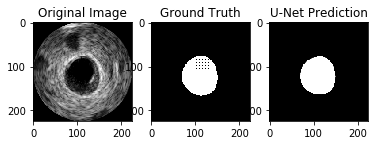





186
The intersection area is 4849
The     union    area is 5486
Calculated Jaccard Measure is 0.8838862559241706
DICE Coefficient :  0.9383647798742139


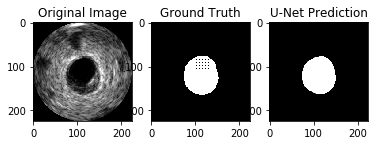





187
The intersection area is 4606
The     union    area is 5108
Calculated Jaccard Measure is 0.9017227877838685
DICE Coefficient :  0.9483220094708668


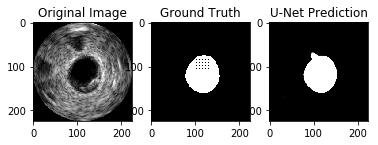





188
The intersection area is 4475
The     union    area is 4963
Calculated Jaccard Measure is 0.9016723755792867
DICE Coefficient :  0.9482941301123119


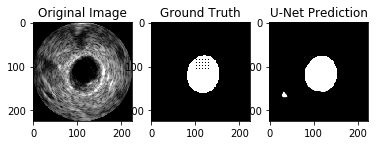





189
The intersection area is 4626
The     union    area is 4987
Calculated Jaccard Measure is 0.9276117906557049
DICE Coefficient :  0.962446686778321


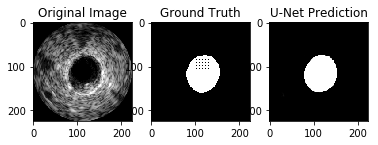





190
The intersection area is 4584
The     union    area is 4901
Calculated Jaccard Measure is 0.935319322587227
DICE Coefficient :  0.9665788086452293


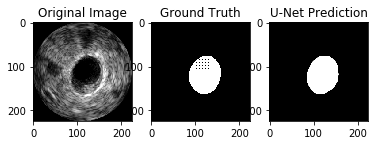





191
The intersection area is 4451
The     union    area is 4930
Calculated Jaccard Measure is 0.9028397565922921
DICE Coefficient :  0.9489393454855559


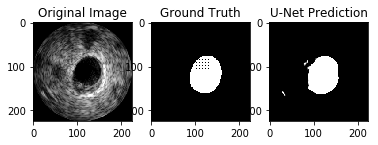





192
The intersection area is 4455
The     union    area is 5177
Calculated Jaccard Measure is 0.8605369905350589
DICE Coefficient :  0.9250415282392026


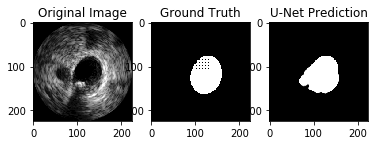





193
The intersection area is 4623
The     union    area is 5758
Calculated Jaccard Measure is 0.8028829454671761
DICE Coefficient :  0.8906656391484443


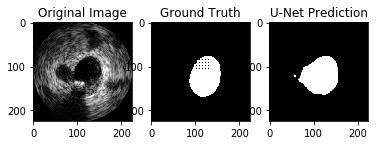





194
The intersection area is 4775
The     union    area is 6352
Calculated Jaccard Measure is 0.7517317380352645
DICE Coefficient :  0.8582726700817831


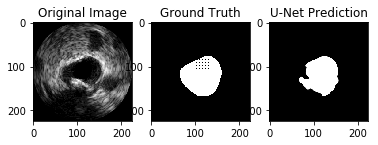





195
The intersection area is 1534
The     union    area is 6219
Calculated Jaccard Measure is 0.24666345071554913
DICE Coefficient :  0.39571778666322716


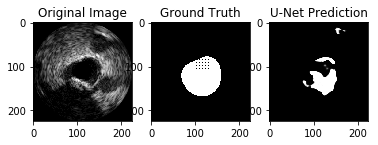





196
The intersection area is 865
The     union    area is 5785
Calculated Jaccard Measure is 0.1495246326707001
DICE Coefficient :  0.26015037593984963


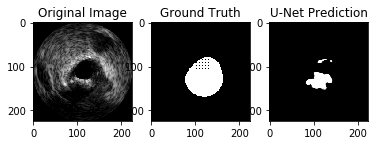





197
The intersection area is 935
The     union    area is 5362
Calculated Jaccard Measure is 0.17437523312196943
DICE Coefficient :  0.29696680959186916


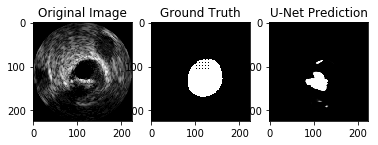





198
The intersection area is 1661
The     union    area is 5248
Calculated Jaccard Measure is 0.3165015243902439
DICE Coefficient :  0.48082211608047476


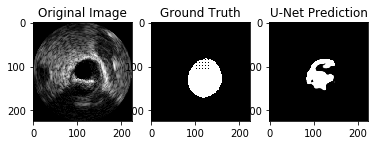





199
The intersection area is 1001
The     union    area is 5136
Calculated Jaccard Measure is 0.19489875389408098
DICE Coefficient :  0.32621802183477266


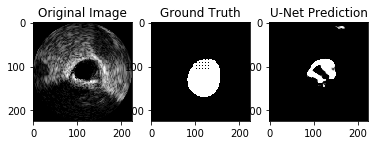





200
The intersection area is 2624
The     union    area is 5165
Calculated Jaccard Measure is 0.5080348499515973
DICE Coefficient :  0.6737707022724355


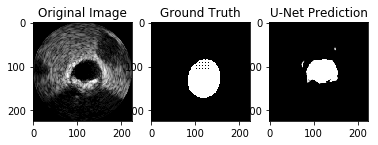





201
The intersection area is 4040
The     union    area is 5094
Calculated Jaccard Measure is 0.7930899096976836
DICE Coefficient :  0.8846069629954018


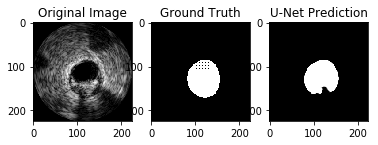





202
The intersection area is 4584
The     union    area is 5311
Calculated Jaccard Measure is 0.863114291093956
DICE Coefficient :  0.9265285497726125


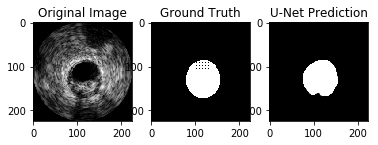





203
The intersection area is 4690
The     union    area is 5024
Calculated Jaccard Measure is 0.9335191082802548
DICE Coefficient :  0.9656166357834054


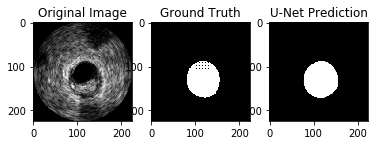





204
The intersection area is 4714
The     union    area is 4979
Calculated Jaccard Measure is 0.9467764611367745
DICE Coefficient :  0.9726606829670896


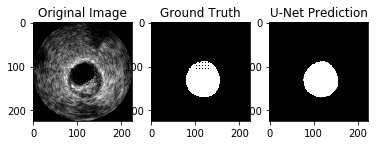





205
The intersection area is 4522
The     union    area is 4838
Calculated Jaccard Measure is 0.9346837536171972
DICE Coefficient :  0.9662393162393162


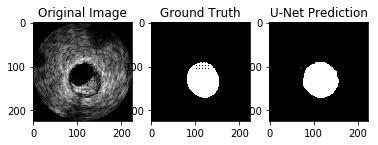





206
The intersection area is 4615
The     union    area is 4857
Calculated Jaccard Measure is 0.9501750051472102
DICE Coefficient :  0.9744510135135135


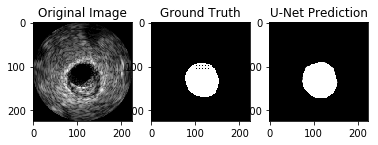





207
The intersection area is 4722
The     union    area is 5017
Calculated Jaccard Measure is 0.9411999202710783
DICE Coefficient :  0.9697094157511038


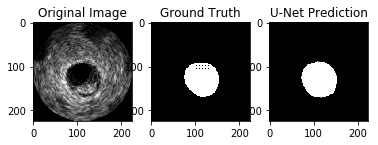





208
The intersection area is 4899
The     union    area is 5091
Calculated Jaccard Measure is 0.9622863877430761
DICE Coefficient :  0.9807807807807808


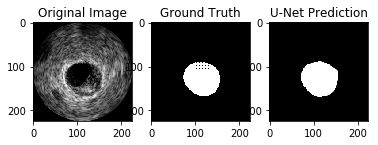





209
The intersection area is 4848
The     union    area is 5234
Calculated Jaccard Measure is 0.9262514329384792
DICE Coefficient :  0.9617139456457052


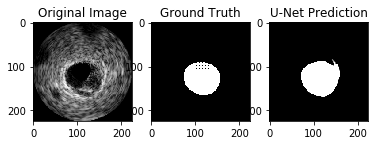





210
The intersection area is 4948
The     union    area is 5303
Calculated Jaccard Measure is 0.9330567603243447
DICE Coefficient :  0.9653692322700225


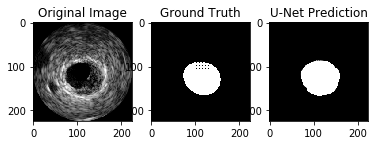





211
The intersection area is 4970
The     union    area is 5273
Calculated Jaccard Measure is 0.9425374549592263
DICE Coefficient :  0.9704188226105633


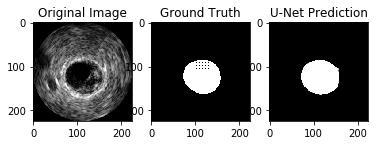





212
The intersection area is 5085
The     union    area is 5630
Calculated Jaccard Measure is 0.9031971580817052
DICE Coefficient :  0.9491367242183855


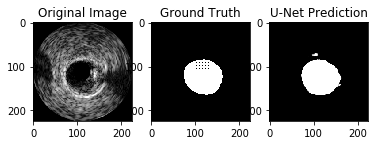





213
The intersection area is 5067
The     union    area is 5408
Calculated Jaccard Measure is 0.9369452662721893
DICE Coefficient :  0.9674463007159905


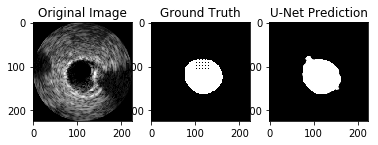





214
The intersection area is 4844
The     union    area is 5596
Calculated Jaccard Measure is 0.8656182987848463
DICE Coefficient :  0.9279693486590038


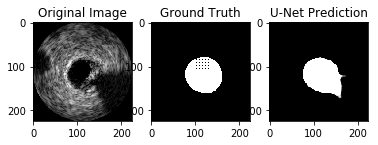





215
The intersection area is 4738
The     union    area is 5938
Calculated Jaccard Measure is 0.7979117547995959
DICE Coefficient :  0.8875983514424878


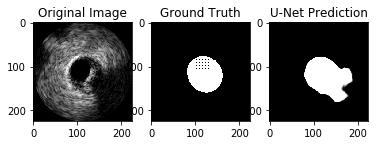





216
The intersection area is 3844
The     union    area is 5506
Calculated Jaccard Measure is 0.6981474754812932
DICE Coefficient :  0.8222459893048129


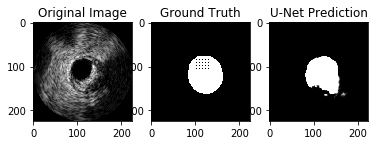





217
The intersection area is 2961
The     union    area is 5544
Calculated Jaccard Measure is 0.5340909090909091
DICE Coefficient :  0.6962962962962963


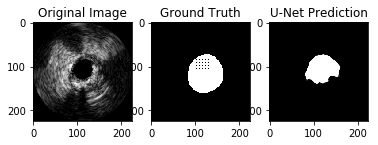





218
The intersection area is 1259
The     union    area is 6276
Calculated Jaccard Measure is 0.20060548119821542
DICE Coefficient :  0.33417385534173855


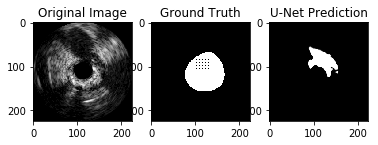





219
The intersection area is 4943
The     union    area is 7466
Calculated Jaccard Measure is 0.6620680417894454
DICE Coefficient :  0.7966798291562576


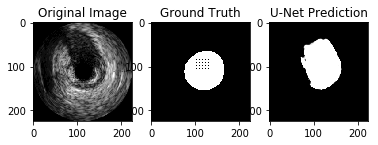





220
The intersection area is 6831
The     union    area is 7943
Calculated Jaccard Measure is 0.8600025179403248
DICE Coefficient :  0.9247326384188439


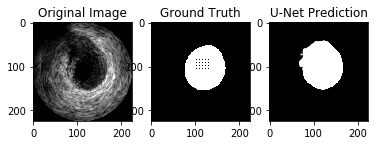





221
The intersection area is 8923
The     union    area is 14262
Calculated Jaccard Measure is 0.6256485766372177
DICE Coefficient :  0.7697218028897994


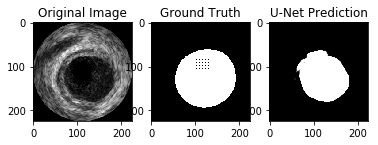





222
The intersection area is 8336
The     union    area is 14976
Calculated Jaccard Measure is 0.5566239316239316
DICE Coefficient :  0.7151681537405628


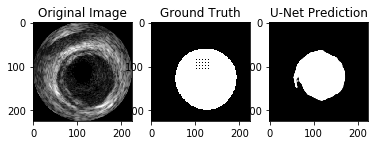





223
The intersection area is 7872
The     union    area is 15378
Calculated Jaccard Measure is 0.5119001170503317
DICE Coefficient :  0.6771612903225807


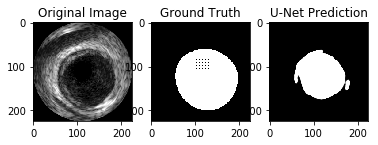





224
The intersection area is 8220
The     union    area is 15191
Calculated Jaccard Measure is 0.5411098676848134
DICE Coefficient :  0.7022339925675964


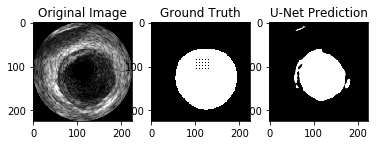





225
The intersection area is 7790
The     union    area is 15105
Calculated Jaccard Measure is 0.5157232704402516
DICE Coefficient :  0.6804979253112033


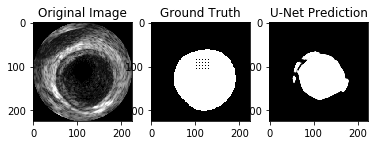





226
The intersection area is 8711
The     union    area is 15437
Calculated Jaccard Measure is 0.564293580358878
DICE Coefficient :  0.7214676163657445


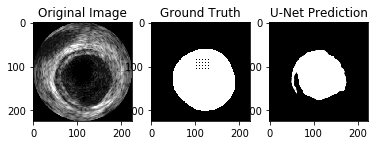





227
The intersection area is 7853
The     union    area is 15515
Calculated Jaccard Measure is 0.5061553335481792
DICE Coefficient :  0.672115713796645


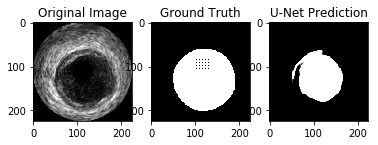





228
The intersection area is 7407
The     union    area is 14887
Calculated Jaccard Measure is 0.49754819641297776
DICE Coefficient :  0.6644837175921773


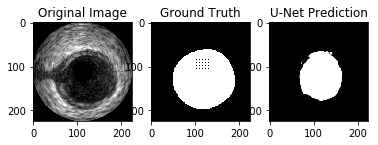





229
The intersection area is 9534
The     union    area is 12747
Calculated Jaccard Measure is 0.7479406919275123
DICE Coefficient :  0.8557964184731386


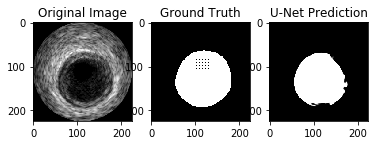





230
The intersection area is 9799
The     union    area is 11726
Calculated Jaccard Measure is 0.8356643356643356
DICE Coefficient :  0.9104761904761904


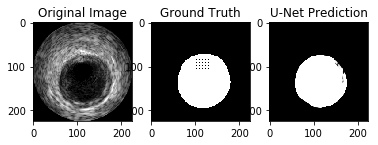





231
The intersection area is 9094
The     union    area is 11059
Calculated Jaccard Measure is 0.8223166651595986
DICE Coefficient :  0.9024959063166774


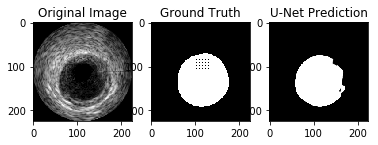





232
The intersection area is 9011
The     union    area is 10983
Calculated Jaccard Measure is 0.82044978603296
DICE Coefficient :  0.901370411123337


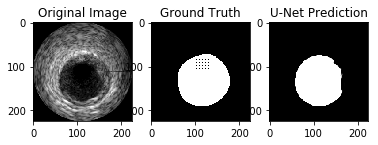





233
The intersection area is 9716
The     union    area is 10975
Calculated Jaccard Measure is 0.8852847380410023
DICE Coefficient :  0.9391522884345851


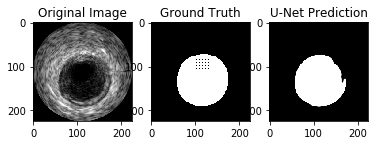





234
The intersection area is 9606
The     union    area is 10242
Calculated Jaccard Measure is 0.9379027533684827
DICE Coefficient :  0.967956469165659


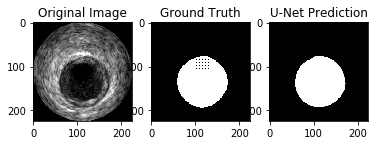





235
The intersection area is 8126
The     union    area is 9635
Calculated Jaccard Measure is 0.8433834976647638
DICE Coefficient :  0.915038567648218


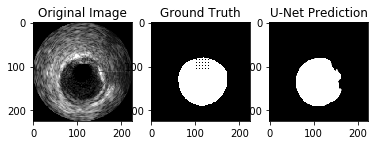





236
The intersection area is 8538
The     union    area is 9444
Calculated Jaccard Measure is 0.9040660736975857
DICE Coefficient :  0.9496162829496163


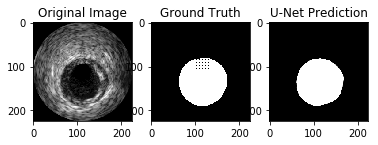





237
The intersection area is 8707
The     union    area is 9315
Calculated Jaccard Measure is 0.9347289318303811
DICE Coefficient :  0.9662634557762735


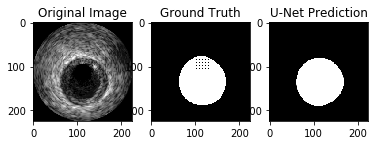





238
The intersection area is 8459
The     union    area is 9114
Calculated Jaccard Measure is 0.9281325433399166
DICE Coefficient :  0.962726910601491


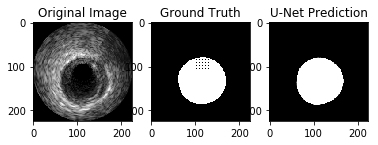





239
The intersection area is 8417
The     union    area is 8945
Calculated Jaccard Measure is 0.9409726103968697
DICE Coefficient :  0.9695887570556387


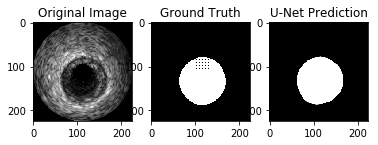





240
The intersection area is 8236
The     union    area is 8829
Calculated Jaccard Measure is 0.9328349756484313
DICE Coefficient :  0.9652505127453853


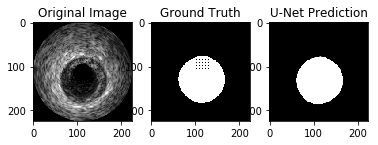





241
The intersection area is 8210
The     union    area is 8813
Calculated Jaccard Measure is 0.9315783501645297
DICE Coefficient :  0.9645773365446748


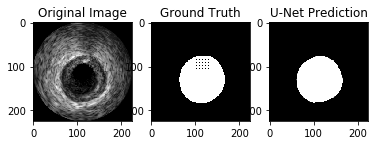





242
The intersection area is 8226
The     union    area is 8888
Calculated Jaccard Measure is 0.9255175517551755
DICE Coefficient :  0.9613182190019867


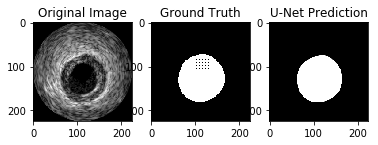





243
The intersection area is 7286
The     union    area is 8965
Calculated Jaccard Measure is 0.8127161182375906
DICE Coefficient :  0.8966832810288597


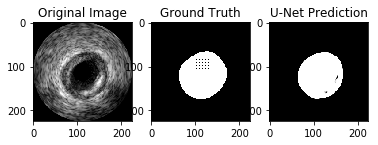





244
The intersection area is 8377
The     union    area is 9726
Calculated Jaccard Measure is 0.8612996092946741
DICE Coefficient :  0.9254819643153068


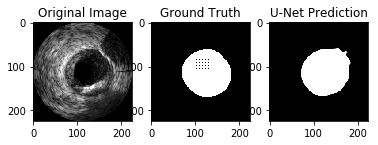





245
The intersection area is 8426
The     union    area is 9607
Calculated Jaccard Measure is 0.8770688039970854
DICE Coefficient :  0.9345089558032496


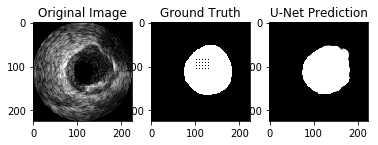





246
The intersection area is 8431
The     union    area is 11507
Calculated Jaccard Measure is 0.7326844529416877
DICE Coefficient :  0.8457217373858963


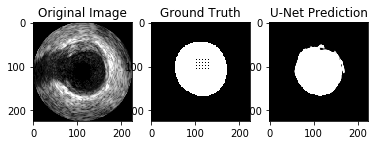





247
The intersection area is 8396
The     union    area is 11602
Calculated Jaccard Measure is 0.7236683330460265
DICE Coefficient :  0.8396839683968397


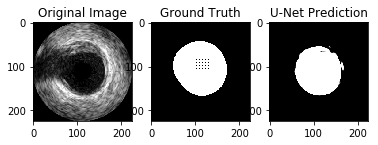





248
The intersection area is 7898
The     union    area is 12300
Calculated Jaccard Measure is 0.6421138211382114
DICE Coefficient :  0.7820576294682642


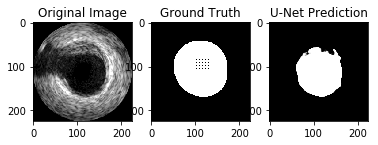





249
The intersection area is 7733
The     union    area is 12425
Calculated Jaccard Measure is 0.622374245472837
DICE Coefficient :  0.7672388133743427


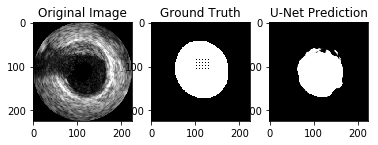





250
The intersection area is 8103
The     union    area is 11804
Calculated Jaccard Measure is 0.686462216197899
DICE Coefficient :  0.8140854975636711


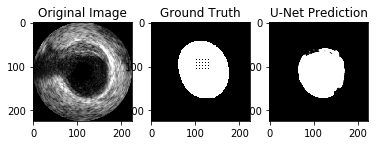





251
The intersection area is 7976
The     union    area is 11677
Calculated Jaccard Measure is 0.6830521538066284
DICE Coefficient :  0.8116826947539816


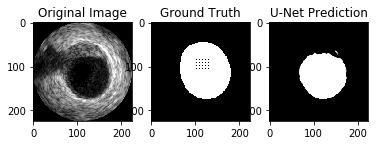





252
The intersection area is 8431
The     union    area is 10941
Calculated Jaccard Measure is 0.7705876976510374
DICE Coefficient :  0.87043155069172


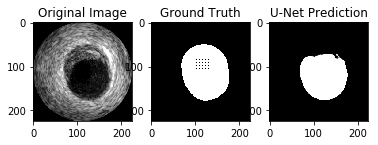





253
The intersection area is 8287
The     union    area is 11282
Calculated Jaccard Measure is 0.7345328842403829
DICE Coefficient :  0.8469518115386581


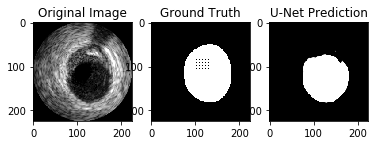





254
The intersection area is 8357
The     union    area is 11349
Calculated Jaccard Measure is 0.7363644373953653
DICE Coefficient :  0.8481680706383843


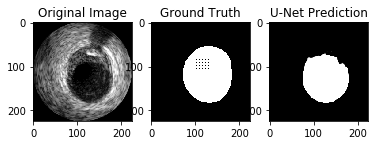





255
The intersection area is 8593
The     union    area is 11192
Calculated Jaccard Measure is 0.7677805575411007
DICE Coefficient :  0.8686378569623452


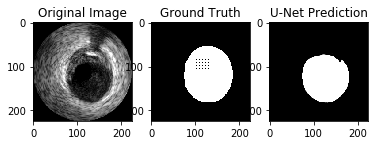





256
The intersection area is 8479
The     union    area is 11002
Calculated Jaccard Measure is 0.7706780585348119
DICE Coefficient :  0.8704891945998665


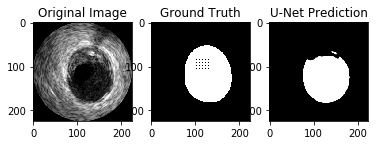





257
The intersection area is 8097
The     union    area is 10844
Calculated Jaccard Measure is 0.7466801918111398
DICE Coefficient :  0.8549706984847685


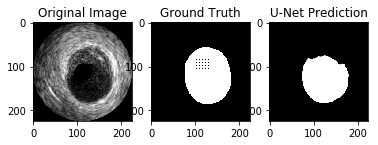





258
The intersection area is 8443
The     union    area is 10897
Calculated Jaccard Measure is 0.7748004037808571
DICE Coefficient :  0.8731127197518097


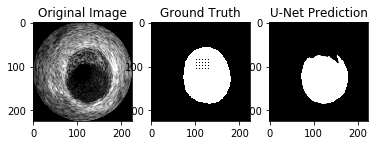





259
The intersection area is 8384
The     union    area is 11092
Calculated Jaccard Measure is 0.7558600793364587
DICE Coefficient :  0.8609570753748202


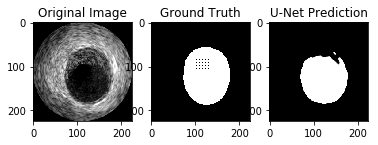





260
The intersection area is 8759
The     union    area is 11764
Calculated Jaccard Measure is 0.7445596735804149
DICE Coefficient :  0.8535789114651854


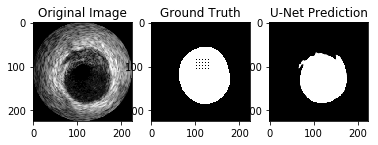





261
The intersection area is 8446
The     union    area is 11230
Calculated Jaccard Measure is 0.752092609082814
DICE Coefficient :  0.8585078267940638


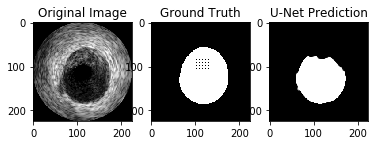





262
The intersection area is 8599
The     union    area is 11015
Calculated Jaccard Measure is 0.7806627326373128
DICE Coefficient :  0.8768226776792087


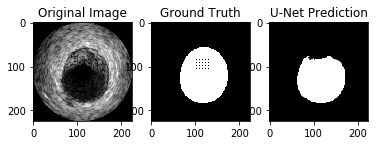





263
The intersection area is 8260
The     union    area is 11067
Calculated Jaccard Measure is 0.7463630613535737
DICE Coefficient :  0.8547627671133647


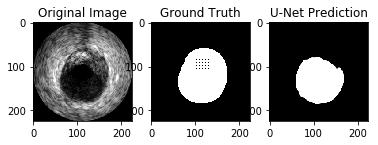





264
The intersection area is 8158
The     union    area is 11159
Calculated Jaccard Measure is 0.7310690922125639
DICE Coefficient :  0.8446446135528292


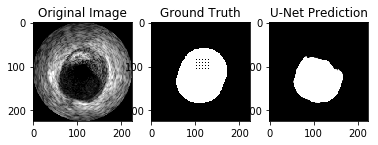





265
The intersection area is 8260
The     union    area is 11333
Calculated Jaccard Measure is 0.7288449660284126
DICE Coefficient :  0.8431582708110039


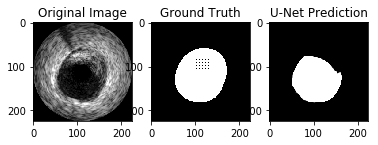





266
The intersection area is 7758
The     union    area is 10909
Calculated Jaccard Measure is 0.7111559262993858
DICE Coefficient :  0.8311994428670917


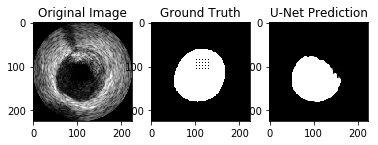





267
The intersection area is 7764
The     union    area is 11209
Calculated Jaccard Measure is 0.6926576857882059
DICE Coefficient :  0.8184261845780847


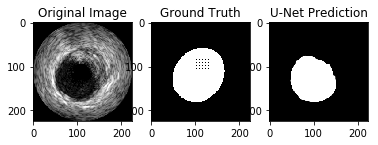





268
The intersection area is 7718
The     union    area is 11532
Calculated Jaccard Measure is 0.6692681234824835
DICE Coefficient :  0.8018701298701298


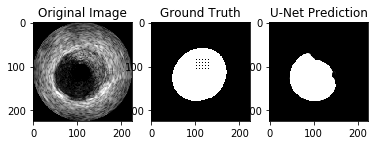





269
The intersection area is 7738
The     union    area is 11488
Calculated Jaccard Measure is 0.6735724233983287
DICE Coefficient :  0.804951628003745


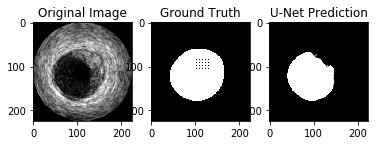





270
The intersection area is 7850
The     union    area is 11304
Calculated Jaccard Measure is 0.6944444444444444
DICE Coefficient :  0.819672131147541


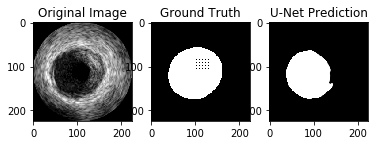





271
The intersection area is 8239
The     union    area is 11327
Calculated Jaccard Measure is 0.727377063653218
DICE Coefficient :  0.8421752018808136


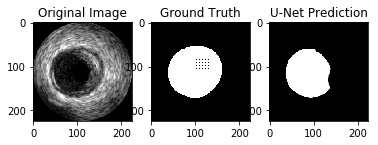





272
The intersection area is 8524
The     union    area is 11568
Calculated Jaccard Measure is 0.7368603042876902
DICE Coefficient :  0.8484969141947044


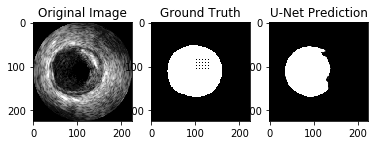





273
The intersection area is 8949
The     union    area is 11578
Calculated Jaccard Measure is 0.7729314216617723
DICE Coefficient :  0.8719247819944463


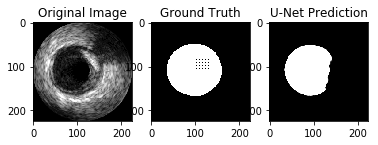





274
The intersection area is 9408
The     union    area is 11408
Calculated Jaccard Measure is 0.8246844319775596
DICE Coefficient :  0.9039200614911607


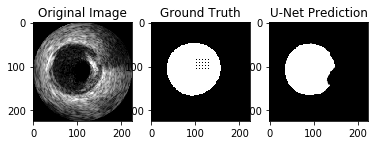





275
The intersection area is 9346
The     union    area is 11265
Calculated Jaccard Measure is 0.8296493564136707
DICE Coefficient :  0.9068943767890932


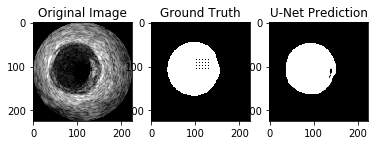





276
The intersection area is 9555
The     union    area is 10817
Calculated Jaccard Measure is 0.8833317925487658
DICE Coefficient :  0.9380522285489888


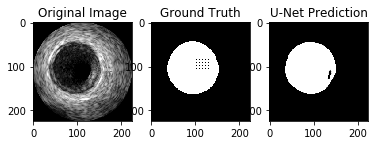





277
The intersection area is 9865
The     union    area is 11327
Calculated Jaccard Measure is 0.8709278714575792
DICE Coefficient :  0.9310117025292564


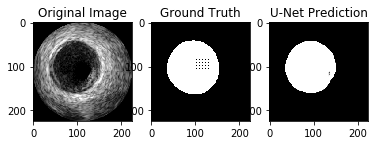





278
The intersection area is 9790
The     union    area is 10820
Calculated Jaccard Measure is 0.9048059149722736
DICE Coefficient :  0.9500242600679282


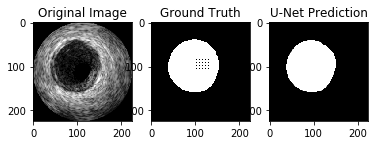





279
The intersection area is 9966
The     union    area is 11096
Calculated Jaccard Measure is 0.8981614996395098
DICE Coefficient :  0.9463488747507359


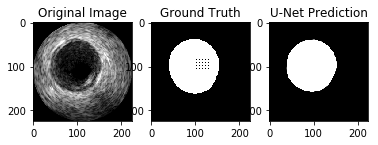





280
The intersection area is 9672
The     union    area is 11833
Calculated Jaccard Measure is 0.8173751373278121
DICE Coefficient :  0.8995117414554755


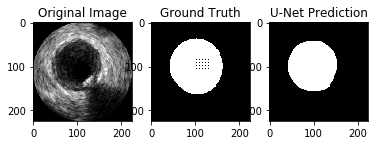





281
The intersection area is 9416
The     union    area is 10383
Calculated Jaccard Measure is 0.906866994125012
DICE Coefficient :  0.9511591494519925


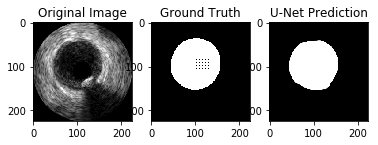





282
The intersection area is 9107
The     union    area is 10252
Calculated Jaccard Measure is 0.8883144752243465
DICE Coefficient :  0.9408543829743272


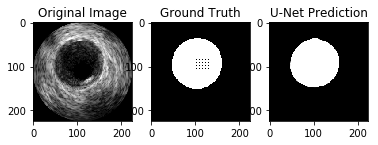





283
The intersection area is 8773
The     union    area is 9644
Calculated Jaccard Measure is 0.9096847781003733
DICE Coefficient :  0.9527067383395775


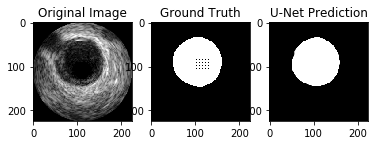





284
The intersection area is 8680
The     union    area is 9787
Calculated Jaccard Measure is 0.8868907734750179
DICE Coefficient :  0.9400552336600423


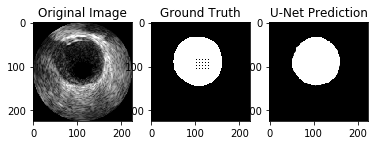





285
The intersection area is 8573
The     union    area is 9947
Calculated Jaccard Measure is 0.8618678998693073
DICE Coefficient :  0.9258099352051836


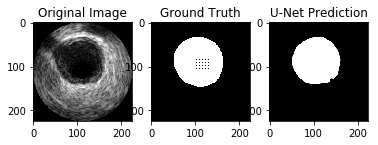





286
The intersection area is 8784
The     union    area is 10020
Calculated Jaccard Measure is 0.8766467065868263
DICE Coefficient :  0.9342693044033185


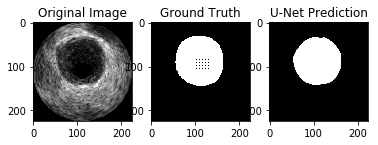





287
The intersection area is 8664
The     union    area is 9695
Calculated Jaccard Measure is 0.8936565239814337
DICE Coefficient :  0.9438422572035514


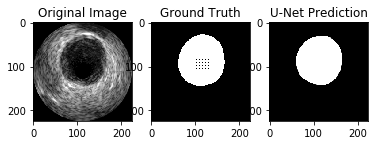





288
The intersection area is 8719
The     union    area is 10217
Calculated Jaccard Measure is 0.8533816188705099
DICE Coefficient :  0.9208914237431348


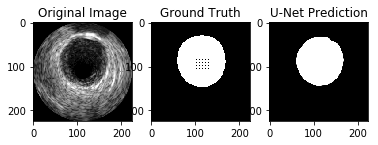





289
The intersection area is 8526
The     union    area is 9560
Calculated Jaccard Measure is 0.8918410041841004
DICE Coefficient :  0.9428287072874046


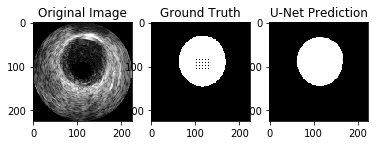





290
The intersection area is 8305
The     union    area is 9768
Calculated Jaccard Measure is 0.8502252252252253
DICE Coefficient :  0.9190505173463177


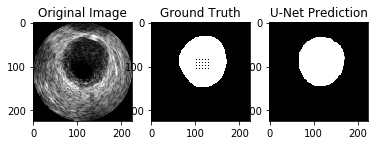





291
The intersection area is 8351
The     union    area is 9910
Calculated Jaccard Measure is 0.8426841574167507
DICE Coefficient :  0.9146268002847598


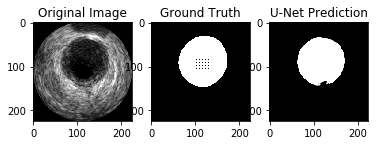





292
The intersection area is 8035
The     union    area is 9734
Calculated Jaccard Measure is 0.8254571604684611
DICE Coefficient :  0.9043840396195622


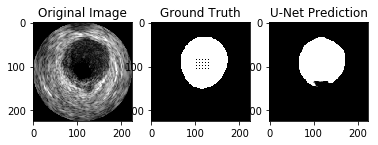





293
The intersection area is 8229
The     union    area is 9706
Calculated Jaccard Measure is 0.8478260869565217
DICE Coefficient :  0.9176470588235294


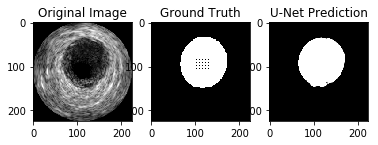





294
The intersection area is 8411
The     union    area is 9652
Calculated Jaccard Measure is 0.8714256112722751
DICE Coefficient :  0.9312960194873499


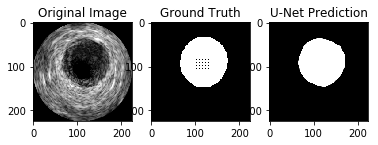





295
The intersection area is 8105
The     union    area is 10032
Calculated Jaccard Measure is 0.807914673046252
DICE Coefficient :  0.8937531013949386


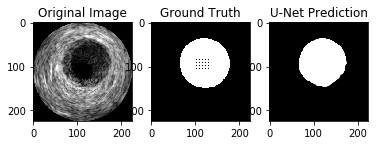





296
The intersection area is 5226
The     union    area is 6226
Calculated Jaccard Measure is 0.83938323160938
DICE Coefficient :  0.9126790080335313


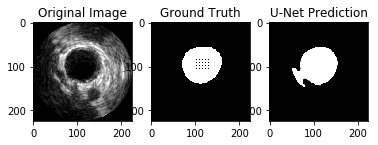





297
The intersection area is 5221
The     union    area is 5860
Calculated Jaccard Measure is 0.8909556313993174
DICE Coefficient :  0.9423337243931054


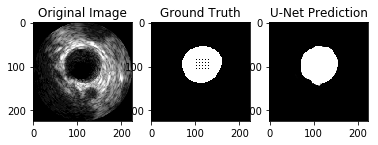





298
The intersection area is 5591
The     union    area is 6231
Calculated Jaccard Measure is 0.8972877547745145
DICE Coefficient :  0.9458636440534597


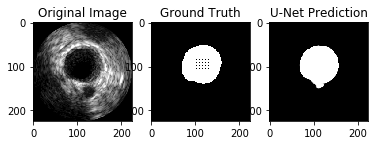





299
The intersection area is 5437
The     union    area is 6263
Calculated Jaccard Measure is 0.8681143222098036
DICE Coefficient :  0.9294017094017094


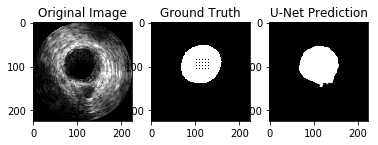





300
The intersection area is 5695
The     union    area is 6345
Calculated Jaccard Measure is 0.8975571315996848
DICE Coefficient :  0.9460132890365448


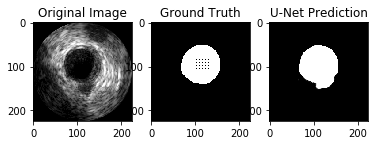





301
The intersection area is 5904
The     union    area is 6436
Calculated Jaccard Measure is 0.9173399627097576
DICE Coefficient :  0.9568881685575364


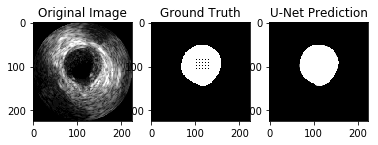





302
The intersection area is 5861
The     union    area is 6721
Calculated Jaccard Measure is 0.872042850766255
DICE Coefficient :  0.931648386584009


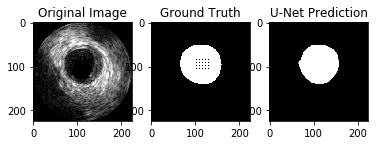





303
The intersection area is 5872
The     union    area is 6642
Calculated Jaccard Measure is 0.8840710629328515
DICE Coefficient :  0.9384689148154067


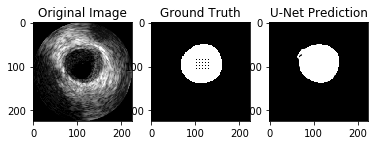





304
The intersection area is 5614
The     union    area is 6308
Calculated Jaccard Measure is 0.8899809765377299
DICE Coefficient :  0.9417882905552759


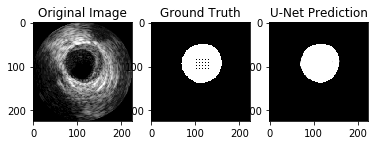





305
The intersection area is 5810
The     union    area is 6451
Calculated Jaccard Measure is 0.9006355603782359
DICE Coefficient :  0.9477204143218334


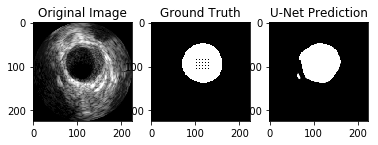





306
The intersection area is 5780
The     union    area is 6396
Calculated Jaccard Measure is 0.9036898061288305
DICE Coefficient :  0.9494086727989488


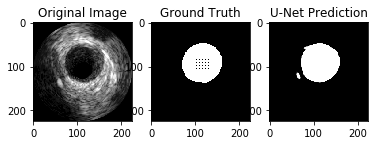





307
The intersection area is 5833
The     union    area is 6445
Calculated Jaccard Measure is 0.9050426687354538
DICE Coefficient :  0.950154748330347


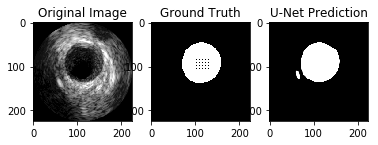





308
The intersection area is 5856
The     union    area is 6439
Calculated Jaccard Measure is 0.9094579903711757
DICE Coefficient :  0.9525823505490036


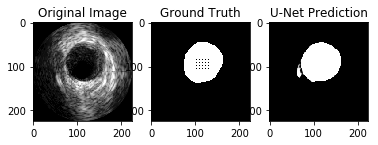





309
The intersection area is 5902
The     union    area is 6383
Calculated Jaccard Measure is 0.924643584521385
DICE Coefficient :  0.9608465608465608


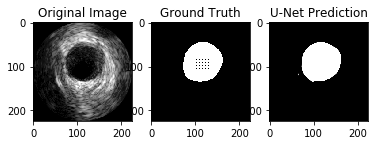





310
The intersection area is 5699
The     union    area is 6181
Calculated Jaccard Measure is 0.9220190907620126
DICE Coefficient :  0.9594276094276094


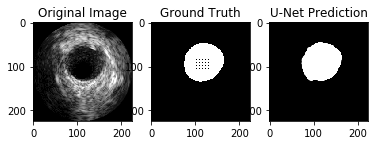





311
The intersection area is 5698
The     union    area is 6688
Calculated Jaccard Measure is 0.8519736842105263
DICE Coefficient :  0.9200710479573713


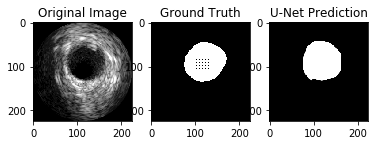





312
The intersection area is 5886
The     union    area is 7089
Calculated Jaccard Measure is 0.830300465509945
DICE Coefficient :  0.9072832369942196


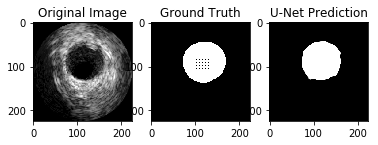





313
The intersection area is 5851
The     union    area is 6957
Calculated Jaccard Measure is 0.8410234296392123
DICE Coefficient :  0.9136477201748907


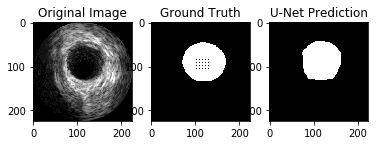





314
The intersection area is 5651
The     union    area is 6747
Calculated Jaccard Measure is 0.8375574329331554
DICE Coefficient :  0.9115986449427327


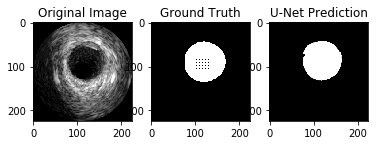





315
The intersection area is 5839
The     union    area is 6980
Calculated Jaccard Measure is 0.8365329512893983
DICE Coefficient :  0.9109914969966456


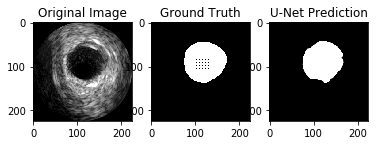





316
The intersection area is 5448
The     union    area is 6737
Calculated Jaccard Measure is 0.8086685468309337
DICE Coefficient :  0.8942141977841609


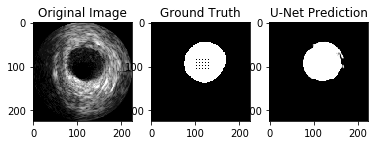





317
The intersection area is 5564
The     union    area is 6636
Calculated Jaccard Measure is 0.838456901748041
DICE Coefficient :  0.9121311475409836


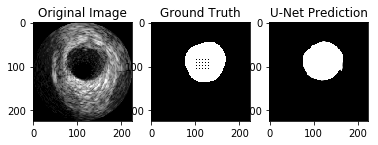





318
The intersection area is 5686
The     union    area is 6615
Calculated Jaccard Measure is 0.8595616024187452
DICE Coefficient :  0.9244776847410779


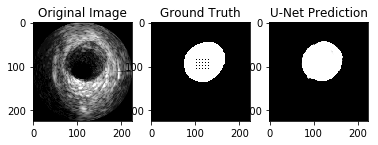





319
The intersection area is 5588
The     union    area is 6530
Calculated Jaccard Measure is 0.8557427258805513
DICE Coefficient :  0.9222644000660175


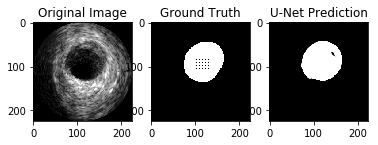





320
The intersection area is 5662
The     union    area is 6739
Calculated Jaccard Measure is 0.8401840035613592
DICE Coefficient :  0.9131521651479719


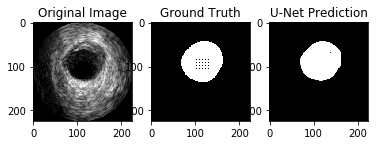





321
The intersection area is 5209
The     union    area is 7181
Calculated Jaccard Measure is 0.7253864364294667
DICE Coefficient :  0.8408393866020984


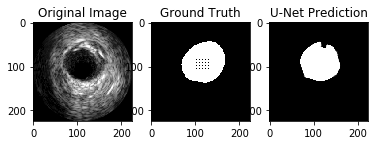





322
The intersection area is 4438
The     union    area is 7330
Calculated Jaccard Measure is 0.6054570259208731
DICE Coefficient :  0.7542488103331068


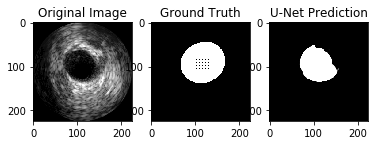





323
The intersection area is 4364
The     union    area is 7288
Calculated Jaccard Measure is 0.5987925356750823
DICE Coefficient :  0.7490559560590456


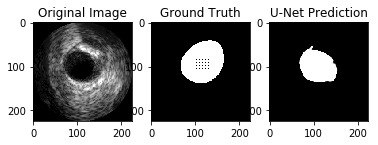





324
The intersection area is 4185
The     union    area is 7627
Calculated Jaccard Measure is 0.5487085354661072
DICE Coefficient :  0.7086014222824246


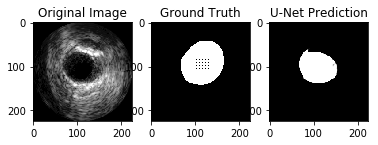





325
The intersection area is 4696
The     union    area is 7704
Calculated Jaccard Measure is 0.6095534787123572
DICE Coefficient :  0.7574193548387097


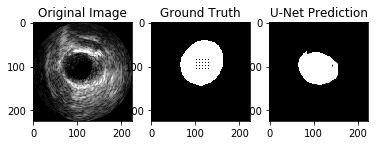



Average Jaccard 0.8085851803525229


In [22]:
count = 0
avgJacc = 0

for pred,gt,test_img in zip(unet_preds4, all_test_media_labels, all_test_data):
    pred = pred[:,:,0]
    test_img = test_img[:,:,0]
    gt = gt[:,:,0]
    print("\n======================================================================\n")
    print(count)
    count += 1
    plt.subplot(1,3,1)
    plt.imshow(test_img, cmap='gray')
    plt.title("Original Image")
    
    plt.subplot(1,3,2)
    plt.imshow(gt, cmap='gray')
    plt.title("Ground Truth")
    
    plt.subplot(1,3,3)
    plt.imshow(pred, cmap='gray')
    plt.title("U-Net Prediction")
    avgJacc = avgJacc + Jaccard(pred.astype(np.uint8), gt.astype(np.uint8))
    g = gt.astype(np.uint8)
    p = pred.astype(np.uint8)
    print("DICE Coefficient : ", (2*np.sum(g * p)/(np.sum(p)+np.sum(g))))    
            
    plt.show()
    print("\n======================================================================\n")

    
print("Average Jaccard {0}".format(avgJacc/326))